# Initial exploration of self-collected EEG data while relaxing
features are canonical frequency bands. converting the raw brain data into the frequencies taht are most present is a way of seeing signals more clearly. This is what I think of when I hear the term "brain wave". The brain communicates along certain frequencies and the frequency bands I've estimated here are the most commonly used ones

## Frequency bands
* **delta**: <4hz
* **theta**: 4-8hz
* **alpha**: 8-12hz
* **beta**: 12-30hz
* **gamma**: >30hz

I'm most interested in delta,alpha, and maybe gamma bands for something that could be interesting because I think they can be modulated most by relaxation/meditation

In [1]:
import os
import sys
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
ls

initial_exploration.ipynb  test_raw.feather        trial_raw.feather
test_features.feather      trial_features.feather


### Parameters

In [3]:
FP_FEATS = os.path.join('data','trial_features.feather')
FP_RAW = os.path.join('data','trial_raw.feather')

### Preconditions

In [4]:
assert os.path.exists(FP_FEATS)
assert os.path.exists(FP_RAW)

In [5]:
features = pd.read_feather('trial_features.feather')
raw = pd.read_feather('trial_raw.feather')

In [6]:
raw.head()

,TP9,AF7,AF8,TP10,time
0,0.0,0.0,0.0,0.0,0.000000
1,0.0,0.0,0.0,0.0,0.003906
2,0.0,0.0,0.0,0.0,0.007812
3,0.0,0.0,0.0,0.0,0.011719
4,0.0,0.0,0.0,0.0,0.015625


plot of raw EEG data. Its really messy!

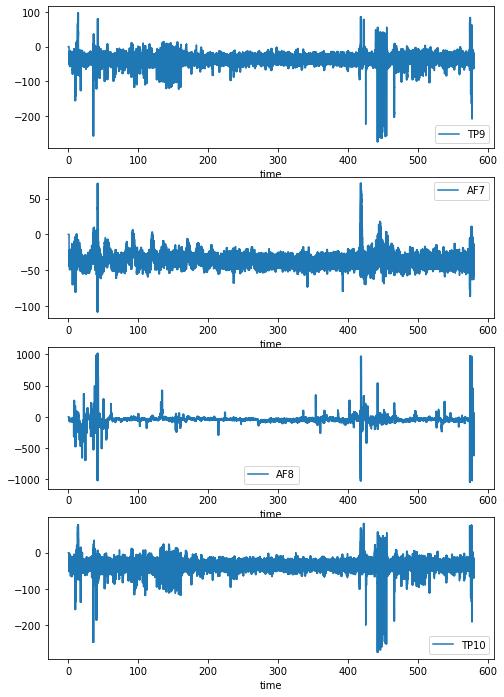

In [7]:
channel_names = raw.columns[:-1]
plt.figure(figsize=[8,12])
for i,channel in enumerate(channel_names):
    ax = plt.subplot(len(channel_names),1,i+1)
    raw.plot(x='time',y=channel,ax=ax)


In [8]:
features.head()

,delta,theta,alpha,beta,gamma,time
0,19.208232,3.938665,1.413286,-3.534432,-11.051625,2020-07-28 22:49:34.581602
1,8.970656,5.798792,2.447447,-1.784186,-9.543199,2020-07-28 22:49:35.679496
2,10.654742,6.176210,4.564050,-1.304563,-9.772807,2020-07-28 22:49:36.774790
3,26.178426,15.790730,9.326611,0.148634,-9.403041,2020-07-28 22:49:37.849113
4,32.121380,19.381826,10.541439,2.009478,-9.761508,2020-07-28 22:49:38.947959


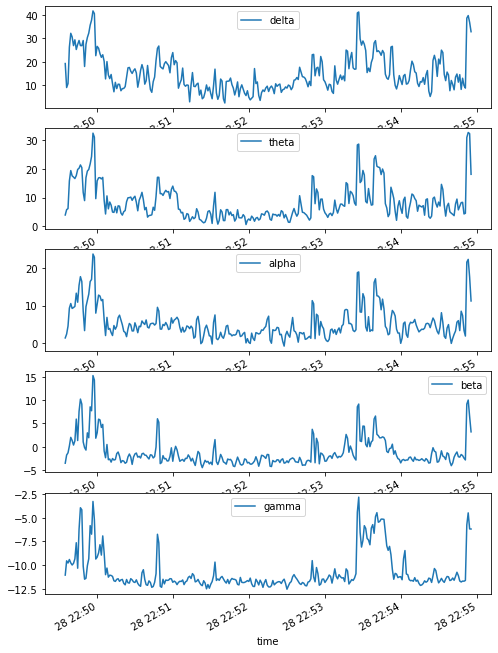

In [9]:
freq_bands = features.columns[:-1]
plt.figure(figsize=[8,12])
for i,f_band in enumerate(freq_bands):
    ax = plt.subplot(len(freq_bands),1,i+1)
    features.plot(x='time',y=f_band,ax=ax)

The features look much cleaner! theyre highly correlated where motion/muscle artifacts are the biggest signal

# Play back above trial 
The `playback_episode()` generator function returns the next packet of data eaach time it is called. This makes it convenient to use in a for loop as shown below. The data is returned in the same format it is collected. The contents of the below for loop are only to demonstrate how to access the data in each datapoint. 

In [10]:
import sys
import os
sys.path.append(os.path.join(os.path.abspath(''),"..","lib"))
from data_generator import playback_episode

In [11]:
for datapoint in playback_episode():
    print(f'time of recorded data is {datapoint.time}')
    print(f'Delta band power is {datapoint.delta}')
    print(f'Theta band power is {datapoint.theta}')
    print(f'alpha band power is {datapoint.alpha}')    
    print(f'Beta band power is {datapoint.beta}')    
    print(f'Gamma band power is {datapoint.gamma}\n')    
    

time of recorded data is 2020-07-28 22:49:34.581602
Delta band power is 19.20823220262382
Theta band power is 3.93866452816387
alpha band power is 1.4132862208316446
Beta band power is -3.5344315309267276
Gamma band power is -11.051625097308575

time of recorded data is 2020-07-28 22:49:35.679496
Delta band power is 8.970655776679115
Theta band power is 5.798792109814115
alpha band power is 2.4474472374838525
Beta band power is -1.784185535015651
Gamma band power is -9.543199009576682

time of recorded data is 2020-07-28 22:49:36.774790
Delta band power is 10.654742204697259
Theta band power is 6.176209953930077
alpha band power is 4.5640503714040825
Beta band power is -1.3045628186060743
Gamma band power is -9.77280744086552

time of recorded data is 2020-07-28 22:49:37.849113
Delta band power is 26.178426005450184
Theta band power is 15.790730434572788
alpha band power is 9.326610808866171
Beta band power is 0.1486338411934281
Gamma band power is -9.403040808986368

time of recorded 

## Play back a different episode
The `playback_episode()` generator function can take an episode dataframe as input and play that one back. The features in the file `data/trial_features.feather` are the default that were played above. Here is an example of playing back a different episode, one called `test_features.feather`

In [12]:
# define file path to the other saved episode's features
FP_TEST_FEATS = 'test_features.feather'

# make sure the file exists
assert os.path.isfile(FP_TEST_FEATS)

In [13]:
# load dataframe of test episode
test = pd.read_feather(FP_TEST_FEATS)

In [14]:
for datapoint in playback_episode(episode=test):
    print(f'time of recorded data is {datapoint.time}')
    print(f'Delta band power is {datapoint.delta}')
    print(f'Theta band power is {datapoint.theta}')
    print(f'alpha band power is {datapoint.alpha}')    
    print(f'Beta band power is {datapoint.beta}')    
    print(f'Gamma band power is {datapoint.gamma}\n')    

time of recorded data is 2020-07-28 23:09:34.776827
Delta band power is 19.137114002782653
Theta band power is 8.518724366769895
alpha band power is 2.1742960770513617
Beta band power is -3.345427103408393
Gamma band power is -5.942248513573267

time of recorded data is 2020-07-28 23:09:35.875291
Delta band power is 13.790295206330399
Theta band power is 11.616698925153353
alpha band power is 6.27981012518034
Beta band power is -0.7745245835195571
Gamma band power is -3.388762620557852

time of recorded data is 2020-07-28 23:09:36.959769
Delta band power is 13.38482050665515
Theta band power is 8.539771570855807
alpha band power is 4.601986061506988
Beta band power is -1.2002886703899616
Gamma band power is -3.4085959279157207

time of recorded data is 2020-07-28 23:09:38.048191
Delta band power is 11.8319522970272
Theta band power is 8.225252619835501
alpha band power is 2.3761104299240046
Beta band power is -1.6446395249359622
Gamma band power is -3.385380611125984

time of recorded 

## Play back raw EEG
If you want to play around with the raw EEG signal (voltage changes directly measuring brain activity) you can use the same `playback_episode()` generator function with an episode of the raw EEG, as seen below. again, the data is returned in the same format it is collected. The contents of the below for loop are only to demonstrate how to access the data in each datapoint. 

In [15]:
# define file path to the other saved episode's features
FP_TRIAL_RAW = 'trial_raw.feather'

# make sure the file exists
assert os.path.isfile(FP_TRIAL_RAW)

In [17]:
# load dataframe of test episode
trial_eeg = pd.read_feather(FP_TRIAL_RAW)

WARNING: playing back the raw EEG is a lot of data! look at the size of the whole dataframe

In [32]:
trial_eeg.size

742400

In [34]:
for datapoint in playback_episode(episode=trial_eeg):
    print(f'time of recorded data is {datapoint.time} seconds since begin')
    channels = datapoint.drop("time").index.values
    print(f'Recorded channel labels are {channels}')
    for channel in channels:
        print(f'channel {channel} is {datapoint[channel]}')
    print('\n')

time of recorded data is 0.0 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.01953125 seconds since begin
Reco

time of recorded data is 0.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.69140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 0.0
channel AF7 is 0.0
channel AF8 is 0.0
channel TP10 is 0.0


time of recorded data is 0.70703125 seconds since begin
R

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.05616060854139
channel AF7 is -31.12908776556629
channel AF8 is -57.409230178906725
channel TP10 is -31.40009809821063


time of recorded data is 1.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.035286173718973
channel AF7 is -28.26862077146879
channel AF8 is -56.03015980292504
channel TP10 is -34.11622794905388


time of recorded data is 1.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.49656857773057
channel AF7 is -24.72230007406156
channel AF8 is -56.67228822944014
channel TP10 is -31.517507360827725


time of recorded data is 1.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.390308693693626
channel AF7 is -21.669224653793478
channel AF8 is -56.62050229727841
channel TP10 is -38.385851976862035


time of recorded data is 1.4609375 seconds since beg

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.474942023735853
channel AF7 is -27.07285538866142
channel AF8 is -62.5550862943504
channel TP10 is -26.1288150957838


time of recorded data is 2.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.721210574537697
channel AF7 is -28.88873936266135
channel AF8 is -69.45875508924411
channel TP10 is -41.14949966649272


time of recorded data is 2.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.36356740580049
channel AF7 is -29.771152617417442
channel AF8 is -68.31228492012488
channel TP10 is -52.40059304512747


time of recorded data is 2.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.851798981168272
channel AF7 is -29.703952796740747
channel AF8 is -68.81731728334432
channel TP10 is -45.163052367863656


time of recorded data is 2.21875 seconds since begin


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.75330916105204
channel AF7 is -33.38498040441809
channel AF8 is -65.93966685355983
channel TP10 is -50.35266785354523


time of recorded data is 2.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.64466311000315
channel AF7 is -28.043795997682306
channel AF8 is -71.75693302447966
channel TP10 is -64.74678853159949


time of recorded data is 2.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.019327476248264
channel AF7 is -26.235192570787444
channel AF8 is -69.91765601529374
channel TP10 is -59.28802341211291


time of recorded data is 2.99609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.86147619616288
channel AF7 is -29.135255752909977
channel AF8 is -67.55889394744787
channel TP10 is -45.307531870831475


time of recorded data is 3.0 seconds since begin
Rec

channel TP9 is -15.627020873482186
channel AF7 is -31.49087270587376
channel AF8 is -72.20151250204137
channel TP10 is -31.48131829529799


time of recorded data is 3.73046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.46276268306512
channel AF7 is -33.491639061692354
channel AF8 is -70.6984634367609
channel TP10 is -29.704318047119866


time of recorded data is 3.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.591659558092292
channel AF7 is -29.182585991383544
channel AF8 is -71.18172975088046
channel TP10 is -30.343727821893903


time of recorded data is 3.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.34832480469255
channel AF7 is -27.633174995163223
channel AF8 is -68.89253518308183
channel TP10 is -33.095656347354335


time of recorded data is 3.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP1

channel AF8 is -47.631112042248816
channel TP10 is -20.173610978879637


time of recorded data is 4.4609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.207492451693845
channel AF7 is -39.33712567937599
channel AF8 is -51.10766413055256
channel TP10 is -30.838659175601762


time of recorded data is 4.46484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.900122400496336
channel AF7 is -38.103391265894004
channel AF8 is -53.34759267578231
channel TP10 is -39.10305767512352


time of recorded data is 4.46875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.4664964012872
channel AF7 is -34.00660334667169
channel AF8 is -54.28747703757152
channel TP10 is -36.781281679841484


time of recorded data is 4.47265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.59780841698913
channel AF7 is -38.3042115231706

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.82372441745687
channel AF7 is -37.680939491953716
channel AF8 is -45.23987366438506
channel TP10 is -32.48140143625278


time of recorded data is 5.25 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.556635785221616
channel AF7 is -35.20239947308747
channel AF8 is -48.67047850654636
channel TP10 is -29.20195902011514


time of recorded data is 5.25390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.22113963500286
channel AF7 is -38.75673769622048
channel AF8 is -49.12255367370729
channel TP10 is -25.10247069214305


time of recorded data is 5.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.26760876019361
channel AF7 is -43.73291918882643
channel AF8 is -49.580843873543216
channel TP10 is -35.19531109570339


time of recorded data is 5.26171875 seconds since begin
Reco

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.194591066320235
channel AF7 is -38.950868813055926
channel AF8 is -57.358014555085155
channel TP10 is -43.138455834211825


time of recorded data is 6.05078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.48776593442793
channel AF7 is -35.013151774272316
channel AF8 is -55.20496620520039
channel TP10 is -35.16612372593724


time of recorded data is 6.0546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.337665140003324
channel AF7 is -37.20784078893524
channel AF8 is -54.42524376025342
channel TP10 is -33.482055364462795


time of recorded data is 6.05859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.22040355864176
channel AF7 is -41.103310234222064
channel AF8 is -51.714409819594614
channel TP10 is -35.38016927579763


time of recorded data is 6.0625 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.608593117237064
channel AF7 is -32.70497703096454
channel AF8 is -39.508074375442725
channel TP10 is -60.13720871170354


time of recorded data is 6.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.56305052473327
channel AF7 is -41.25550867330883
channel AF8 is -38.62058548927083
channel TP10 is -54.75628079056867


time of recorded data is 6.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.505567750638576
channel AF7 is -40.014656016173404
channel AF8 is -33.1283860990295
channel TP10 is -41.23591711393752


time of recorded data is 6.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.59931343077714
channel AF7 is -36.83763965027831
channel AF8 is -25.22593694594822
channel TP10 is -29.50350053494179


time of recorded data is 6.9140625 seconds since begin
R

time of recorded data is 7.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -10.700806247579916
channel AF7 is -11.361125703261301
channel AF8 is 123.18917246997223
channel TP10 is -33.20819985970082


time of recorded data is 7.71875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -11.168147732288862
channel AF7 is -10.14288939919836
channel AF8 is 132.52519240089634
channel TP10 is -36.90049261983902


time of recorded data is 7.72265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.522070849503411
channel AF7 is -10.0895757779127
channel AF8 is 137.60774868409078
channel TP10 is -26.91495092666853


time of recorded data is 7.7265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.7770281758191
channel AF7 is -9.678455383851796
channel AF8 is 140.4878710559642
channel TP10 is -33.83686861857646


tim

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.35487746518406
channel AF7 is -41.56056255854885
channel AF8 is -228.47858672067582
channel TP10 is -31.245458808660363


time of recorded data is 8.53515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.998702459951666
channel AF7 is -42.88541757674062
channel AF8 is -210.62188471389615
channel TP10 is -34.463213077131265


time of recorded data is 8.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.02912263291269
channel AF7 is -42.84790701734678
channel AF8 is -189.15315764611665
channel TP10 is -33.739668979269055


time of recorded data is 8.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.39032853760759
channel AF7 is -34.1482595077255
channel AF8 is -166.27274175261556
channel TP10 is -30.62409604557325


time of recorded data is 8.546875 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -145.13059956820123
channel AF7 is -43.28408358865994
channel AF8 is -6.749720879115796
channel TP10 is -152.24549699223235


time of recorded data is 9.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -148.80801114126584
channel AF7 is -35.85878821347296
channel AF8 is -10.597927828339275
channel TP10 is -144.13035107147363


time of recorded data is 9.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -154.27961295704387
channel AF7 is -39.82262281330539
channel AF8 is -15.661076563801377
channel TP10 is -142.44027535417274


time of recorded data is 9.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -155.60890200881164
channel AF7 is -39.73740368703794
channel AF8 is -16.957020214309942
channel TP10 is -148.66589597367943


time of recorded data is 9.37890625 seconds since b

channel TP10 is -111.0773739884246


time of recorded data is 10.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -115.07637391763632
channel AF7 is -28.69901029156672
channel AF8 is 84.43866983678234
channel TP10 is -109.0975881183154


time of recorded data is 10.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -124.36814327090141
channel AF7 is -29.19636009763009
channel AF8 is 66.33255272348282
channel TP10 is -114.5919538576552


time of recorded data is 10.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -130.61389259188357
channel AF7 is -28.172262329147202
channel AF8 is 47.36177342131514
channel TP10 is -120.63017364631068


time of recorded data is 10.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -126.74634815223557
channel AF7 is -27.983571559136237
channel AF8 is 29.24817128562

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.025774084710157
channel AF7 is -19.489294096704686
channel AF8 is -43.061289116803636
channel TP10 is -7.739776660231491


time of recorded data is 11.02734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.426128706275623
channel AF7 is -20.098115575791734
channel AF8 is -43.67013702705509
channel TP10 is -9.854112132203369


time of recorded data is 11.03125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.12021344513347
channel AF7 is -20.94469471090894
channel AF8 is -43.935255128622394
channel TP10 is -14.326616737559581


time of recorded data is 11.03515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.07718044669845
channel AF7 is -25.419464190427966
channel AF8 is -46.87053904172481
channel TP10 is -19.80589983813328


time of recorded data is 11.0390625 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -6.417185303378742
channel AF7 is -34.510344617860056
channel AF8 is -111.73599387353936
channel TP10 is -9.644962603722398


time of recorded data is 11.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -2.7256632509601144
channel AF7 is -33.563009055413985
channel AF8 is -111.09838432607604
channel TP10 is 1.2033369548197435


time of recorded data is 11.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -1.246346406613461
channel AF7 is -31.732526655509073
channel AF8 is -112.74266833076456
channel TP10 is 4.067196681763043


time of recorded data is 11.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -2.2056253579861265
channel AF7 is -33.300429067038266
channel AF8 is -115.34198691458545
channel TP10 is 8.600121812126758


time of recorded data is 11.8515625 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.81626842410794
channel AF7 is -29.54630835740931
channel AF8 is -11.446833154693756
channel TP10 is -55.82242757580997


time of recorded data is 12.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.95469627103812
channel AF7 is -32.602328641577444
channel AF8 is -14.197908827565021
channel TP10 is -50.99608103491899


time of recorded data is 12.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.00487139214909
channel AF7 is -28.215000684462265
channel AF8 is -16.31902116001403
channel TP10 is -49.834704372784486


time of recorded data is 12.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.854897351182856
channel AF7 is -28.36907691076021
channel AF8 is -19.918846859206
channel TP10 is -52.573363401982675


time of recorded data is 12.6875 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.709312338686965
channel AF7 is -15.980662619451028
channel AF8 is -84.85004905530224
channel TP10 is -9.826032566232989


time of recorded data is 13.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -5.489054977872439
channel AF7 is -24.679209964140714
channel AF8 is -64.9697581597482
channel TP10 is -13.404475962136743


time of recorded data is 13.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -3.745758446546665
channel AF7 is -25.438431266602905
channel AF8 is -57.44789809198034
channel TP10 is -17.162583563223286


time of recorded data is 13.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -1.2081642991673573
channel AF7 is -21.865208451097025
channel AF8 is -57.28421602826332
channel TP10 is -20.084034811340445


time of recorded data is 13.50390625 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 60.799793906154896
channel AF7 is -20.862722007715476
channel AF8 is -209.48791462677718
channel TP10 is 42.571086213609135


time of recorded data is 14.31640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 50.905803927818155
channel AF7 is -21.565844378977644
channel AF8 is -197.14458404859752
channel TP10 is 39.71836179022257


time of recorded data is 14.3203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 44.00942818517265
channel AF7 is -20.91430177428567
channel AF8 is -187.19254736184632
channel TP10 is 35.094891101463574


time of recorded data is 14.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 39.98121504775085
channel AF7 is -19.591435236188843
channel AF8 is -170.97313937522742
channel TP10 is 41.89114000865629


time of recorded data is 14.328125 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.97861057788026
channel AF7 is -17.661813687087594
channel AF8 is -80.47924902943407
channel TP10 is -65.23927187840911


time of recorded data is 15.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.757070526639154
channel AF7 is -21.495992029849248
channel AF8 is -84.0489057383252
channel TP10 is -66.95013749905901


time of recorded data is 15.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.93001676219704
channel AF7 is -24.574034478052045
channel AF8 is -78.79655757190022
channel TP10 is -62.56861517089092


time of recorded data is 15.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.2137041422438
channel AF7 is -27.65965676537526
channel AF8 is -80.97524801507765
channel TP10 is -57.72744295834814


time of recorded data is 15.15234375 seconds since beg

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.91336003211565
channel AF7 is -34.45257317051619
channel AF8 is -135.74195510100515
channel TP10 is -41.26923459310251


time of recorded data is 15.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.28168399605859
channel AF7 is -33.90336984615537
channel AF8 is -133.89932729930243
channel TP10 is -43.21887453143974


time of recorded data is 15.953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.02637061935278
channel AF7 is -32.348801623764885
channel AF8 is -138.93723184911795
channel TP10 is -44.0760342324115


time of recorded data is 15.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.44958172020989
channel AF7 is -25.274404733265904
channel AF8 is -141.0390518118159
channel TP10 is -45.92967810698819


time of recorded data is 15.9609375 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.181283283910247
channel AF7 is -37.30499312573828
channel AF8 is -183.17449969332
channel TP10 is -37.86909145915605


time of recorded data is 16.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.43842030694384
channel AF7 is -34.900209053929196
channel AF8 is -171.24794066684717
channel TP10 is -35.969903182357214


time of recorded data is 16.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.909377767328174
channel AF7 is -34.37678241870932
channel AF8 is -168.67628063897885
channel TP10 is -31.822299160787058


time of recorded data is 16.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.88016468497306
channel AF7 is -35.476063745783534
channel AF8 is -170.82632112045613
channel TP10 is -26.28866216072876


time of recorded data is 16.81640625 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.52670265703051
channel AF7 is -38.023031927160076
channel AF8 is -157.68523280505661
channel TP10 is -49.11378067321158


time of recorded data is 17.63671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.475763068144595
channel AF7 is -37.4182643009096
channel AF8 is -154.74778730167924
channel TP10 is -51.81708243622211


time of recorded data is 17.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.054646816059766
channel AF7 is -41.983635328107695
channel AF8 is -155.88617787930053
channel TP10 is -49.583667739465355


time of recorded data is 17.64453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.09358746134391
channel AF7 is -47.81786118394585
channel AF8 is -158.47935814724053
channel TP10 is -47.89359151998369


time of recorded data is 17.6484375 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.30364267620548
channel AF7 is -42.4296128215757
channel AF8 is -164.8758817084563
channel TP10 is -37.20640818662855


time of recorded data is 18.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.457000989912494
channel AF7 is -47.458965834773664
channel AF8 is -164.07589136870263
channel TP10 is -42.575651026020566


time of recorded data is 18.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.61835495152676
channel AF7 is -39.879118469296856
channel AF8 is -158.4204738566401
channel TP10 is -36.499446688378995


time of recorded data is 18.38671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.707500002686764
channel AF7 is -31.71492263897559
channel AF8 is -151.2344855464533
channel TP10 is -34.51233226775939


time of recorded data is 18.390625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.47376642532533
channel AF7 is -34.0823464148344
channel AF8 is -648.1400930544821
channel TP10 is -24.926835793929158


time of recorded data is 19.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.228342961903017
channel AF7 is -33.423698686394914
channel AF8 is -633.2155206343251
channel TP10 is -21.41394371170444


time of recorded data is 19.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.615936801679815
channel AF7 is -31.591672499416013
channel AF8 is -633.3165140403537
channel TP10 is -21.977800577737185


time of recorded data is 19.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.71002579232144
channel AF7 is -31.26571871315669
channel AF8 is -631.730274453598
channel TP10 is -29.402081856730238


time of recorded data is 19.15625 seconds since b

channel AF7 is -45.44604104130441
channel AF8 is -288.53925804204573
channel TP10 is -40.492642701296504


time of recorded data is 19.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.51681056405903
channel AF7 is -47.379123637814956
channel AF8 is -285.7092166419212
channel TP10 is -40.23699113517186


time of recorded data is 19.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.23302166508233
channel AF7 is -52.34032874695972
channel AF8 is -288.15482792783484
channel TP10 is -42.62132071365454


time of recorded data is 19.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -53.433695883377204
channel AF7 is -50.935103180110524
channel AF8 is -288.2044931815294
channel TP10 is -54.65772176831163


time of recorded data is 19.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.607017101

channel TP10 is -33.75697623586456


time of recorded data is 20.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.8315639977951
channel AF7 is -42.915789583814046
channel AF8 is -294.14687540060527
channel TP10 is -31.99755282469232


time of recorded data is 20.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.1427108932879
channel AF7 is -40.49741717503166
channel AF8 is -297.75323541900866
channel TP10 is -24.999067411630413


time of recorded data is 20.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.89688085349698
channel AF7 is -44.93138513482441
channel AF8 is -304.5641978941597
channel TP10 is -29.105263563414397


time of recorded data is 20.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.47008170158872
channel AF7 is -46.64442957400556
channel AF8 is -304.667953583389

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.77293139915212
channel AF7 is -34.924780984249466
channel AF8 is -78.75481016067103
channel TP10 is -25.76749760897338


time of recorded data is 21.6484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.205759600727497
channel AF7 is -38.61666304408086
channel AF8 is -57.59999259206222
channel TP10 is -28.747822084676574


time of recorded data is 21.65234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.291313667245966
channel AF7 is -40.23591876993622
channel AF8 is -43.1624451704439
channel TP10 is -28.193866442803277


time of recorded data is 21.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.553180417441666
channel AF7 is -37.43443770276038
channel AF8 is -24.096417369610908
channel TP10 is -24.21015992840186


time of recorded data is 21.66015625 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.17411624279979
channel AF7 is -39.68755597061937
channel AF8 is -190.45484209423734
channel TP10 is -31.709375342273404


time of recorded data is 22.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.2853413086768
channel AF7 is -42.00218176535366
channel AF8 is -188.87023922957297
channel TP10 is -21.22648082403922


time of recorded data is 22.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.71152946366892
channel AF7 is -42.763042879042985
channel AF8 is -184.08304775213296
channel TP10 is -19.275599500644276


time of recorded data is 22.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.970009993226626
channel AF7 is -46.085768416439535
channel AF8 is -188.03264268923056
channel TP10 is -29.776746531805816


time of recorded data is 22.43359375 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.131914456982862
channel AF7 is -44.8091143748278
channel AF8 is -200.1761289256312
channel TP10 is -26.7569056944867


time of recorded data is 23.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.140741681383993
channel AF7 is -37.23233182028211
channel AF8 is -198.56787278780138
channel TP10 is -24.870317223415654


time of recorded data is 23.10546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.100239851893907
channel AF7 is -36.22381407856311
channel AF8 is -197.9293063786895
channel TP10 is -23.90587013940165


time of recorded data is 23.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.534031164113156
channel AF7 is -39.885705964669384
channel AF8 is -200.47283098671352
channel TP10 is -28.528314978920267


time of recorded data is 23.11328125 seconds sinc

time of recorded data is 23.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.7877532291829
channel AF7 is -44.679513552103074
channel AF8 is -167.2448487875107
channel TP10 is -48.49880872783335


time of recorded data is 23.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.62857997705761
channel AF7 is -45.79857690491557
channel AF8 is -162.11363445486126
channel TP10 is -43.476302865964485


time of recorded data is 23.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.915778171630066
channel AF7 is -47.86956237107378
channel AF8 is -160.5181145922105
channel TP10 is -43.591553778556346


time of recorded data is 23.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.69501285511814
channel AF7 is -46.56905802513257
channel AF8 is -175.45617633879436
channel TP10 is -42.37720624984

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.18304304246598
channel AF7 is -42.771380355971345
channel AF8 is -46.82720485909691
channel TP10 is -44.97240805248382


time of recorded data is 24.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.09087242408388
channel AF7 is -45.32239773589323
channel AF8 is -63.830141043063904
channel TP10 is -49.21727208337474


time of recorded data is 24.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.426992010185884
channel AF7 is -47.14478065910117
channel AF8 is -74.80707275698197
channel TP10 is -47.1144819767395


time of recorded data is 24.53125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.65624691679041
channel AF7 is -42.25045091319157
channel AF8 is -93.60888779953191
channel TP10 is -45.922220405632636


time of recorded data is 24.53515625 seconds since beg

time of recorded data is 25.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.134178542936795
channel AF7 is -35.56845907398783
channel AF8 is -192.98701607384317
channel TP10 is -46.33220169751272


time of recorded data is 25.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.029186335070804
channel AF7 is -38.62143471215251
channel AF8 is -202.89504283632053
channel TP10 is -44.123904719714005


time of recorded data is 25.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.11463555323548
channel AF7 is -43.17001630903985
channel AF8 is -206.79226131166632
channel TP10 is -52.13461101313935


time of recorded data is 25.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.59937735027891
channel AF7 is -39.00164891504489
channel AF8 is -211.97339566615165
channel TP10 is -48.889789232161

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.54421432889345
channel AF7 is -40.84123213895364
channel AF8 is -115.91273356418911
channel TP10 is -33.54336180091016


time of recorded data is 26.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.561475837722256
channel AF7 is -42.69312143825495
channel AF8 is -125.04228275707953
channel TP10 is -36.97042701852939


time of recorded data is 26.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.29601334524965
channel AF7 is -41.796294803526955
channel AF8 is -128.25671524287878
channel TP10 is -33.05704621298105


time of recorded data is 26.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.37783622247289
channel AF7 is -38.34710969206708
channel AF8 is -131.3313275377963
channel TP10 is -32.536388203962424


time of recorded data is 26.21484375 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.153612208519256
channel AF7 is -37.437583659035816
channel AF8 is 128.25946564321674
channel TP10 is -42.73095304180352


time of recorded data is 27.0546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.275843158192515
channel AF7 is -42.13615795103439
channel AF8 is 121.15600997402125
channel TP10 is -47.73220471228414


time of recorded data is 27.05859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.107769285998714
channel AF7 is -45.21165803495413
channel AF8 is 116.56317995320286
channel TP10 is -49.28159123257217


time of recorded data is 27.0625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.4166904351678
channel AF7 is -42.48789318458277
channel AF8 is 123.41668791410915
channel TP10 is -50.7806672761041


time of recorded data is 27.06640625 seconds since begin

channel AF8 is 17.15875018965469
channel TP10 is -35.24206698134819


time of recorded data is 27.8671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.973002381363756
channel AF7 is -31.553791264625925
channel AF8 is 18.4399925371857
channel TP10 is -37.58182834599395


time of recorded data is 27.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.6240694560824
channel AF7 is -26.806222901541815
channel AF8 is 18.098720250069448
channel TP10 is -39.97230448051589


time of recorded data is 27.875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.30324875092877
channel AF7 is -31.596482271487254
channel AF8 is 14.666801970851964
channel TP10 is -41.75305329567771


time of recorded data is 27.87890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.14042502657989
channel AF7 is -35.76801976567401
ch

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.52386257339947
channel AF7 is -35.397023623836425
channel AF8 is 52.695942730556226
channel TP10 is -32.38871973544312


time of recorded data is 28.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.7274268627757
channel AF7 is -39.681470777498205
channel AF8 is 41.956504459910775
channel TP10 is -38.43103099498871


time of recorded data is 28.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.28199961816593
channel AF7 is -42.8965292619977
channel AF8 is 41.62156591746458
channel TP10 is -39.16811053097125


time of recorded data is 28.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.65700908803864
channel AF7 is -36.51075735714734
channel AF8 is 39.082221532607264
channel TP10 is -33.30640167204767


time of recorded data is 28.71484375 seconds since begin


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.844220008649675
channel AF7 is -37.52364845061449
channel AF8 is -17.447818864071593
channel TP10 is -23.22023544805933


time of recorded data is 29.53515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.01384073951752
channel AF7 is -32.18059579011465
channel AF8 is -19.231484497862724
channel TP10 is -25.372197699442317


time of recorded data is 29.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.027757421468834
channel AF7 is -29.37649848819168
channel AF8 is -12.410677058075677
channel TP10 is -26.60772278079334


time of recorded data is 29.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.60655183776516
channel AF7 is -35.24976580978828
channel AF8 is -15.857143960605903
channel TP10 is -29.800971781196054


time of recorded data is 29.546875 seconds sin

time of recorded data is 30.36328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.85022718520529
channel AF7 is -37.53581796990627
channel AF8 is -2.3342736310046592
channel TP10 is -31.61450136689767


time of recorded data is 30.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.577508635488723
channel AF7 is -36.01339213216775
channel AF8 is -4.2266972104706415
channel TP10 is -31.87802855184743


time of recorded data is 30.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.818213823869186
channel AF7 is -38.42138960725805
channel AF8 is -5.391986847772794
channel TP10 is -29.723327404364476


time of recorded data is 30.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.31232135592282
channel AF7 is -35.11163297604116
channel AF8 is -0.012157062760138615
channel TP10 is -28.31212263115

channel AF7 is -34.19841444076047
channel AF8 is -10.717065146187817
channel TP10 is -25.27701663841163


time of recorded data is 31.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.998693527366033
channel AF7 is -35.40853218424945
channel AF8 is -7.924771811604877
channel TP10 is -23.911828345429726


time of recorded data is 31.21875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.76248888649427
channel AF7 is -36.505876814945026
channel AF8 is -7.797639068435141
channel TP10 is -19.447073648464357


time of recorded data is 31.22265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.296423828270754
channel AF7 is -34.07828704509705
channel AF8 is -12.920037200688787
channel TP10 is -23.931015152984227


time of recorded data is 31.2265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.8808846

time of recorded data is 32.046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.007864629866663
channel AF7 is -31.653019930680127
channel AF8 is 13.892531452359705
channel TP10 is -25.310077772242764


time of recorded data is 32.05078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.720406019750794
channel AF7 is -35.09583831721598
channel AF8 is 14.66245316093588
channel TP10 is -30.43124200601096


time of recorded data is 32.0546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.70633060069935
channel AF7 is -31.106734105916015
channel AF8 is 12.242425041180548
channel TP10 is -33.603044230350314


time of recorded data is 32.05859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.714845821224895
channel AF7 is -32.3333555121709
channel AF8 is 5.807539663574127
channel TP10 is -29.902113530140

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.73333054592586
channel AF7 is -36.27569753743839
channel AF8 is 204.79074339480374
channel TP10 is -31.865400822791784


time of recorded data is 32.8984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.059763419153946
channel AF7 is -33.66420685812891
channel AF8 is 202.5180556216938
channel TP10 is -26.231862479934797


time of recorded data is 32.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.199578606367506
channel AF7 is -29.52800208116304
channel AF8 is 203.0949515379969
channel TP10 is -24.7942694845223


time of recorded data is 32.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.21838405435534
channel AF7 is -26.712773036354726
channel AF8 is 197.8447770920568
channel TP10 is -25.676074172674973


time of recorded data is 32.91015625 seconds since begi

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.84175484583815
channel AF7 is -27.648062532945445
channel AF8 is 110.13502898135111
channel TP10 is -37.381781598363034


time of recorded data is 33.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.97110781127939
channel AF7 is -25.45779882040417
channel AF8 is 110.72545876806483
channel TP10 is -35.78738925145112


time of recorded data is 33.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.38139462513035
channel AF7 is -23.37797257261387
channel AF8 is 112.19520903073536
channel TP10 is -33.97127797553


time of recorded data is 33.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.451603511359224
channel AF7 is -24.502666358508545
channel AF8 is 107.88645350541618
channel TP10 is -36.447142524648534


time of recorded data is 33.75390625 seconds since begin
R

channel AF7 is -31.329941275996944
channel AF8 is 128.98766997957088
channel TP10 is -30.07057068552811


time of recorded data is 34.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.48164925115925
channel AF7 is -28.485483706131784
channel AF8 is 123.5001023284726
channel TP10 is -41.37881323766669


time of recorded data is 34.58984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.946721899715726
channel AF7 is -25.56424752277018
channel AF8 is 125.34677963398656
channel TP10 is -38.48147664689193


time of recorded data is 34.59375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.18776492801031
channel AF7 is -22.42038778396723
channel AF8 is 125.18955630039665
channel TP10 is -35.593385693727335


time of recorded data is 34.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.419089786609

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -72.97033955942926
channel AF7 is -6.666470351679122
channel AF8 is -516.5228362692429
channel TP10 is -78.69016090420722


time of recorded data is 35.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -77.29180192406898
channel AF7 is -10.476401850478748
channel AF8 is -504.7610001323969
channel TP10 is -77.58249759802246


time of recorded data is 35.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -74.18362285680459
channel AF7 is -7.102334993455796
channel AF8 is -488.4368704679643
channel TP10 is -77.0029927518214


time of recorded data is 35.4140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -63.80196109808834
channel AF7 is -6.077296044403451
channel AF8 is -473.2116040257773
channel TP10 is -67.86869850057062


time of recorded data is 35.41796875 seconds since begin


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -90.31652804597582
channel AF7 is -7.380237683220499
channel AF8 is -460.2036216041122
channel TP10 is -103.0931205909092


time of recorded data is 36.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -90.88039538435068
channel AF7 is -8.186963311800868
channel AF8 is -487.85610879415776
channel TP10 is -93.65360491333891


time of recorded data is 36.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -92.55531040191035
channel AF7 is -8.965061734334519
channel AF8 is -508.1502107276958
channel TP10 is -94.66553804576984


time of recorded data is 36.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -90.29304852670347
channel AF7 is -12.44787100358338
channel AF8 is -520.0298239073354
channel TP10 is -87.82856248148818


time of recorded data is 36.25 seconds since begin
Re

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.73732947775778
channel AF7 is -10.951450657951003
channel AF8 is 100.3608798296666
channel TP10 is -32.55465443396474


time of recorded data is 37.0625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.34545171196768
channel AF7 is -13.877565433210684
channel AF8 is 94.95056251475111
channel TP10 is -29.024728920377775


time of recorded data is 37.06640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.587901022330556
channel AF7 is -11.472265039316047
channel AF8 is 93.85521738555008
channel TP10 is -33.361765053229206


time of recorded data is 37.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.22617166285971
channel AF7 is -10.483240678808226
channel AF8 is 99.1502389873217
channel TP10 is -30.898167552381807


time of recorded data is 37.07421875 seconds since begi

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.765525267162808
channel AF7 is -29.98682531551025
channel AF8 is -1.4573437173822594
channel TP10 is -31.725001700672152


time of recorded data is 37.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.096610192785583
channel AF7 is -32.95684089438552
channel AF8 is 8.61965399167416
channel TP10 is -23.392903842132768


time of recorded data is 37.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.21677492058273
channel AF7 is -35.82003833062275
channel AF8 is 19.32360872726252
channel TP10 is -14.619688613179553


time of recorded data is 37.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.999980260780738
channel AF7 is -33.90614614807407
channel AF8 is 11.258737684629866
channel TP10 is -16.208082470115354


time of recorded data is 37.91796875 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.76137389568835
channel AF7 is -37.615977529647424
channel AF8 is -58.180490690385824
channel TP10 is -39.29634737696799


time of recorded data is 38.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.267004832496895
channel AF7 is -34.096446501875086
channel AF8 is -47.41770530491544
channel TP10 is -38.01414248389305


time of recorded data is 38.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.505022453301457
channel AF7 is -27.366891784058254
channel AF8 is -41.31747773599507
channel TP10 is -27.293296730101076


time of recorded data is 38.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.184690065690774
channel AF7 is -27.557745080889408
channel AF8 is -33.260170306732476
channel TP10 is -29.474688597679847


time of recorded data is 38.765625 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -110.10981709174791
channel AF7 is -34.577998324747
channel AF8 is 409.1305314101436
channel TP10 is -105.66052684703193


time of recorded data is 39.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -104.52811021035012
channel AF7 is -29.49261207728286
channel AF8 is 478.42829794189
channel TP10 is -104.36821326730532


time of recorded data is 39.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -101.07500555437596
channel AF7 is -21.918684897189443
channel AF8 is 569.6984320528006
channel TP10 is -99.29525950248734


time of recorded data is 39.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -100.67187479352002
channel AF7 is -13.9930033505481
channel AF8 is 665.6901398722205
channel TP10 is -100.58737026924354


time of recorded data is 39.62109375 seconds since begin


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -87.68941160314166
channel AF7 is -33.636276336584075
channel AF8 is -12.491050282658817
channel TP10 is -82.04910352329169


time of recorded data is 40.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -92.72486797798584
channel AF7 is -37.47921641023437
channel AF8 is -8.416846162664202
channel TP10 is -89.41388628567992


time of recorded data is 40.4609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -84.76354443494844
channel AF7 is -32.39012946139422
channel AF8 is -3.4379745429075137
channel TP10 is -85.3992165856438


time of recorded data is 40.46484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -90.36211370622038
channel AF7 is -27.518936330503585
channel AF8 is 1.627736865825353
channel TP10 is -95.74356512420462


time of recorded data is 40.46875 seconds since begi

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.48998282688904
channel AF7 is -97.74569040759879
channel AF8 is -998.3888473085265
channel TP10 is -47.713735107261755


time of recorded data is 41.27734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -63.29532805414086
channel AF7 is -102.18386427438176
channel AF8 is -995.5040019065815
channel TP10 is -59.00725608651628


time of recorded data is 41.28125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -72.74913108711957
channel AF7 is -102.6176436237674
channel AF8 is -999.5141903087363
channel TP10 is -70.06392598035927


time of recorded data is 41.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -78.48617173863488
channel AF7 is -99.40390226315907
channel AF8 is -1004.8508277421
channel TP10 is -70.61353201429489


time of recorded data is 41.2890625 seconds since begin


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.87517546020035
channel AF7 is -100.21938349076632
channel AF8 is -995.9787829362491
channel TP10 is -38.54417907834332


time of recorded data is 42.13671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.95339709163041
channel AF7 is -103.1476076556637
channel AF8 is -1000.677891438886
channel TP10 is -40.1979227239889


time of recorded data is 42.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.87162564499964
channel AF7 is -108.41235363419304
channel AF8 is -1003.3716020455307
channel TP10 is -46.48201018672331


time of recorded data is 42.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.67440831517272
channel AF7 is -105.40877375868052
channel AF8 is -1002.7191112770942
channel TP10 is -41.152833102172494


time of recorded data is 42.1484375 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.85123352297452
channel AF7 is -20.283231591905484
channel AF8 is 132.52661650309375
channel TP10 is -50.927707150279176


time of recorded data is 42.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.40655369030891
channel AF7 is -21.702447509823195
channel AF8 is 122.35428784083841
channel TP10 is -52.17636682460429


time of recorded data is 42.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.51719991899991
channel AF7 is -19.79194473342605
channel AF8 is 118.58087595506483
channel TP10 is -47.050443695776536


time of recorded data is 42.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.821276890484555
channel AF7 is -17.031196546204733
channel AF8 is 117.63139162343413
channel TP10 is -50.70229293060018


time of recorded data is 42.9921875 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -11.057602277231693
channel AF7 is -27.090218575867016
channel AF8 is 37.923584395861
channel TP10 is -14.900368563155647


time of recorded data is 43.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.542389698396303
channel AF7 is -27.301119432978382
channel AF8 is 37.98480417005184
channel TP10 is -15.282580947089622


time of recorded data is 43.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.468959304764219
channel AF7 is -31.07075278521269
channel AF8 is 34.4159336107807
channel TP10 is -13.472784672658578


time of recorded data is 43.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -9.463752992005542
channel AF7 is -34.02485423955825
channel AF8 is 26.859817910898308
channel TP10 is -12.475371821636589


time of recorded data is 43.84375 seconds since beg

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.408739617682585
channel AF7 is -26.486155032910304
channel AF8 is 56.690480981920444
channel TP10 is -19.0592632897447


time of recorded data is 44.63671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.66301156327298
channel AF7 is -29.85633323737647
channel AF8 is 51.38703892180442
channel TP10 is -30.51588024220578


time of recorded data is 44.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.235975873771682
channel AF7 is -28.691473515366464
channel AF8 is 42.26895761626417
channel TP10 is -31.60455348449693


time of recorded data is 44.64453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.03373053475557
channel AF7 is -30.528603564956107
channel AF8 is 39.045829133256376
channel TP10 is -20.209907016857528


time of recorded data is 44.6484375 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.854154055232197
channel AF7 is -47.77915193270927
channel AF8 is -42.22708868299544
channel TP10 is -28.7236609527501


time of recorded data is 45.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.41869605461711
channel AF7 is -45.498729427667016
channel AF8 is -43.26238838271075
channel TP10 is -25.728389138813


time of recorded data is 45.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.472908959167654
channel AF7 is -44.59654547288529
channel AF8 is -42.81067697410252
channel TP10 is -19.7540825256117


time of recorded data is 45.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.90164988847507
channel AF7 is -42.969865336546846
channel AF8 is -41.09733466351101
channel TP10 is -21.48773862682338


time of recorded data is 45.5 seconds since begin
Reco

time of recorded data is 46.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -7.707475549572518
channel AF7 is -34.91972307347567
channel AF8 is -28.95209528960691
channel TP10 is -11.161723209115786


time of recorded data is 46.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.929790078078163
channel AF7 is -35.00953334512613
channel AF8 is -23.626459699324776
channel TP10 is -13.483333736074547


time of recorded data is 46.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.501115794360132
channel AF7 is -29.12638311472589
channel AF8 is -24.814968098754083
channel TP10 is -18.45007464002326


time of recorded data is 46.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.735221601408252
channel AF7 is -27.362686287384317
channel AF8 is -25.08156159175664
channel TP10 is -21.93338843


time of recorded data is 47.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.700187374645495
channel AF7 is -46.232243410465856
channel AF8 is -274.6536233831341
channel TP10 is -35.19439616757809


time of recorded data is 47.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.218649871802356
channel AF7 is -46.8130597246748
channel AF8 is -333.259813386382
channel TP10 is -37.79632756217097


time of recorded data is 47.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.64883626100954
channel AF7 is -44.84809289535337
channel AF8 is -405.4197768779999
channel TP10 is -40.04871787402807


time of recorded data is 47.17578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.46709752345386
channel AF7 is -44.752424858435774
channel AF8 is -452.52890837369165
channel TP10 is -37.498781612778


time of recorded data is 48.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.16731076843268
channel AF7 is -48.576401147065525
channel AF8 is -183.76345652797653
channel TP10 is -44.20093444431028


time of recorded data is 48.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.052449465991046
channel AF7 is -44.363625596849474
channel AF8 is -188.28388241740552
channel TP10 is -37.47729175935585


time of recorded data is 48.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.80610204089355
channel AF7 is -45.453825430622445
channel AF8 is -194.2647636410472
channel TP10 is -31.66312704987223


time of recorded data is 48.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.357060567515006
channel AF7 is -50.094824823957715
channel AF8 is -201.77324598399082
channel TP10 is -29.297649

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.2229324529583
channel AF7 is -45.35158044322736
channel AF8 is -134.58351699638217
channel TP10 is -40.13359609428623


time of recorded data is 48.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.04925332370763
channel AF7 is -48.86520795755389
channel AF8 is -133.022944908128
channel TP10 is -29.69085446117719


time of recorded data is 48.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.37444979767405
channel AF7 is -47.26773747438554
channel AF8 is -136.48988269839603
channel TP10 is -33.014836829046956


time of recorded data is 48.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.42122228248574
channel AF7 is -43.75580598527303
channel AF8 is -138.24906498098778
channel TP10 is -44.22753550319876


time of recorded data is 48.8515625 seconds since begi

channel AF7 is -43.49606538710226
channel AF8 is -188.407262824645
channel TP10 is -23.089108035913917


time of recorded data is 49.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.178289008503672
channel AF7 is -44.411941620313414
channel AF8 is -185.17313555359425
channel TP10 is -22.206123169835465


time of recorded data is 49.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.563437409169804
channel AF7 is -42.46055057321752
channel AF8 is -183.80334173618058
channel TP10 is -20.044043203123742


time of recorded data is 49.69140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.15423428012173
channel AF7 is -46.80975037405962
channel AF8 is -183.0802307424066
channel TP10 is -27.84300736458225


time of recorded data is 49.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.836448990

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.16100701681252
channel AF7 is -44.72492912267689
channel AF8 is -186.4321002443209
channel TP10 is -38.896784516516334


time of recorded data is 50.53515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.967319321153287
channel AF7 is -44.71958983716955
channel AF8 is -187.99710804066632
channel TP10 is -32.70083153464351


time of recorded data is 50.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.180691331279704
channel AF7 is -47.702828271729196
channel AF8 is -190.5892107585516
channel TP10 is -41.29164728657999


time of recorded data is 50.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.9025030793142
channel AF7 is -48.99422401565032
channel AF8 is -191.93843578482927
channel TP10 is -45.20899773105715


time of recorded data is 50.546875 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -76.51913784290778
channel AF7 is -25.343498312863836
channel AF8 is -69.86206041780058
channel TP10 is -76.0994139427223


time of recorded data is 51.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -88.06720305601215
channel AF7 is -26.476976611649
channel AF8 is -69.78492424136397
channel TP10 is -80.41947627948782


time of recorded data is 51.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -91.40582912097538
channel AF7 is -32.468995429949636
channel AF8 is -66.6763598716669
channel TP10 is -83.47538586722467


time of recorded data is 51.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -94.14704944064562
channel AF7 is -28.71868488335139
channel AF8 is -65.37370127142957
channel TP10 is -84.47911176977836


time of recorded data is 51.37890625 seconds since begin
Reco

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.016607540741624
channel AF7 is -21.075397647947813
channel AF8 is -53.45181631036918
channel TP10 is -30.72448150075732


time of recorded data is 52.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.094100001735185
channel AF7 is -18.827458561914028
channel AF8 is -62.53053271799142
channel TP10 is -35.78685663571535


time of recorded data is 52.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.706568807700897
channel AF7 is -18.70648944085095
channel AF8 is -64.8553581293909
channel TP10 is -35.972057908850005


time of recorded data is 52.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.25218489174772
channel AF7 is -21.42232185882991
channel AF8 is -63.472991348036224
channel TP10 is -37.19964721356198


time of recorded data is 52.203125 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.86338895377262
channel AF7 is -12.514082423791228
channel AF8 is -123.80386429517492
channel TP10 is -33.408074145716775


time of recorded data is 53.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.27584231988075
channel AF7 is -13.271917066775753
channel AF8 is -124.0908402202798
channel TP10 is -43.891885590883206


time of recorded data is 53.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.928768226267188
channel AF7 is -15.747255386638434
channel AF8 is -120.28618386342973
channel TP10 is -39.18437395666835


time of recorded data is 53.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.031195629992958
channel AF7 is -16.97844997621359
channel AF8 is -124.73456237101293
channel TP10 is -37.31964881465665


time of recorded data is 53.015625 seconds s

time of recorded data is 53.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.702842220205326
channel AF7 is -34.94771964471354
channel AF8 is -128.3069937661362
channel TP10 is -23.148881092338964


time of recorded data is 53.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.744281710452526
channel AF7 is -36.08285873890982
channel AF8 is -181.49788831443504
channel TP10 is -25.774507061621946


time of recorded data is 53.8515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.60696769951919
channel AF7 is -31.928535829404133
channel AF8 is -255.68244931325938
channel TP10 is -27.764532928877678


time of recorded data is 53.85546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.49122526503048
channel AF7 is -32.17471466899825
channel AF8 is -298.99402502294663
channel TP10 is -34.95538435

channel TP9 is -41.899170831091155
channel AF7 is -34.4381834429788
channel AF8 is -71.16864014258425
channel TP10 is -39.75143530796812


time of recorded data is 54.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.647395026508434
channel AF7 is -37.38322092287691
channel AF8 is -71.08189815786935
channel TP10 is -36.314830655270185


time of recorded data is 54.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.36709247533507
channel AF7 is -38.20129753410856
channel AF8 is -67.58335904391691
channel TP10 is -32.81548572114325


time of recorded data is 54.69140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.25710619383403
channel AF7 is -35.64632873617971
channel AF8 is -65.42708561756288
channel TP10 is -31.12405047418752


time of recorded data is 54.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']

channel TP10 is -42.84606723900792


time of recorded data is 55.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.909795203485498
channel AF7 is -19.510874227111536
channel AF8 is -39.48443314449658
channel TP10 is -43.702747943301546


time of recorded data is 55.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.347627100363574
channel AF7 is -25.69128358755498
channel AF8 is -37.553188930786604
channel TP10 is -38.458770026340645


time of recorded data is 55.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.81953894609936
channel AF7 is -25.257554555421702
channel AF8 is -41.972015339683125
channel TP10 is -37.31659913235549


time of recorded data is 55.4609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.26945517120319
channel AF7 is -26.04530356238667
channel AF8 is -45.400650

channel TP9 is -29.200722454735324
channel AF7 is -26.756025063943223
channel AF8 is -38.31314140387159
channel TP10 is -42.932753644717444


time of recorded data is 56.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.702184386222562
channel AF7 is -23.768520795977196
channel AF8 is -41.35901017883242
channel TP10 is -42.75741339999401


time of recorded data is 56.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.07807094560037
channel AF7 is -24.555726595220627
channel AF8 is -42.9394740132534
channel TP10 is -39.8694471773573


time of recorded data is 56.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.55226615532238
channel AF7 is -25.489615833428275
channel AF8 is -41.14711678376573
channel TP10 is -38.425120050507964


time of recorded data is 56.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'T

channel TP9 is -21.937011273689176
channel AF7 is -11.837948855706255
channel AF8 is -67.23070005067177
channel TP10 is -33.984228339537786


time of recorded data is 56.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.315852938593366
channel AF7 is -15.217598856851732
channel AF8 is -70.25607226038383
channel TP10 is -40.340510492648434


time of recorded data is 56.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.36488790354949
channel AF7 is -15.208691574913956
channel AF8 is -75.54736283259376
channel TP10 is -44.92474639032875


time of recorded data is 56.8515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.48663429510374
channel AF7 is -11.874304022646825
channel AF8 is -72.05208015059073
channel TP10 is -41.09881609058364


time of recorded data is 56.85546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.21496176442638
channel AF7 is -20.89469026635893
channel AF8 is -19.694710069800692
channel TP10 is -41.42939247634584


time of recorded data is 57.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.6766002404077
channel AF7 is -28.436451414539743
channel AF8 is -21.243364921121234
channel TP10 is -40.25347047843453


time of recorded data is 57.53125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.672192926131856
channel AF7 is -24.208342615811578
channel AF8 is -17.71317623528746
channel TP10 is -45.889362247693164


time of recorded data is 57.53515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.848539327712516
channel AF7 is -19.781658211333145
channel AF8 is -15.483511305956666
channel TP10 is -41.138218109757446


time of recorded data is 57.5390625 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.556521915470604
channel AF7 is -21.58542338969597
channel AF8 is -31.704419718679958
channel TP10 is -35.8610108012611


time of recorded data is 58.28125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.642978912552884
channel AF7 is -17.573493658423516
channel AF8 is -32.90744702440984
channel TP10 is -40.09283189149678


time of recorded data is 58.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.43918279141545
channel AF7 is -19.530665837830604
channel AF8 is -41.743427278890614
channel TP10 is -36.70897421905116


time of recorded data is 58.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.131885191162795
channel AF7 is -22.1309583122274
channel AF8 is -41.10624681346927
channel TP10 is -37.00315904535907


time of recorded data is 58.29296875 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.57880998571173
channel AF7 is -32.87078964839671
channel AF8 is -14.286503606794398
channel TP10 is -25.387738653684792


time of recorded data is 59.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.40949024867247
channel AF7 is -33.122787663887806
channel AF8 is -7.589818636833975
channel TP10 is -21.880994341645604


time of recorded data is 59.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.32281284796966
channel AF7 is -30.94342097163019
channel AF8 is -3.404659576047585
channel TP10 is -22.46704491801765


time of recorded data is 59.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.12883408784792
channel AF7 is -33.51483712675586
channel AF8 is -0.5561813772844207
channel TP10 is -20.83314312088298


time of recorded data is 59.01953125 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.22614833734605
channel AF7 is -37.589075038951506
channel AF8 is 27.21654052023387
channel TP10 is -42.04906695643811


time of recorded data is 59.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.89772573713651
channel AF7 is -35.99623547424505
channel AF8 is 28.3388240320741
channel TP10 is -38.9168977965774


time of recorded data is 59.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.8165899750814
channel AF7 is -32.17661115523855
channel AF8 is 31.0838265054621
channel TP10 is -36.18723033229253


time of recorded data is 59.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.75901664673495
channel AF7 is -35.655197480452514
channel AF8 is 28.23118511322827
channel TP10 is -39.280018192093664


time of recorded data is 59.83984375 seconds since begin
Reco

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.641632506539523
channel AF7 is -32.00872696944659
channel AF8 is 9.468104569040282
channel TP10 is -33.91669916658536


time of recorded data is 60.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.933877621100418
channel AF7 is -31.20072024767369
channel AF8 is 7.522768793428136
channel TP10 is -34.35624094875315


time of recorded data is 60.64453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.15109020599118
channel AF7 is -30.660121833136106
channel AF8 is 11.650641726272212
channel TP10 is -30.470741149341386


time of recorded data is 60.6484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.36802468959003
channel AF7 is -31.055345718773026
channel AF8 is 10.696460499794144
channel TP10 is -31.183570943235058


time of recorded data is 60.65234375 seconds since b

channel TP9 is -47.7210483087721
channel AF7 is -41.50784987860516
channel AF8 is -39.35710882995594
channel TP10 is -47.904048374011225


time of recorded data is 61.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.174856553767334
channel AF7 is -39.36517137477051
channel AF8 is -32.40518020082101
channel TP10 is -39.37592003693329


time of recorded data is 61.4609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.565566478913084
channel AF7 is -42.57523081414769
channel AF8 is -31.505139583982437
channel TP10 is -40.01858031101978


time of recorded data is 61.46484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.271021442298846
channel AF7 is -45.06622394174377
channel AF8 is -31.564343546113964
channel TP10 is -42.28985353148107


time of recorded data is 61.46875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.42538155983332
channel AF7 is -32.5062909832872
channel AF8 is -31.296254644799514
channel TP10 is -55.35655799413537


time of recorded data is 62.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.19260085363136
channel AF7 is -37.59751934816302
channel AF8 is -32.67517816485095
channel TP10 is -53.85352854338003


time of recorded data is 62.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.98391431542997
channel AF7 is -39.60628344374293
channel AF8 is -34.24352544620878
channel TP10 is -52.74897608768001


time of recorded data is 62.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.969865227435065
channel AF7 is -35.64443197112797
channel AF8 is -32.87370970733938
channel TP10 is -49.58235266188654


time of recorded data is 62.296875 seconds since begi

channel AF7 is -36.37388832120219
channel AF8 is -66.77207804933332
channel TP10 is -39.076081908840926


time of recorded data is 63.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.169304506755395
channel AF7 is -37.670072115655465
channel AF8 is -66.83917202705615
channel TP10 is -47.85941438007094


time of recorded data is 63.11328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.485913372982463
channel AF7 is -37.50763576860826
channel AF8 is -62.312313723306566
channel TP10 is -35.5242679687696


time of recorded data is 63.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.608155218106308
channel AF7 is -37.82149462948946
channel AF8 is -59.00491085909947
channel TP10 is -28.31866573859157


time of recorded data is 63.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.140149256

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -82.16070416409983
channel AF7 is -45.557245696754606
channel AF8 is -56.86962387488072
channel TP10 is -67.34041086525332


time of recorded data is 63.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -80.51522372901536
channel AF7 is -46.63729068742681
channel AF8 is -59.92643860803019
channel TP10 is -73.23953305680656


time of recorded data is 63.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -83.26499416700383
channel AF7 is -43.61662957471063
channel AF8 is -61.63233070603901
channel TP10 is -73.01544735185976


time of recorded data is 63.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -89.94571703659489
channel AF7 is -42.624794242331504
channel AF8 is -64.64837076168148
channel TP10 is -77.09418413386032


time of recorded data is 63.9375 seconds since begin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.46356168402621
channel AF7 is -39.31060964709505
channel AF8 is -49.389201420225135
channel TP10 is -41.69796983107727


time of recorded data is 64.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.322666813552758
channel AF7 is -39.208034201313495
channel AF8 is -48.08813274104257
channel TP10 is -43.781254989620194


time of recorded data is 64.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.84611051731583
channel AF7 is -36.91795250652645
channel AF8 is -47.46401111575965
channel TP10 is -41.29143391043064


time of recorded data is 64.76953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.115516570206324
channel AF7 is -39.82999472008102
channel AF8 is -50.03702886926628
channel TP10 is -35.69983013459325


time of recorded data is 64.7734375 seconds since 

channel AF7 is -37.38857083944538
channel AF8 is -63.15825543211382
channel TP10 is -64.85445590529906


time of recorded data is 65.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.77456025275335
channel AF7 is -35.01778003731175
channel AF8 is -64.0789296575335
channel TP10 is -53.74621411587706


time of recorded data is 65.62109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.43029251036306
channel AF7 is -33.43992926276616
channel AF8 is -61.872526778153286
channel TP10 is -49.576591538605875


time of recorded data is 65.625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -58.56361166532713
channel AF7 is -34.176155610976224
channel AF8 is -57.5756149515831
channel TP10 is -48.55194707551427


time of recorded data is 65.62890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.84283629054738
c

time of recorded data is 66.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -58.619019661362415
channel AF7 is -33.81646821489235
channel AF8 is -48.43747026714063
channel TP10 is -46.87346433990324


time of recorded data is 66.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -59.88176301881911
channel AF7 is -35.79959231296573
channel AF8 is -47.99676808880514
channel TP10 is -54.235231469262615


time of recorded data is 66.43359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.89074119082052
channel AF7 is -35.487775372524084
channel AF8 is -52.24431226709028
channel TP10 is -62.52010874874303


time of recorded data is 66.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -62.75887032362231
channel AF7 is -34.022359258256984
channel AF8 is -55.481186843556586
channel TP10 is -65.3272865604225

channel AF8 is -52.2565088184683
channel TP10 is -42.995768428067024


time of recorded data is 67.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.75559174008011
channel AF7 is -37.073685479449956
channel AF8 is -50.559176554766765
channel TP10 is -44.348648219573576


time of recorded data is 67.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.16583467430829
channel AF7 is -42.27285864905044
channel AF8 is -47.8413892089018
channel TP10 is -39.398230834361854


time of recorded data is 67.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.31386228994201
channel AF7 is -41.31079776274254
channel AF8 is -42.31300524382026
channel TP10 is -38.38865126649264


time of recorded data is 67.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.9933995656348
channel AF7 is -40.421076735979

time of recorded data is 68.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.0024730212958
channel AF7 is -33.575274600806736
channel AF8 is -51.168917249717296
channel TP10 is -53.186551667629395


time of recorded data is 68.07421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.73854885943392
channel AF7 is -29.846858783733225
channel AF8 is -51.97706837815705
channel TP10 is -56.26584578492648


time of recorded data is 68.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.160945160363724
channel AF7 is -27.09468642633343
channel AF8 is -55.04298128669849
channel TP10 is -55.622429891602465


time of recorded data is 68.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.19639969498646
channel AF7 is -30.8781814558135
channel AF8 is -58.749883165403084
channel TP10 is -52.64644047712

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.50091824622676
channel AF7 is -33.651625239326705
channel AF8 is -35.292799791334865
channel TP10 is -43.08228058818499


time of recorded data is 68.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.116245035614355
channel AF7 is -35.60895979751875
channel AF8 is -33.9393865801053
channel TP10 is -41.10164604859615


time of recorded data is 68.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.71586509570749
channel AF7 is -34.98641518722727
channel AF8 is -30.445198006161302
channel TP10 is -41.3448089296787


time of recorded data is 68.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.28518485232418
channel AF7 is -32.65680675565591
channel AF8 is -24.311184360207147
channel TP10 is -43.903633497313294


time of recorded data is 68.91796875 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.213504049518086
channel AF7 is -47.34360852181587
channel AF8 is -26.958583086574095
channel TP10 is -35.73218639908777


time of recorded data is 69.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.902804883287644
channel AF7 is -45.11824594103382
channel AF8 is -30.225156575773205
channel TP10 is -23.34079063182023


time of recorded data is 69.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.11566116446065
channel AF7 is -46.679375209895106
channel AF8 is -32.80844179227141
channel TP10 is -21.45423155841032


time of recorded data is 69.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.164814900136086
channel AF7 is -47.04796025407848
channel AF8 is -33.14486195770522
channel TP10 is -33.63580158571422


time of recorded data is 69.7578125 seconds since beg

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.31728379368927
channel AF7 is -48.30370599531213
channel AF8 is -37.81360147055112
channel TP10 is -39.70018031017785


time of recorded data is 70.58203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.68251382882422
channel AF7 is -48.2104559348832
channel AF8 is -39.022230599907665
channel TP10 is -35.87464620113684


time of recorded data is 70.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.40550580374283
channel AF7 is -45.13807828243249
channel AF8 is -39.399673601950425
channel TP10 is -30.966262169128637


time of recorded data is 70.58984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.533872376130105
channel AF7 is -50.78078851849689
channel AF8 is -37.688622193710444
channel TP10 is -34.78716132075728


time of recorded data is 70.59375 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.22469790494522
channel AF7 is -40.814631549667894
channel AF8 is -31.833766417878174
channel TP10 is -31.779938501643358


time of recorded data is 71.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.43922135749251
channel AF7 is -45.52555589491426
channel AF8 is -29.99402437589334
channel TP10 is -32.7003231241171


time of recorded data is 71.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.65995517975483
channel AF7 is -44.164911270293025
channel AF8 is -28.2962889186459
channel TP10 is -33.12877811609019


time of recorded data is 71.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.24569680644207
channel AF7 is -41.56708263393462
channel AF8 is -27.596702177172364
channel TP10 is -35.633271706471184


time of recorded data is 71.40625 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.57997346006644
channel AF7 is -45.09951862527177
channel AF8 is -22.66539091280006
channel TP10 is -53.83113128119819


time of recorded data is 72.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.61914340795626
channel AF7 is -45.76511820374152
channel AF8 is -21.433006868129834
channel TP10 is -52.1000648488988


time of recorded data is 72.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.31670023175028
channel AF7 is -40.02938352575626
channel AF8 is -24.81801718924504
channel TP10 is -47.5600295342923


time of recorded data is 72.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.2997571266024
channel AF7 is -40.27883325198336
channel AF8 is -24.337607730139865
channel TP10 is -49.34362982341726


time of recorded data is 72.25 seconds since begin
Reco

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -8.128012208007569
channel AF7 is -43.46435670191373
channel AF8 is -34.91244520527991
channel TP10 is -17.016334831508114


time of recorded data is 73.07421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -4.425791490812866
channel AF7 is -43.83618211584586
channel AF8 is -37.52704591603903
channel TP10 is -16.74196411606798


time of recorded data is 73.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -8.777718219168893
channel AF7 is -41.33935678046065
channel AF8 is -43.23487230447661
channel TP10 is -14.855335155433226


time of recorded data is 73.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.933276681844323
channel AF7 is -42.92438791789334
channel AF8 is -42.38125400248771
channel TP10 is -20.83907800144669


time of recorded data is 73.0859375 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.28616039003017
channel AF7 is -43.05649466663289
channel AF8 is -55.74156021018955
channel TP10 is -45.50552631151381


time of recorded data is 73.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.954587235798726
channel AF7 is -43.8699327824463
channel AF8 is -53.635524254600824
channel TP10 is -47.12295129556765


time of recorded data is 73.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.02199820024397
channel AF7 is -47.262877672502036
channel AF8 is -51.1326670624344
channel TP10 is -46.385028776951216


time of recorded data is 73.91796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.955991674708734
channel AF7 is -45.515210900484085
channel AF8 is -51.05466498665008
channel TP10 is -52.79890392162453


time of recorded data is 73.921875 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.62066392412518
channel AF7 is -37.97233072272705
channel AF8 is -49.58034425893513
channel TP10 is -32.55977705313835


time of recorded data is 74.73046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.91969025788075
channel AF7 is -42.68068089327245
channel AF8 is -53.616245878667115
channel TP10 is -40.60574855955657


time of recorded data is 74.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.67416156686248
channel AF7 is -44.18918206337401
channel AF8 is -56.1960781940261
channel TP10 is -35.54414497210586


time of recorded data is 74.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.65955537492478
channel AF7 is -45.292776445565266
channel AF8 is -55.58727167655663
channel TP10 is -38.28045445628917


time of recorded data is 74.7421875 seconds since begi

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.98269835524447
channel AF7 is -35.58977640079347
channel AF8 is -43.20672541512633
channel TP10 is -14.06821009360663


time of recorded data is 75.55859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.481669804792563
channel AF7 is -38.23802151624314
channel AF8 is -37.137771869557085
channel TP10 is -18.265632542870478


time of recorded data is 75.5625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.42609536871866
channel AF7 is -36.42059797668361
channel AF8 is -32.33786539001706
channel TP10 is -27.03735421532469


time of recorded data is 75.56640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.52245197926692
channel AF7 is -36.882873318956115
channel AF8 is -33.98125161520751
channel TP10 is -30.788218096326535


time of recorded data is 75.5703125 seconds since be



time of recorded data is 76.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.667115599885285
channel AF7 is -42.57405240776596
channel AF8 is -37.326151667879614
channel TP10 is -51.334641939160605


time of recorded data is 76.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.74984158508377
channel AF7 is -43.378092345739105
channel AF8 is -40.104719128793846
channel TP10 is -57.70131403941187


time of recorded data is 76.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.019724350442615
channel AF7 is -44.33908722209325
channel AF8 is -41.23520320791769
channel TP10 is -50.907583167259205


time of recorded data is 76.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.9160729311896
channel AF7 is -43.53161768022589
channel AF8 is -40.010559065466985
channel TP10 is -43.1452475962

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.616701629620465
channel AF7 is -38.14853084370773
channel AF8 is -47.99159065258877
channel TP10 is -44.49034993964669


time of recorded data is 77.18359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.01713775791897
channel AF7 is -37.35617375047561
channel AF8 is -48.78794086622706
channel TP10 is -41.81088305704329


time of recorded data is 77.1875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.577590643130776
channel AF7 is -37.31866441856185
channel AF8 is -48.65342110485975
channel TP10 is -39.0501147362465


time of recorded data is 77.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.51400222479434
channel AF7 is -37.60124710827853
channel AF8 is -46.472317493248255
channel TP10 is -36.08030190728921


time of recorded data is 77.1953125 seconds since begin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.705104636720904
channel AF7 is -35.305339360182
channel AF8 is -45.69400318427471
channel TP10 is -44.68990383217621


time of recorded data is 78.0 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.437822298075524
channel AF7 is -36.329989217329256
channel AF8 is -44.10446452833366
channel TP10 is -39.85423720948644


time of recorded data is 78.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.94418212814878
channel AF7 is -41.173868889343936
channel AF8 is -52.801268603521144
channel TP10 is -37.70203107821459


time of recorded data is 78.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.162341759513126
channel AF7 is -47.46649723702494
channel AF8 is -56.61990705979883
channel TP10 is -35.629578873515754


time of recorded data is 78.01171875 seconds since begin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.599017197622395
channel AF7 is -33.56679610535201
channel AF8 is -31.865051505724335
channel TP10 is -22.89489037687078


time of recorded data is 78.79296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.869195027790227
channel AF7 is -33.83719391603161
channel AF8 is -33.07895212400399
channel TP10 is -31.631296591026953


time of recorded data is 78.796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.72463299355448
channel AF7 is -36.86424401833386
channel AF8 is -35.584677333877096
channel TP10 is -35.40696219724655


time of recorded data is 78.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.48361842458697
channel AF7 is -38.985653947920824
channel AF8 is -37.49767788682195
channel TP10 is -34.216958094630506


time of recorded data is 78.8046875 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.68545981684598
channel AF7 is -43.983302272166775
channel AF8 is -51.52430215276097
channel TP10 is -52.451955472873735


time of recorded data is 79.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.72423307642871
channel AF7 is -46.05100427045967
channel AF8 is -48.90245724000481
channel TP10 is -53.680396214359874


time of recorded data is 79.6015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.684778801313904
channel AF7 is -44.2749003364872
channel AF8 is -48.939396385778196
channel TP10 is -47.458590121096606


time of recorded data is 79.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.71319269828714
channel AF7 is -42.501834312896875
channel AF8 is -47.904247892576464
channel TP10 is -47.326910258735325


time of recorded data is 79.609375 seconds sin

time of recorded data is 80.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.39704560623907
channel AF7 is -34.886360207982406
channel AF8 is -29.028585817054186
channel TP10 is -43.66885929873147


time of recorded data is 80.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.033770346487174
channel AF7 is -37.637720020687325
channel AF8 is -30.484511897289025
channel TP10 is -36.65085025861548


time of recorded data is 80.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.89141576325173
channel AF7 is -35.58072695601438
channel AF8 is -33.25833774309923
channel TP10 is -33.52491666689845


time of recorded data is 80.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.961001940746314
channel AF7 is -31.156613980388347
channel AF8 is -28.843205305993838
channel TP10 is -24.72989955060

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.54776704244462
channel AF7 is -37.66708228927957
channel AF8 is -40.65901915591372
channel TP10 is -40.252294312789886


time of recorded data is 81.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.67136437996595
channel AF7 is -35.88619583421404
channel AF8 is -42.90875077711692
channel TP10 is -43.41137192223124


time of recorded data is 81.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.298655798458114
channel AF7 is -34.46743592871978
channel AF8 is -38.18272807934798
channel TP10 is -40.678656155361395


time of recorded data is 81.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.72863293167697
channel AF7 is -42.053796200920644
channel AF8 is -38.82362305265249
channel TP10 is -45.848140809586425


time of recorded data is 81.17578125 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.429747345405524
channel AF7 is -26.974948739304764
channel AF8 is -32.6183241598125
channel TP10 is -23.651149344717147


time of recorded data is 81.94140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.943798753638422
channel AF7 is -21.881748800877133
channel AF8 is -31.14470720207584
channel TP10 is -21.894994095053033


time of recorded data is 81.9453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.434237736978837
channel AF7 is -25.155418661689296
channel AF8 is -36.9145572670749
channel TP10 is -22.30722204072231


time of recorded data is 81.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -16.33938926092074
channel AF7 is -27.36045203343771
channel AF8 is -34.220353330347116
channel TP10 is -23.691878478650374


time of recorded data is 81.953125 seconds sin

channel TP10 is -32.87942521848893


time of recorded data is 82.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.18640136347568
channel AF7 is -40.31161232022991
channel AF8 is -34.82973175415459
channel TP10 is -40.03673300284234


time of recorded data is 82.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -60.399850544828766
channel AF7 is -40.533343254317884
channel AF8 is -36.26612682402309
channel TP10 is -48.861992418190795


time of recorded data is 82.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.70022694071852
channel AF7 is -35.898368659677054
channel AF8 is -38.7441594460539
channel TP10 is -40.92344010948477


time of recorded data is 82.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.75657232635793
channel AF7 is -36.58402030192197
channel AF8 is -37.760609305042536

channel TP9 is -28.148275280799666
channel AF7 is -34.505206144869405
channel AF8 is -35.904074671614865
channel TP10 is -14.955145798573353


time of recorded data is 83.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.21503736755084
channel AF7 is -28.084224539879145
channel AF8 is -32.93325616878064
channel TP10 is -12.839355000646915


time of recorded data is 83.51953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.656512499785528
channel AF7 is -26.039341343593065
channel AF8 is -35.45447091870976
channel TP10 is -18.272367623097782


time of recorded data is 83.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.323956326573317
channel AF7 is -25.06608223234324
channel AF8 is -35.76223241706414
channel TP10 is -17.840625989843286


time of recorded data is 83.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'A

time of recorded data is 84.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.60689760033305
channel AF7 is -31.507685815684066
channel AF8 is -65.67621427379241
channel TP10 is -25.43064319759143


time of recorded data is 84.296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.129056593951894
channel AF7 is -34.87505045720347
channel AF8 is -64.85171902750369
channel TP10 is -21.299654620387344


time of recorded data is 84.30078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.75290097305402
channel AF7 is -32.13564593458877
channel AF8 is -61.963242140922375
channel TP10 is -25.42570336697026


time of recorded data is 84.3046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.33112490133793
channel AF7 is -27.592549307280226
channel AF8 is -58.92093289005824
channel TP10 is -25.75438598156

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.982889164915637
channel AF7 is -33.90586555320402
channel AF8 is -33.771844922876966
channel TP10 is -33.83050008112077


time of recorded data is 85.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.05736948123343
channel AF7 is -34.2597577148872
channel AF8 is -33.68321504448235
channel TP10 is -40.97538332943826


time of recorded data is 85.10546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.339651580108026
channel AF7 is -35.54832352021429
channel AF8 is -33.693250575103065
channel TP10 is -47.921469601120535


time of recorded data is 85.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.327200115319723
channel AF7 is -36.97653298962854
channel AF8 is -34.882052938907265
channel TP10 is -50.95622022191868


time of recorded data is 85.11328125 seconds since

channel TP9 is -31.008347543654605
channel AF7 is -32.11261517712353
channel AF8 is -40.27903134882188
channel TP10 is -45.376218377270504


time of recorded data is 85.890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.38172706861113
channel AF7 is -31.108770736328587
channel AF8 is -40.529815975044315
channel TP10 is -40.16124975031984


time of recorded data is 85.89453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.78317244172544
channel AF7 is -31.834946036764663
channel AF8 is -40.73432770300474
channel TP10 is -40.24840040063381


time of recorded data is 85.8984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.1107576319354
channel AF7 is -30.221686083775953
channel AF8 is -39.000031773670464
channel TP10 is -37.07462025605457


time of recorded data is 85.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' '

channel AF7 is -29.919880056077634
channel AF8 is -25.243114340700455
channel TP10 is -35.0496038029261


time of recorded data is 86.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.47041960969882
channel AF7 is -26.584007987587444
channel AF8 is -29.19240704595912
channel TP10 is -33.418639212221706


time of recorded data is 86.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.04943563105097
channel AF7 is -29.897644192586196
channel AF8 is -31.92708496785374
channel TP10 is -32.664945452543925


time of recorded data is 86.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.84590939078715
channel AF7 is -33.96511799447843
channel AF8 is -31.663307499048106
channel TP10 is -31.33197302837521


time of recorded data is 86.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.90303634


time of recorded data is 87.48046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.09973868333411
channel AF7 is -28.977616623795413
channel AF8 is -45.98663458818288
channel TP10 is -20.95656256071661


time of recorded data is 87.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.74605815048538
channel AF7 is -28.460080631855124
channel AF8 is -46.15214832414894
channel TP10 is -20.575365865912655


time of recorded data is 87.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.06139984098552
channel AF7 is -27.078665768473854
channel AF8 is -51.83539353435373
channel TP10 is -27.311980228777227


time of recorded data is 87.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.08921387288951
channel AF7 is -28.22071083545672
channel AF8 is -53.98349853760994
channel TP10 is -31.2464416821

time of recorded data is 88.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.032434881990934
channel AF7 is -28.846901684862544
channel AF8 is -53.226866162035726
channel TP10 is -33.4573540667263


time of recorded data is 88.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.350194291963852
channel AF7 is -30.973939025879247
channel AF8 is -55.87169955558469
channel TP10 is -31.65550831739665


time of recorded data is 88.2734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.18165797217835
channel AF7 is -29.34766951337349
channel AF8 is -52.680595438603
channel TP10 is -29.919519475677948


time of recorded data is 88.27734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.806590677550506
channel AF7 is -31.183560679769606
channel AF8 is -47.01344300423779
channel TP10 is -34.36823705373

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.133349055798405
channel AF7 is -28.614189484697715
channel AF8 is -24.725125921440835
channel TP10 is -22.95912113517548


time of recorded data is 89.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.451730249028152
channel AF7 is -31.73506033651716
channel AF8 is -27.319822113672757
channel TP10 is -13.991130633187995


time of recorded data is 89.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.960227598684401
channel AF7 is -34.25486723141137
channel AF8 is -27.63300064905365
channel TP10 is -17.270778993754757


time of recorded data is 89.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.274761673373337
channel AF7 is -29.271923694782735
channel AF8 is -19.852661284313516
channel TP10 is -19.07384752648769


time of recorded data is 89.12890625 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 8.05466257814044
channel AF7 is -23.645438820688256
channel AF8 is -44.98965282535486
channel TP10 is 5.627743469005878


time of recorded data is 89.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 9.049513865631518
channel AF7 is -21.969082619414216
channel AF8 is -43.3180523562848
channel TP10 is 5.009853073813292


time of recorded data is 89.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 3.139112530841229
channel AF7 is -21.75657577869864
channel AF8 is -47.75534458572925
channel TP10 is -0.8159224495057957


time of recorded data is 89.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -3.753132828554701
channel AF7 is -27.017666839812726
channel AF8 is -51.19323211370409
channel TP10 is -2.832127589442617


time of recorded data is 89.97265625 seconds since begin
Rec

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -3.0554432724844407
channel AF7 is -39.43045708859562
channel AF8 is -53.641743660045336
channel TP10 is -3.4493356952317433


time of recorded data is 90.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -1.4797197554221704
channel AF7 is -39.379538618086805
channel AF8 is -55.61988552201095
channel TP10 is -2.3475162280717616


time of recorded data is 90.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 2.12975696934586
channel AF7 is -37.97433236025941
channel AF8 is -54.1797855272567
channel TP10 is 6.416432255454655


time of recorded data is 90.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 2.418583112396785
channel AF7 is -36.503920034139156
channel AF8 is -51.940687672031345
channel TP10 is 5.8247961848985685


time of recorded data is 90.81640625 seconds since begi

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -5.436877112585549
channel AF7 is -0.489453209825085
channel AF8 is -9.785248924398974
channel TP10 is -5.297867889515728


time of recorded data is 91.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -8.457778616186788
channel AF7 is -3.6437383744934
channel AF8 is -13.569412311195695
channel TP10 is -3.9519849873060555


time of recorded data is 91.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -11.977397459833256
channel AF7 is -2.5638383207532884
channel AF8 is -9.71226699385969
channel TP10 is -1.5085568609377882


time of recorded data is 91.62109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -9.40873632127968
channel AF7 is 3.1931818815422273
channel AF8 is -7.669754731341721
channel TP10 is -6.22056993013589


time of recorded data is 91.625 seconds since begin
Re

time of recorded data is 92.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.49091680010014
channel AF7 is -3.705479602422483
channel AF8 is -15.986468815551177
channel TP10 is -44.88629561306497


time of recorded data is 92.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.76700215482472
channel AF7 is -6.896029478515143
channel AF8 is -22.141475458767495
channel TP10 is -57.467702190932734


time of recorded data is 92.38671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.62474806768175
channel AF7 is -9.186021779121933
channel AF8 is -22.886344281434763
channel TP10 is -47.145157248530225


time of recorded data is 92.390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.725953663144594
channel AF7 is -8.416276402470055
channel AF8 is -27.461445879298097
channel TP10 is -38.764506638

time of recorded data is 93.1875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.631187301385967
channel AF7 is -4.271069403993245
channel AF8 is -6.804064747378206
channel TP10 is -44.10221277546017


time of recorded data is 93.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.157465700018733
channel AF7 is -6.193293074116093
channel AF8 is -16.09547889494342
channel TP10 is -39.43985258269301


time of recorded data is 93.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.93515863963796
channel AF7 is -6.282151060842942
channel AF8 is -14.4641447140136
channel TP10 is -38.06864517377754


time of recorded data is 93.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.456159524638274
channel AF7 is -4.703374061329309
channel AF8 is -12.10121537971911
channel TP10 is -38.55925711978111



Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.19263822645811
channel AF7 is -26.016804112273096
channel AF8 is -25.206587589782703
channel TP10 is -23.06130972977367


time of recorded data is 93.94140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.3837453889479
channel AF7 is -19.94254633429142
channel AF8 is -22.827598633790917
channel TP10 is -18.579448842610482


time of recorded data is 93.9453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.711532988147436
channel AF7 is -20.45484080185492
channel AF8 is -21.51635160944636
channel TP10 is -23.269941878134468


time of recorded data is 93.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.118059651035765
channel AF7 is -26.354430217267844
channel AF8 is -22.25137682860455
channel TP10 is -35.83594839147015


time of recorded data is 93.953125 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -105.75548370871843
channel AF7 is -24.183933872219818
channel AF8 is -42.70782115933807
channel TP10 is -107.90746673553973


time of recorded data is 94.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -106.30749736020077
channel AF7 is -29.443136655448065
channel AF8 is -49.19250727698174
channel TP10 is -115.78868981415198


time of recorded data is 94.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -101.72815286050488
channel AF7 is -31.678999081702457
channel AF8 is -47.27652759157347
channel TP10 is -116.07607236234777


time of recorded data is 94.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -95.27165106009271
channel AF7 is -26.468365860501464
channel AF8 is -38.82129369231838
channel TP10 is -105.05044358553559


time of recorded data is 94.6875 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.68935048020549
channel AF7 is -29.79246636067503
channel AF8 is -10.4832619657288
channel TP10 is -28.7008242498419


time of recorded data is 95.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.78891840446941
channel AF7 is -29.30201730329213
channel AF8 is -9.440596660691003
channel TP10 is -26.61338880517608


time of recorded data is 95.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.727883013594564
channel AF7 is -26.186962897531785
channel AF8 is -9.632686710690173
channel TP10 is -31.94716031734707


time of recorded data is 95.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.363545781975866
channel AF7 is -27.144807889985977
channel AF8 is -12.89383244156057
channel TP10 is -34.38904465734828


time of recorded data is 95.43359375 seconds since beg

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.89048743491957
channel AF7 is -28.360283239581793
channel AF8 is -31.574128884076355
channel TP10 is -37.44755745673184


time of recorded data is 96.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.34211140834464
channel AF7 is -23.881702511453817
channel AF8 is -31.024253745224012
channel TP10 is -41.52491505789634


time of recorded data is 96.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.45622102829889
channel AF7 is -24.55821122396496
channel AF8 is -34.850341661998826
channel TP10 is -43.98811093163411


time of recorded data is 96.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.885437170748276
channel AF7 is -29.750433077066802
channel AF8 is -36.69481940131067
channel TP10 is -42.65074078847395


time of recorded data is 96.17578125 seconds sinc

time of recorded data is 96.87890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -9.425639383680863
channel AF7 is -31.090464237351593
channel AF8 is -28.385874025564732
channel TP10 is -26.697158742949


time of recorded data is 96.8828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -8.21185379424431
channel AF7 is -35.529698996623
channel AF8 is -29.17537227780665
channel TP10 is -24.251842941052477


time of recorded data is 96.88671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -11.478484010436144
channel AF7 is -37.06196131774111
channel AF8 is -32.4816952631198
channel TP10 is -20.772969359445067


time of recorded data is 96.890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -5.694372227652672
channel AF7 is -29.567992918210592
channel AF8 is -28.763164941565012
channel TP10 is -18.233176746875646

time of recorded data is 97.6484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.8227356685045
channel AF7 is -38.2903288022784
channel AF8 is -46.05059896970748
channel TP10 is -30.229871791177906


time of recorded data is 97.65234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.231992131392126
channel AF7 is -35.52492744580039
channel AF8 is -46.82452741331352
channel TP10 is -29.33515581659635


time of recorded data is 97.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.63389857696013
channel AF7 is -35.5291667552373
channel AF8 is -44.89004871056886
channel TP10 is -30.666450815108966


time of recorded data is 97.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.753714276736922
channel AF7 is -37.34026156528542
channel AF8 is -41.27543497868117
channel TP10 is -27.44079305607379




time of recorded data is 98.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -100.76514825919901
channel AF7 is -55.66812826873782
channel AF8 is -16.654445658476597
channel TP10 is -81.3515867208906


time of recorded data is 98.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -109.26525442806712
channel AF7 is -53.31072865287417
channel AF8 is -13.770428783506365
channel TP10 is -88.82183495425079


time of recorded data is 98.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -106.4834786035311
channel AF7 is -48.71107286870279
channel AF8 is -10.86718070506761
channel TP10 is -91.43880450588114


time of recorded data is 98.43359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -103.18605788116389
channel AF7 is -45.371471716145294
channel AF8 is -12.358270638089142
channel TP10 is -77.389459815

channel AF7 is -39.53917222025651
channel AF8 is -43.33018785465326
channel TP10 is -16.22287868619278


time of recorded data is 99.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.36055488174417
channel AF7 is -39.45868459936882
channel AF8 is -43.37585872383808
channel TP10 is -23.651185303711145


time of recorded data is 99.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.93622458580789
channel AF7 is -38.96939559947663
channel AF8 is -40.54228032833483
channel TP10 is -19.34558431606833


time of recorded data is 99.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.028135280292744
channel AF7 is -39.5951786526971
channel AF8 is -37.366886127367486
channel TP10 is -21.560762385144717


time of recorded data is 99.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.50857708550

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.755586576097414
channel AF7 is -41.22720611626535
channel AF8 is -65.60891946861955
channel TP10 is -34.313795849175946


time of recorded data is 99.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.14940321117576
channel AF7 is -43.44174047375708
channel AF8 is -68.65203947704754
channel TP10 is -34.65894563111195


time of recorded data is 99.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.685283226956148
channel AF7 is -44.715589054030374
channel AF8 is -73.57102404206731
channel TP10 is -35.24321822323621


time of recorded data is 99.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.01164349146245
channel AF7 is -47.97160185341693
channel AF8 is -68.64530133067835
channel TP10 is -32.011864825377515


time of recorded data is 99.98046875 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.330124476976774
channel AF7 is -39.16311656637198
channel AF8 is -43.883376082281146
channel TP10 is -22.104851469181583


time of recorded data is 100.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.05972836825434
channel AF7 is -35.75981725731508
channel AF8 is -37.30009642313994
channel TP10 is -15.788495656833653


time of recorded data is 100.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.959493930485536
channel AF7 is -37.1963188090662
channel AF8 is -38.48512737055958
channel TP10 is -19.318251712945443


time of recorded data is 100.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.287772925161804
channel AF7 is -36.56858281344566
channel AF8 is -42.86907705422301
channel TP10 is -24.915924639268738


time of recorded data is 100.765625 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -63.42513967179395
channel AF7 is -33.989624587077756
channel AF8 is -43.61863745412004
channel TP10 is -51.82102288013241


time of recorded data is 101.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -62.517554463035054
channel AF7 is -32.06864129089159
channel AF8 is -46.430558008772074
channel TP10 is -48.71914749592494


time of recorded data is 101.6015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.515700035698174
channel AF7 is -31.819945297849124
channel AF8 is -46.82242217566028
channel TP10 is -47.563075460093174


time of recorded data is 101.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.03670570632694
channel AF7 is -34.95007651991903
channel AF8 is -47.62311917663196
channel TP10 is -42.82553045373399


time of recorded data is 101.609375 seconds s

time of recorded data is 102.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.80200804438646
channel AF7 is -48.02317729204566
channel AF8 is -53.281796588693254
channel TP10 is -57.559223363034


time of recorded data is 102.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.75893163624356
channel AF7 is -43.0998719016183
channel AF8 is -44.36721298921363
channel TP10 is -56.458730718903254


time of recorded data is 102.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.6386596524104
channel AF7 is -40.92650133594742
channel AF8 is -37.98490379554681
channel TP10 is -58.72463271193213


time of recorded data is 102.43359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.35150705517992
channel AF7 is -36.66849403856558
channel AF8 is -31.46965153319701
channel TP10 is -61.73082989344786

time of recorded data is 103.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.520765193951746
channel AF7 is -32.391109628582875
channel AF8 is -53.845554978207
channel TP10 is -34.52183209707215


time of recorded data is 103.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.71311599410411
channel AF7 is -31.729619096786884
channel AF8 is -54.73422747628189
channel TP10 is -35.53318006550495


time of recorded data is 103.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.00808746483834
channel AF7 is -29.715902791723718
channel AF8 is -51.73506719490568
channel TP10 is -39.77718233299646


time of recorded data is 103.25 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.34896879733638
channel AF7 is -32.049551081695
channel AF8 is -49.948243519481615
channel TP10 is -38.11988123011548


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.72216787547174
channel AF7 is -34.34569653659824
channel AF8 is -54.63820949743116
channel TP10 is -47.19520225777108


time of recorded data is 104.07421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.89423040263567
channel AF7 is -31.352378993957416
channel AF8 is -48.83181464813949
channel TP10 is -39.1590230876192


time of recorded data is 104.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.00440656461677
channel AF7 is -25.952150448159287
channel AF8 is -44.32180270146161
channel TP10 is -36.68828182062463


time of recorded data is 104.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.555894416354484
channel AF7 is -26.858535188517408
channel AF8 is -45.738245881272235
channel TP10 is -36.73119166497041


time of recorded data is 104.0859375 seconds sin


time of recorded data is 104.91796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.570681752981763
channel AF7 is -32.836812572464
channel AF8 is -18.304219926097964
channel TP10 is -30.601473700483513


time of recorded data is 104.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.431079978983828
channel AF7 is -32.32728400109245
channel AF8 is -17.64886714146475
channel TP10 is -27.97668915404076


time of recorded data is 104.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.73778201119944
channel AF7 is -36.831418140304315
channel AF8 is -25.230048018422295
channel TP10 is -32.27014187394362


time of recorded data is 104.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.8185470036065
channel AF7 is -35.054163623831045
channel AF8 is -24.946613419061098
channel TP10 is -39.109581

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.13733093714309
channel AF7 is -36.16012715811662
channel AF8 is -32.7623888679003
channel TP10 is -33.07986581977822


time of recorded data is 105.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.59839402831915
channel AF7 is -33.48099645857724
channel AF8 is -30.560032431127862
channel TP10 is -36.06782477708124


time of recorded data is 105.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.681999331855856
channel AF7 is -30.970393746701788
channel AF8 is -32.20165741586761
channel TP10 is -46.49471115103124


time of recorded data is 105.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.669277075036426
channel AF7 is -34.62416699108473
channel AF8 is -34.08285079589591
channel TP10 is -40.423069975207454


time of recorded data is 105.7578125 seconds since b

time of recorded data is 106.5546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.4195908570371
channel AF7 is -33.09475535152432
channel AF8 is -28.59027779856563
channel TP10 is -40.831771170466226


time of recorded data is 106.55859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.88726662481471
channel AF7 is -34.64485415268415
channel AF8 is -29.528587351653346
channel TP10 is -40.945104972733134


time of recorded data is 106.5625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.65480307118037
channel AF7 is -39.803068511355384
channel AF8 is -31.283181420934145
channel TP10 is -35.853860320169574


time of recorded data is 106.56640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.07925473269286
channel AF7 is -42.26397176772497
channel AF8 is -34.16631284624044
channel TP10 is -35.407312201

time of recorded data is 107.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.158236388657635
channel AF7 is -33.378905442704635
channel AF8 is -40.594439149881666
channel TP10 is -25.567931854619935


time of recorded data is 107.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.5333700493679
channel AF7 is -36.01009789970182
channel AF8 is -42.12959616822682
channel TP10 is -23.947035701921028


time of recorded data is 107.38671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.116117137851955
channel AF7 is -33.80571052955832
channel AF8 is -41.90242528732892
channel TP10 is -20.146077322698222


time of recorded data is 107.390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.37522905318412
channel AF7 is -35.32258044804113
channel AF8 is -40.91597679134041
channel TP10 is -23.125061

time of recorded data is 108.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.52410074169653
channel AF7 is -31.953953116961824
channel AF8 is -35.23019179557235
channel TP10 is -42.27626866415796


time of recorded data is 108.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.083840625126676
channel AF7 is -36.48865868085767
channel AF8 is -35.93409318235763
channel TP10 is -41.63962390922369


time of recorded data is 108.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.65647800901155
channel AF7 is -37.569282808116185
channel AF8 is -38.15829155923288
channel TP10 is -44.375352610924686


time of recorded data is 108.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.18533729590881
channel AF7 is -35.02449895470624
channel AF8 is -37.701928489895394
channel TP10 is -39.07594152

channel AF8 is -48.08153926689499
channel TP10 is -27.48122267537928


time of recorded data is 108.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.26888882525078
channel AF7 is -33.043397645930234
channel AF8 is -43.59684385813526
channel TP10 is -24.16647392877836


time of recorded data is 108.953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.02117109365291
channel AF7 is -36.05114184799977
channel AF8 is -44.009761460024905
channel TP10 is -26.642084491088866


time of recorded data is 108.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.602373974480866
channel AF7 is -33.63341399459226
channel AF8 is -40.63459806055721
channel TP10 is -25.09532549732922


time of recorded data is 108.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.882131574623095
channel AF7 is -37.71622

channel AF8 is -35.9869118135814
channel TP10 is -42.727519939521116


time of recorded data is 109.73046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.785000088296975
channel AF7 is -34.78099425328631
channel AF8 is -27.5638576068847
channel TP10 is -41.623524662222096


time of recorded data is 109.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.03842950730514
channel AF7 is -38.874095878534206
channel AF8 is -31.846236782901133
channel TP10 is -41.68013480050617


time of recorded data is 109.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.39517287347951
channel AF7 is -42.48088248142373
channel AF8 is -34.65740721665998
channel TP10 is -40.11388822167153


time of recorded data is 109.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.263407259138084
channel AF7 is -39.158051

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.82113005239495
channel AF7 is -39.27475559516725
channel AF8 is -45.91112620574332
channel TP10 is -28.88193587058034


time of recorded data is 110.51953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.983330415744952
channel AF7 is -36.494393892900675
channel AF8 is -44.91796234367892
channel TP10 is -30.33403604917789


time of recorded data is 110.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.25509931806053
channel AF7 is -39.961343922327536
channel AF8 is -44.56942963702629
channel TP10 is -35.94999761072515


time of recorded data is 110.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.735614220428484
channel AF7 is -43.14843908640174
channel AF8 is -46.047549086308024
channel TP10 is -34.273325963255566


time of recorded data is 110.53125 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.94498565661185
channel AF7 is -48.885532781312634
channel AF8 is -42.294195681113315
channel TP10 is -31.537393500387648


time of recorded data is 111.3125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.682896674418245
channel AF7 is -46.6983599546205
channel AF8 is -40.05471793753843
channel TP10 is -21.429375367357263


time of recorded data is 111.31640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.3081338616027
channel AF7 is -47.25163629631216
channel AF8 is -38.45905486383634
channel TP10 is -27.288474993092628


time of recorded data is 111.3203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.24053969703965
channel AF7 is -47.08210625620799
channel AF8 is -41.50589562433815
channel TP10 is -31.971636103031937


time of recorded data is 111.32421875 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -57.34321736552705
channel AF7 is -52.8333464324858
channel AF8 is -39.58142415043042
channel TP10 is -36.30648956876515


time of recorded data is 112.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.90941278633157
channel AF7 is -53.9288921245133
channel AF8 is -39.999355668220936
channel TP10 is -36.37655224614706


time of recorded data is 112.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.88236207906404
channel AF7 is -51.94427507710506
channel AF8 is -38.42400396800401
channel TP10 is -35.50511437126487


time of recorded data is 112.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.79594964861171
channel AF7 is -46.11421451098932
channel AF8 is -33.77178347531893
channel TP10 is -29.89406682478212


time of recorded data is 112.1640625 seconds since beg



time of recorded data is 112.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.82035600363563
channel AF7 is -43.545786412999526
channel AF8 is -56.95059478866406
channel TP10 is -30.44526478916656


time of recorded data is 112.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.65081132437036
channel AF7 is -42.59424827006505
channel AF8 is -57.78650307056107
channel TP10 is -33.500841145928845


time of recorded data is 112.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.80906619454532
channel AF7 is -45.033320108952296
channel AF8 is -60.70358622966368
channel TP10 is -38.40050929821811


time of recorded data is 112.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.56185634385476
channel AF7 is -44.87928704215924
channel AF8 is -61.01195444102361
channel TP10 is -38.2621307

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.664486662820813
channel AF7 is -39.14440089299177
channel AF8 is -41.66031740357475
channel TP10 is -28.077556608280908


time of recorded data is 113.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.5240152171222
channel AF7 is -40.8420835404452
channel AF8 is -47.45613968155655
channel TP10 is -24.256140556792428


time of recorded data is 113.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.03310395182568
channel AF7 is -45.43039674800598
channel AF8 is -49.145935630574584
channel TP10 is -20.085107655800506


time of recorded data is 113.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.328626832897687
channel AF7 is -44.824655982462346
channel AF8 is -46.71813578900069
channel TP10 is -19.0907179983422


time of recorded data is 113.8359375 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.378027503348168
channel AF7 is -38.86748437473429
channel AF8 is -61.450699956228085
channel TP10 is -33.339533100739885


time of recorded data is 114.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.031385366317753
channel AF7 is -37.826531999068905
channel AF8 is -57.913503134547355
channel TP10 is -33.339837643781465


time of recorded data is 114.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.99481604889757
channel AF7 is -37.63380451077323
channel AF8 is -54.70171893365071
channel TP10 is -30.843626523137043


time of recorded data is 114.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.930959746611286
channel AF7 is -40.96216774457915
channel AF8 is -54.78265416477882
channel TP10 is -34.94193114999157


time of recorded data is 114.6875 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.709449136896595
channel AF7 is -35.057747822906784
channel AF8 is -38.2350684725136
channel TP10 is -43.53051590502501


time of recorded data is 115.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.070379978060533
channel AF7 is -37.35867742421087
channel AF8 is -34.61123933229619
channel TP10 is -44.727688459011574


time of recorded data is 115.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.251541611883958
channel AF7 is -39.645364575623816
channel AF8 is -36.407372274796884
channel TP10 is -44.28448254187521


time of recorded data is 115.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.937924031361774
channel AF7 is -37.83487464229992
channel AF8 is -40.54677411935198
channel TP10 is -41.41781398781109


time of recorded data is 115.50390625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.9342693485856
channel AF7 is -32.785281436476055
channel AF8 is -37.48945540021428
channel TP10 is -27.24106580246655


time of recorded data is 116.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.776544844893024
channel AF7 is -33.95067359997807
channel AF8 is -40.29606832881565
channel TP10 is -32.751088799882915


time of recorded data is 116.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.04171254501236
channel AF7 is -35.45056259311609
channel AF8 is -41.37337397205215
channel TP10 is -30.6509161701933


time of recorded data is 116.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.98317655360961
channel AF7 is -36.014203419007515
channel AF8 is -40.68958965962943
channel TP10 is -34.9468132698467


time of recorded data is 116.34765625 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.58974274729836
channel AF7 is -42.306205766196385
channel AF8 is -55.30356386264547
channel TP10 is -31.014217641074072


time of recorded data is 117.17578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.30352129122208
channel AF7 is -44.96953748482555
channel AF8 is -59.7315504342659
channel TP10 is -31.01414127940547


time of recorded data is 117.1796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.39141925295739
channel AF7 is -46.033112278599376
channel AF8 is -59.86653546879508
channel TP10 is -36.06705500291031


time of recorded data is 117.18359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.18305841766141
channel AF7 is -49.251538956284136
channel AF8 is -55.33763439662453
channel TP10 is -30.858042948355745


time of recorded data is 117.1875 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.252696521524506
channel AF7 is -28.949439097903454
channel AF8 is -54.56486860850025
channel TP10 is -17.624314191019533


time of recorded data is 118.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.77789082865475
channel AF7 is -32.69862869522826
channel AF8 is -55.72464676556358
channel TP10 is -20.99434572143074


time of recorded data is 118.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.276281360015584
channel AF7 is -31.77377990926725
channel AF8 is -51.658139124424636
channel TP10 is -13.67266852246495


time of recorded data is 118.02734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.763033749324183
channel AF7 is -30.616563483892858
channel AF8 is -50.917288968913894
channel TP10 is -9.825942414596252


time of recorded data is 118.03125 seconds 

time of recorded data is 118.859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.731691004441393
channel AF7 is -9.871480553620698
channel AF8 is -9.441317075044644
channel TP10 is -10.868082282648539


time of recorded data is 118.86328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -9.389060437651047
channel AF7 is -9.753522991878945
channel AF8 is -12.551266903327079
channel TP10 is -10.709432277998687


time of recorded data is 118.8671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -3.4327745812769415
channel AF7 is -10.527555321637715
channel AF8 is -12.630445945773463
channel TP10 is -8.0826466026304


time of recorded data is 118.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -5.119143717482599
channel AF7 is -9.959804214500348
channel AF8 is -12.35423146343647
channel TP10 is -7.54127396

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.110158110230266
channel AF7 is -10.604163665899744
channel AF8 is -0.7701576331030473
channel TP10 is -39.304021254252916


time of recorded data is 119.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.087900598502756
channel AF7 is -7.54410760567051
channel AF8 is 1.7515150231185173
channel TP10 is -37.45244776709944


time of recorded data is 119.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.04334167227782
channel AF7 is -9.539042699046831
channel AF8 is 1.033397312554761
channel TP10 is -42.803853757192506


time of recorded data is 119.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.36612853789863
channel AF7 is -7.524128657709499
channel AF8 is 1.7134709167241657
channel TP10 is -41.41928077757118


time of recorded data is 119.66796875 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.41747141575942
channel AF7 is -17.57868789903507
channel AF8 is 8.654247739953057
channel TP10 is -32.817655369060645


time of recorded data is 120.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.118813139251195
channel AF7 is -18.97905666769539
channel AF8 is 1.4122001152691341
channel TP10 is -41.554765810659816


time of recorded data is 120.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.11444404178472
channel AF7 is -15.287424889952707
channel AF8 is -0.6383549834906367
channel TP10 is -43.52929514877894


time of recorded data is 120.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.27749623075104
channel AF7 is -8.372728503732601
channel AF8 is 7.2621840032095974
channel TP10 is -35.58695128298642


time of recorded data is 120.49609375 seconds sin

time of recorded data is 121.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.89558180030124
channel AF7 is -25.94758730974241
channel AF8 is -34.8310258472643
channel TP10 is -48.94776547375216


time of recorded data is 121.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.597573312221115
channel AF7 is -31.275464704936198
channel AF8 is -38.833209293391214
channel TP10 is -52.283811402676406


time of recorded data is 121.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.172460094916026
channel AF7 is -31.065738403585403
channel AF8 is -42.46817865770309
channel TP10 is -57.912604872862374


time of recorded data is 121.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.655407999060856
channel AF7 is -30.70754014985526
channel AF8 is -42.54796301829368
channel TP10 is -56.68258

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.528770785134675
channel AF7 is -18.63775469860384
channel AF8 is -6.072121756105032
channel TP10 is -41.07299111363776


time of recorded data is 122.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.75600272015582
channel AF7 is -18.240187216617628
channel AF8 is -8.37762522239272
channel TP10 is -41.15548302167628


time of recorded data is 122.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.090022818116584
channel AF7 is -17.032442010378386
channel AF8 is -5.021308195638134
channel TP10 is -37.418198079788056


time of recorded data is 122.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.18553160482592
channel AF7 is -19.726826860322074
channel AF8 is -5.651209517686162
channel TP10 is -41.7240559536893


time of recorded data is 122.1640625 seconds sinc

time of recorded data is 123.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.28989434279
channel AF7 is -35.04816053258345
channel AF8 is -30.288864198783305
channel TP10 is -45.431605832727286


time of recorded data is 123.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.57859256727954
channel AF7 is -37.32881353070956
channel AF8 is -30.5121092403228
channel TP10 is -43.756850173527354


time of recorded data is 123.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.70224798686256
channel AF7 is -36.051762317441174
channel AF8 is -27.255011972070122
channel TP10 is -39.193979106926115


time of recorded data is 123.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.54634488648984
channel AF7 is -32.80438077738494
channel AF8 is -28.35016412854455
channel TP10 is -44.3390410951

time of recorded data is 123.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.97697125677334
channel AF7 is -32.27715663365
channel AF8 is -39.75098043614834
channel TP10 is -53.046908547487796


time of recorded data is 123.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.75665954277086
channel AF7 is -32.3490959000303
channel AF8 is -40.15415164663753
channel TP10 is -53.75755359873385


time of recorded data is 123.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.84303294331673
channel AF7 is -33.335403114998996
channel AF8 is -42.792131341917326
channel TP10 is -49.78716467262316


time of recorded data is 123.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.69643568128383
channel AF7 is -34.02644970093494
channel AF8 is -44.70044534434492
channel TP10 is -41.80848878622113


Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.747510240284655
channel AF7 is -38.16423204274791
channel AF8 is -33.13202069565784
channel TP10 is -40.01493828620093


time of recorded data is 124.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.45545126738866
channel AF7 is -37.82700290943203
channel AF8 is -31.164480606113287
channel TP10 is -41.84213863576023


time of recorded data is 124.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.21360491487764
channel AF7 is -35.133894217407956
channel AF8 is -33.92979058257255
channel TP10 is -37.09376802475299


time of recorded data is 124.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.47810208045652
channel AF7 is -34.92825304303845
channel AF8 is -33.28323599137427
channel TP10 is -33.25122878683065


time of recorded data is 124.69140625 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.04057876091372
channel AF7 is -43.17928606682011
channel AF8 is -41.25772227187119
channel TP10 is -51.28859130568969


time of recorded data is 125.51953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.02323510480932
channel AF7 is -46.406937875296116
channel AF8 is -37.80347376245605
channel TP10 is -49.37640304432811


time of recorded data is 125.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.7111066128859
channel AF7 is -48.05448534554039
channel AF8 is -40.316832843208026
channel TP10 is -51.89132056526019


time of recorded data is 125.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.56443375996852
channel AF7 is -44.29419728056962
channel AF8 is -40.31974688798326
channel TP10 is -47.4605387557259


time of recorded data is 125.53125 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.32436656166082
channel AF7 is -40.36482016370841
channel AF8 is -42.836542108594344
channel TP10 is -47.88441840579901


time of recorded data is 126.359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.83827843647995
channel AF7 is -40.4880992715954
channel AF8 is -40.65582103497403
channel TP10 is -44.219109131462076


time of recorded data is 126.36328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.99861135059694
channel AF7 is -40.05038639966793
channel AF8 is -41.79704738457659
channel TP10 is -41.688330391711595


time of recorded data is 126.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.57903332074294
channel AF7 is -36.81973300359269
channel AF8 is -42.05364270763332
channel TP10 is -40.206564623202375


time of recorded data is 126.37109375 seconds sinc

time of recorded data is 127.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.063127403987075
channel AF7 is -40.62985959199706
channel AF8 is -33.463095977009274
channel TP10 is -43.69416352121972


time of recorded data is 127.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.39522690823361
channel AF7 is -43.82076309926736
channel AF8 is -33.37498452279951
channel TP10 is -44.5267256042396


time of recorded data is 127.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.3452795837532
channel AF7 is -44.021992192734245
channel AF8 is -30.469884938537092
channel TP10 is -42.3403490355968


time of recorded data is 127.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.448432864625396
channel AF7 is -44.43426325898522
channel AF8 is -30.283933865506413
channel TP10 is -36.627451774

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.90571054080767
channel AF7 is -38.366328385125975
channel AF8 is -48.386495158973084
channel TP10 is -44.03121853331419


time of recorded data is 127.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.45480731015926
channel AF7 is -36.10305135861729
channel AF8 is -50.00445442993986
channel TP10 is -46.94812354277343


time of recorded data is 127.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.2985183549405
channel AF7 is -34.693071760475185
channel AF8 is -48.644274382180456
channel TP10 is -46.96788158253064


time of recorded data is 127.99609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.324691340785904
channel AF7 is -32.670229047144694
channel AF8 is -45.75834279379815
channel TP10 is -45.64827643359524


time of recorded data is 128.0 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.07512881491854
channel AF7 is -41.253114512330654
channel AF8 is -47.442333584372875
channel TP10 is -27.362323633443516


time of recorded data is 128.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.39612218843408
channel AF7 is -37.220732865291126
channel AF8 is -45.5717438344994
channel TP10 is -29.323644697817883


time of recorded data is 128.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.54035272466539
channel AF7 is -36.07597276478154
channel AF8 is -48.125969673518924
channel TP10 is -27.85139463343392


time of recorded data is 128.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.633435253253396
channel AF7 is -32.988779335750024
channel AF8 is -48.91538253136634
channel TP10 is -26.873321081662013


time of recorded data is 128.8359375 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.38554288677871
channel AF7 is -40.99564588181951
channel AF8 is -40.2756637260762
channel TP10 is -35.05321874213768


time of recorded data is 129.6484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.86633528697729
channel AF7 is -40.45424124532747
channel AF8 is -40.068585778876184
channel TP10 is -44.079261179392695


time of recorded data is 129.65234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.777548939539166
channel AF7 is -42.43306179915106
channel AF8 is -40.55959071281015
channel TP10 is -41.063480108408044


time of recorded data is 129.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.225453359856985
channel AF7 is -45.35613937057191
channel AF8 is -41.57502085327906
channel TP10 is -39.91456797326916


time of recorded data is 129.66015625 seconds sinc

channel AF7 is -33.654142341152024
channel AF8 is -32.30516392266437
channel TP10 is -18.55751631007808


time of recorded data is 130.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.987858157527434
channel AF7 is -32.715404427215155
channel AF8 is -24.300502862380466
channel TP10 is -12.746606308731579


time of recorded data is 130.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.18162917394509
channel AF7 is -39.98061086714395
channel AF8 is -27.699827153335125
channel TP10 is -15.152691461439016


time of recorded data is 130.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.78987562132929
channel AF7 is -42.52018297544261
channel AF8 is -30.9111012924149
channel TP10 is -23.154752052918756


time of recorded data is 130.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.9220

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.520992888378466
channel AF7 is -35.696081037351945
channel AF8 is 25.8430686198304
channel TP10 is -33.337573807810585


time of recorded data is 131.11328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -16.40873917868928
channel AF7 is -38.363379280789914
channel AF8 is 22.927805475716234
channel TP10 is -33.66188716369811


time of recorded data is 131.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -16.716645328163843
channel AF7 is -36.448867905915996
channel AF8 is 18.776403352234034
channel TP10 is -28.86497528284012


time of recorded data is 131.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.040531859134
channel AF7 is -33.72499366692678
channel AF8 is 16.50343771431598
channel TP10 is -28.180963682289757


time of recorded data is 131.125 seconds since be

channel TP9 is -34.76669852044735
channel AF7 is -38.29331972570152
channel AF8 is 60.586198705308135
channel TP10 is -16.000497183048886


time of recorded data is 131.7734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.84966858801967
channel AF7 is -40.14328419433947
channel AF8 is 62.280838659875805
channel TP10 is -24.895372104280803


time of recorded data is 131.77734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.92149617069723
channel AF7 is -38.546005324676116
channel AF8 is 64.33975060144516
channel TP10 is -21.221757833033287


time of recorded data is 131.78125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.868632868345973
channel AF7 is -35.87292452955441
channel AF8 is 68.55638061910895
channel TP10 is -18.30364531373374


time of recorded data is 131.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' '

time of recorded data is 132.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.88933026892655
channel AF7 is -30.349703786474212
channel AF8 is -20.132695559473788
channel TP10 is -12.298732805684011


time of recorded data is 132.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.919301953815642
channel AF7 is -33.290681972074715
channel AF8 is -21.686446623522134
channel TP10 is -16.668390317851852


time of recorded data is 132.43359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.707637716783188
channel AF7 is -32.50519490412624
channel AF8 is -23.09182863320624
channel TP10 is -19.732149250725982


time of recorded data is 132.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -8.183115945254189
channel AF7 is -29.957689848853178
channel AF8 is -19.040569673395204
channel TP10 is -12.132

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.24723793560366
channel AF7 is -29.677514726395486
channel AF8 is 33.47264171293386
channel TP10 is -40.30067432019163


time of recorded data is 133.08984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.525854463227304
channel AF7 is -32.915649663144336
channel AF8 is 29.551494316441694
channel TP10 is -48.01159380312619


time of recorded data is 133.09375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.718173645477805
channel AF7 is -31.682590823141297
channel AF8 is 29.42749779636625
channel TP10 is -47.33661999251399


time of recorded data is 133.09765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.68818938924808
channel AF7 is -31.290147022853652
channel AF8 is 40.80889832886001
channel TP10 is -42.49062368541185


time of recorded data is 133.1015625 seconds since

channel TP9 is 1.703916218874836
channel AF7 is -22.32392432511095
channel AF8 is 15.837901168052696
channel TP10 is 0.8125930765773692


time of recorded data is 133.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -8.640190192470182
channel AF7 is -21.628351799526683
channel AF8 is 1.864819435774748
channel TP10 is -2.14476751392141


time of recorded data is 133.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.37362053320613
channel AF7 is -27.164004076652724
channel AF8 is 0.8798938519162958
channel TP10 is 0.9312991356606073


time of recorded data is 133.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -1.4300377062316763
channel AF7 is -27.599619801522337
channel AF8 is 1.8911677807066
channel TP10 is -7.416947322284269


time of recorded data is 133.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10

channel TP9 is -35.038254873089784
channel AF7 is -31.549059164822665
channel AF8 is 329.10404769836623
channel TP10 is -20.67022993099697


time of recorded data is 134.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.729081097583954
channel AF7 is -30.810864333940263
channel AF8 is 259.36786193699083
channel TP10 is -17.248142577163208


time of recorded data is 134.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.850921761301677
channel AF7 is -28.609834356887845
channel AF8 is 268.8144431400791
channel TP10 is -17.87248136369759


time of recorded data is 134.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.597623861038223
channel AF7 is -24.761509007150252
channel AF8 is 270.0588065686374
channel TP10 is -20.884380785048172


time of recorded data is 134.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.75967982609865
channel AF7 is -23.565645623097346
channel AF8 is -5.582910932502058
channel TP10 is -30.20706421135352


time of recorded data is 134.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.05845155793938
channel AF7 is -24.95671639685523
channel AF8 is -8.29481481386322
channel TP10 is -36.141199603302766


time of recorded data is 134.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.65829831143251
channel AF7 is -23.495664861095896
channel AF8 is -8.432365536227321
channel TP10 is -35.49849519005211


time of recorded data is 134.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.34676978306599
channel AF7 is -20.444366020659743
channel AF8 is -8.476657426522413
channel TP10 is -35.74443503206604


time of recorded data is 134.984375 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 3.368199869757147
channel AF7 is -29.23008382457307
channel AF8 is -27.90902416637225
channel TP10 is 3.383735652458379


time of recorded data is 135.63671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -0.5132242061895163
channel AF7 is -31.3570992435985
channel AF8 is -30.762597690501185
channel TP10 is 2.617331934919172


time of recorded data is 135.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -2.30627874531551
channel AF7 is -31.147444202212615
channel AF8 is -29.607164491070336
channel TP10 is 5.8419343280298985


time of recorded data is 135.64453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -7.219383282656294
channel AF7 is -30.387412066985757
channel AF8 is -29.742346381258148
channel TP10 is 2.5816541535540427


time of recorded data is 135.6484375 seconds since 

channel TP10 is -64.9611146301199


time of recorded data is 136.31640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -77.69224744719449
channel AF7 is -41.213699179764724
channel AF8 is -42.798125747046356
channel TP10 is -65.4201445959595


time of recorded data is 136.3203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -68.81708879065607
channel AF7 is -32.86524216628089
channel AF8 is -40.145642942846976
channel TP10 is -63.257026921284634


time of recorded data is 136.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -72.01359271536818
channel AF7 is -28.378091277944726
channel AF8 is -37.85513202679229
channel TP10 is -63.49706419604426


time of recorded data is 136.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -77.64237920562763
channel AF7 is -31.54486224349451
channel AF8 is -38.1347912

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.57487058069576
channel AF7 is -33.67425588784988
channel AF8 is -16.124895476788147
channel TP10 is -21.26020003844083


time of recorded data is 137.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.097777060705546
channel AF7 is -31.43694886843695
channel AF8 is -10.046015746195437
channel TP10 is -15.087376945467987


time of recorded data is 137.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.966973252334384
channel AF7 is -33.52948502560492
channel AF8 is -6.805219895118073
channel TP10 is -14.628360900482578


time of recorded data is 137.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.99410485962952
channel AF7 is -35.68251835869273
channel AF8 is -11.597767352644635
channel TP10 is -20.502837799085903


time of recorded data is 137.01953125 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.572724655316016
channel AF7 is -30.157073365490938
channel AF8 is -3.8525994625439903
channel TP10 is -49.28967407238208


time of recorded data is 137.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.95068155489608
channel AF7 is -30.66711455049259
channel AF8 is -1.0001831284088372
channel TP10 is -51.14785080311552


time of recorded data is 137.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.486963563632315
channel AF7 is -27.65136803052451
channel AF8 is -1.1137045282485152
channel TP10 is -46.36437857725209


time of recorded data is 137.79296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.829930975292804
channel AF7 is -22.692641580287322
channel AF8 is -2.492226387472764
channel TP10 is -40.949456171968805


time of recorded data is 137.796875 second

time of recorded data is 138.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.13646249716086
channel AF7 is -20.66612473886685
channel AF8 is -8.986941616589405
channel TP10 is -34.85204666514386


time of recorded data is 138.58984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.82768805225107
channel AF7 is -19.721732197349255
channel AF8 is -10.35912017665856
channel TP10 is -32.37575767548293


time of recorded data is 138.59375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.892858271993536
channel AF7 is -21.363699395998133
channel AF8 is -11.069936369769712
channel TP10 is -34.95268823259843


time of recorded data is 138.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.586114548565945
channel AF7 is -23.477327739280106
channel AF8 is -11.680933691761844
channel TP10 is -32.973822

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -69.11169747437881
channel AF7 is -26.865519381239796
channel AF8 is -27.822853306524642
channel TP10 is -71.52079969487156


time of recorded data is 139.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -78.20409887338865
channel AF7 is -26.439931483332863
channel AF8 is -29.465829591677153
channel TP10 is -77.84695758343352


time of recorded data is 139.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -79.11962520638001
channel AF7 is -26.348643591012536
channel AF8 is -30.47962479189104
channel TP10 is -79.97511486934583


time of recorded data is 139.4140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -79.48056142872638
channel AF7 is -23.77648411564374
channel AF8 is -29.508800185922606
channel TP10 is -83.07060372416063


time of recorded data is 139.41796875 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.90171767058007
channel AF7 is -23.47696685031113
channel AF8 is -15.292316102343966
channel TP10 is -37.70447504958527


time of recorded data is 140.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.31091505992532
channel AF7 is -29.07212404442076
channel AF8 is -18.822531833556322
channel TP10 is -40.239917280742745


time of recorded data is 140.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.46394725501478
channel AF7 is -27.304541507353086
channel AF8 is -18.323937159314767
channel TP10 is -39.71758230416037


time of recorded data is 140.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.33241026105783
channel AF7 is -26.94978610064473
channel AF8 is -21.69272986549302
channel TP10 is -38.638826162906284


time of recorded data is 140.203125 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.34221642419089
channel AF7 is -33.936850487508224
channel AF8 is -30.198448347518735
channel TP10 is -20.05414021207569


time of recorded data is 140.8671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.70278037067365
channel AF7 is -35.354750524103295
channel AF8 is -29.375027685550936
channel TP10 is -18.09321641852523


time of recorded data is 140.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.742608984385194
channel AF7 is -32.53598788281606
channel AF8 is -28.577674976544024
channel TP10 is -12.524386350512628


time of recorded data is 140.875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.905058222147876
channel AF7 is -39.54945563042803
channel AF8 is -23.714354356050627
channel TP10 is -18.81227195340204


time of recorded data is 140.87890625 seconds s

channel TP9 is -38.049148548687015
channel AF7 is -49.353840166598246
channel AF8 is -41.527546978899316
channel TP10 is -37.514579127172645


time of recorded data is 141.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.56589264693153
channel AF7 is -42.30034810804283
channel AF8 is -34.477124635089524
channel TP10 is -20.03971348032966


time of recorded data is 141.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.833376299340784
channel AF7 is -42.36210812892095
channel AF8 is -32.02191246886069
channel TP10 is -19.480617882676576


time of recorded data is 141.546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.24279450347176
channel AF7 is -42.468907769505435
channel AF8 is -35.12895051501506
channel TP10 is -20.841589346326217


time of recorded data is 141.55078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.51866879123651
channel AF7 is -33.08093601477522
channel AF8 is -39.244089686263465
channel TP10 is -47.033922584152684


time of recorded data is 142.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.30632150423567
channel AF7 is -33.3280498186758
channel AF8 is -34.18961658616021
channel TP10 is -38.841076779773275


time of recorded data is 142.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.898534042101296
channel AF7 is -30.14063643982251
channel AF8 is -29.841014186029007
channel TP10 is -31.916555850502895


time of recorded data is 142.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.637363309082104
channel AF7 is -32.71114391917564
channel AF8 is -28.109514272702018
channel TP10 is -28.53087614643221


time of recorded data is 142.17578125 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -69.6722446427011
channel AF7 is -38.87383094603395
channel AF8 is -33.53090847124927
channel TP10 is -68.65469465597606


time of recorded data is 142.73046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -67.81641051672193
channel AF7 is -36.115221344559636
channel AF8 is -35.04129587182035
channel TP10 is -70.33656388409065


time of recorded data is 142.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -71.71461449129833
channel AF7 is -36.94054765476584
channel AF8 is -37.748079558435684
channel TP10 is -78.69978638368471


time of recorded data is 142.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -73.25431631152466
channel AF7 is -35.449373066098175
channel AF8 is -39.34065541134006
channel TP10 is -86.35016506856206


time of recorded data is 142.7421875 seconds since

channel TP9 is 4.85074392329505
channel AF7 is -43.97156216695424
channel AF8 is -43.17111982835041
channel TP10 is 12.204810861957501


time of recorded data is 143.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 3.71648283132175
channel AF7 is -44.9750524302325
channel AF8 is -40.61125223464086
channel TP10 is 8.256603049632547


time of recorded data is 143.4140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 4.389491843175144
channel AF7 is -42.33286848732769
channel AF8 is -37.94936288394874
channel TP10 is 6.620997438428343


time of recorded data is 143.41796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is 2.2278270236661406
channel AF7 is -43.84273264392313
channel AF8 is -39.348452421417306
channel TP10 is 6.8403429996420515


time of recorded data is 143.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
ch

channel TP9 is -72.97622852240286
channel AF7 is -35.10011436240153
channel AF8 is -36.861543169791794
channel TP10 is -67.5130473195767


time of recorded data is 144.07421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -76.9281865640302
channel AF7 is -38.278387293090184
channel AF8 is -31.587988347462314
channel TP10 is -73.52532540388293


time of recorded data is 144.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -84.11353767100907
channel AF7 is -42.48810450608446
channel AF8 is -27.852159307301488
channel TP10 is -74.36607514175353


time of recorded data is 144.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -92.467178068693
channel AF7 is -40.48192470263871
channel AF8 is -32.14459971190101
channel TP10 is -82.46781561162764


time of recorded data is 144.0859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.85697607752908
channel AF7 is -37.24411764553838
channel AF8 is -64.82362248567512
channel TP10 is -30.422286399961695


time of recorded data is 144.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.81138910546203
channel AF7 is -36.835819290633566
channel AF8 is -63.886141405958554
channel TP10 is -34.077343981729484


time of recorded data is 144.66796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.09450234880556
channel AF7 is -40.820028220369835
channel AF8 is -63.87068801965088
channel TP10 is -35.865346176024744


time of recorded data is 144.671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.579946447749634
channel AF7 is -39.599720320188666
channel AF8 is -64.3527627919924
channel TP10 is -32.992795710036305


time of recorded data is 144.67578125 seconds



time of recorded data is 145.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.85253709209584
channel AF7 is -37.46003824393372
channel AF8 is -40.17802394071918
channel TP10 is -59.57672607690466


time of recorded data is 145.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.96311881235194
channel AF7 is -35.33694754401132
channel AF8 is -41.15985263882084
channel TP10 is -57.68116764310369


time of recorded data is 145.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.526383081836855
channel AF7 is -30.304706619580603
channel AF8 is -36.38472462104107
channel TP10 is -45.3923773258326


time of recorded data is 145.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.362600501396884
channel AF7 is -33.66416506520608
channel AF8 is -35.95232571424411
channel TP10 is -44.38358668

time of recorded data is 145.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -59.736420915704635
channel AF7 is -28.970319218957165
channel AF8 is -64.64002323597708
channel TP10 is -59.754296944107026


time of recorded data is 145.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -60.13830575731103
channel AF7 is -33.688596298905566
channel AF8 is -68.0300622686666
channel TP10 is -61.520502687854105


time of recorded data is 145.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -53.53713366256972
channel AF7 is -32.950787284369824
channel AF8 is -62.883772188354015
channel TP10 is -59.57318849795594


time of recorded data is 145.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.43081403425962
channel AF7 is -30.11314926045898
channel AF8 is -60.584296298258046
channel TP10 is -51.34175

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.553041423278756
channel AF7 is -40.1010413360507
channel AF8 is -26.239806412997883
channel TP10 is -24.647905053471238


time of recorded data is 146.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.497873824780584
channel AF7 is -43.12779976382617
channel AF8 is -29.459503672004306
channel TP10 is -24.88015515720099


time of recorded data is 146.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.6024096588537
channel AF7 is -40.526435105272455
channel AF8 is -29.51936436863779
channel TP10 is -24.23333221058831


time of recorded data is 146.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.914683704250706
channel AF7 is -36.860506189415204
channel AF8 is -28.172929787593713
channel TP10 is -21.54169083545945


time of recorded data is 146.40625 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.00044117438481
channel AF7 is -34.6976573736238
channel AF8 is -45.23818864705069
channel TP10 is -32.07686934247316


time of recorded data is 147.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.52828203027387
channel AF7 is -39.46850804340086
channel AF8 is -47.5123534356436
channel TP10 is -27.798434849014576


time of recorded data is 147.0859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.824746570519913
channel AF7 is -41.61179905159402
channel AF8 is -52.69256945210121
channel TP10 is -27.024112774878418


time of recorded data is 147.08984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.15086066941703
channel AF7 is -38.651895293075015
channel AF8 is -51.013682522503885
channel TP10 is -29.720924254122153


time of recorded data is 147.09375 seconds sinc

channel TP9 is -81.0475389871676
channel AF7 is -43.620897030976835
channel AF8 is -67.37636817303996
channel TP10 is -70.11036585345889


time of recorded data is 147.796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -69.33830032875825
channel AF7 is -43.40735273699751
channel AF8 is -68.95063573819249
channel TP10 is -61.56814237121586


time of recorded data is 147.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -75.5839284683187
channel AF7 is -41.01094801579085
channel AF8 is -72.85034285258723
channel TP10 is -69.09310139416826


time of recorded data is 147.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -80.44941984009819
channel AF7 is -38.20881970086792
channel AF8 is -71.87138459301936
channel TP10 is -68.84721215716954


time of recorded data is 147.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP1

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.719874130675192
channel AF7 is -36.56102125168509
channel AF8 is -52.75581837426296
channel TP10 is -17.630515060957336


time of recorded data is 148.56640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -11.978877970864596
channel AF7 is -33.06546516328346
channel AF8 is -50.446492415609214
channel TP10 is -20.90768877292168


time of recorded data is 148.5703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -16.654588329970156
channel AF7 is -30.248810409131995
channel AF8 is -47.432496184612454
channel TP10 is -14.314032847725155


time of recorded data is 148.57421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.68402153010953
channel AF7 is -31.196386847739458
channel AF8 is -47.746930863462424
channel TP10 is -18.14411286967502


time of recorded data is 148.578125 secon

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.905803491407752
channel AF7 is -32.12619042165264
channel AF8 is -50.433535836554384
channel TP10 is -26.493283758046676


time of recorded data is 149.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.2672865578673
channel AF7 is -30.780323859126035
channel AF8 is -45.432829471021776
channel TP10 is -20.38449924584982


time of recorded data is 149.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.4767506588392
channel AF7 is -34.39099780784491
channel AF8 is -44.66088743083668
channel TP10 is -24.115611929636422


time of recorded data is 149.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.01510654175833
channel AF7 is -33.2209102830635
channel AF8 is -45.119567086547846
channel TP10 is -26.813212374916244


time of recorded data is 149.3515625 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.84450572857883
channel AF7 is -32.59630663827896
channel AF8 is -20.526195374059895
channel TP10 is -19.116683451622748


time of recorded data is 150.11328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.364085148340653
channel AF7 is -35.14147192068796
channel AF8 is -24.807588357627814
channel TP10 is -16.64449337576671


time of recorded data is 150.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.900228047598397
channel AF7 is -33.897846370975294
channel AF8 is -27.16335061355491
channel TP10 is -19.68455369948886


time of recorded data is 150.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.750775843851468
channel AF7 is -31.024761074404353
channel AF8 is -25.556039432176004
channel TP10 is -20.846657051592288


time of recorded data is 150.125 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -78.31149396818681
channel AF7 is -28.72889261517625
channel AF8 is -57.95995245200278
channel TP10 is -79.98443120214259


time of recorded data is 150.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -77.10472065207946
channel AF7 is -29.229370940891588
channel AF8 is -63.24450277728001
channel TP10 is -84.17391276695597


time of recorded data is 150.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -74.21629955454928
channel AF7 is -31.438313628879417
channel AF8 is -62.65003177558476
channel TP10 is -81.62440920228669


time of recorded data is 150.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -61.151230503330375
channel AF7 is -29.385705775369356
channel AF8 is -56.25957223048895
channel TP10 is -69.37939387746613


time of recorded data is 150.74609375 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.53837396927408
channel AF7 is -37.31242286701226
channel AF8 is -15.688674140076857
channel TP10 is -39.78531534774686


time of recorded data is 151.38671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.1379795290833
channel AF7 is -39.39196792329055
channel AF8 is -21.232590647307727
channel TP10 is -46.218568543945366


time of recorded data is 151.390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.97880475631682
channel AF7 is -34.97046522224543
channel AF8 is -19.18815995509415
channel TP10 is -44.82652022246678


time of recorded data is 151.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.25320182693835
channel AF7 is -28.801754450164108
channel AF8 is -16.06846899943988
channel TP10 is -42.61660807858931


time of recorded data is 151.3984375 seconds sinc

time of recorded data is 151.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.11927081627073
channel AF7 is -33.81897909198414
channel AF8 is -51.00980956137503
channel TP10 is -36.651746112905656


time of recorded data is 151.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.01479287981326
channel AF7 is -35.716045013422146
channel AF8 is -46.19056015453323
channel TP10 is -34.48490195019666


time of recorded data is 151.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.555889371747256
channel AF7 is -40.424457027814256
channel AF8 is -49.01573925967237
channel TP10 is -36.86852959258931


time of recorded data is 151.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.27985105586632
channel AF7 is -38.18590983506792
channel AF8 is -56.47140656480937
channel TP10 is -35.00025100

channel TP9 is -31.338629027202742
channel AF7 is -29.94485828630104
channel AF8 is -32.64427347637438
channel TP10 is -35.46332949059623


time of recorded data is 152.50390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.45011621307178
channel AF7 is -31.00214437545565
channel AF8 is -28.613695167056147
channel TP10 is -34.61103927877838


time of recorded data is 152.5078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.21576871389779
channel AF7 is -32.62089238633886
channel AF8 is -26.997241104174307
channel TP10 is -32.63753866532417


time of recorded data is 152.51171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.081604598866036
channel AF7 is -39.652451883748
channel AF8 is -31.345611675199173
channel TP10 is -34.855543915333875


time of recorded data is 152.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8'

channel TP10 is -4.67006250083119


time of recorded data is 153.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -1.6960774115905815
channel AF7 is -32.51436850222275
channel AF8 is -34.08854701668898
channel TP10 is -0.10208078662774972


time of recorded data is 153.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -2.40267616021642
channel AF7 is -31.68418524200131
channel AF8 is -33.17343378598081
channel TP10 is -3.200727650694554


time of recorded data is 153.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -7.906741224945584
channel AF7 is -38.216458369425965
channel AF8 is -35.964756785690454
channel TP10 is -11.14554852070635


time of recorded data is 153.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -6.80148733706997
channel AF7 is -36.241568251445386
channel AF8 is -36.0791401

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.370004422752004
channel AF7 is -45.97310944660242
channel AF8 is -50.433115809382045
channel TP10 is -22.72560560624088


time of recorded data is 154.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.780208206801106
channel AF7 is -45.22313330931131
channel AF8 is -48.550361134476226
channel TP10 is -23.93519643731413


time of recorded data is 154.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.789393735241354
channel AF7 is -44.111386939045374
channel AF8 is -47.39904991456174
channel TP10 is -26.088346281521652


time of recorded data is 154.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.79865918848128
channel AF7 is -40.97122733288816
channel AF8 is -41.35318929235154
channel TP10 is -22.589697077631776


time of recorded data is 154.01953125 seconds

channel TP9 is -24.389271567008517
channel AF7 is -32.70320392568927
channel AF8 is -10.296428647788467
channel TP10 is -28.8580232054112


time of recorded data is 154.6328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.953381070582843
channel AF7 is -32.89458285578071
channel AF8 is -8.85802095777417
channel TP10 is -25.674688549959104


time of recorded data is 154.63671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.000391051484893
channel AF7 is -34.69177727825204
channel AF8 is -10.19826804275387
channel TP10 is -24.037789383459153


time of recorded data is 154.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.181298009514133
channel AF7 is -37.634710480158375
channel AF8 is -15.475538737495857
channel TP10 is -24.43412403694428


time of recorded data is 154.64453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'A

channel TP9 is -41.97077285076573
channel AF7 is -39.07022812851892
channel AF8 is -54.531485873268984
channel TP10 is -35.39345495738456


time of recorded data is 155.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.94730307289194
channel AF7 is -37.71387181688584
channel AF8 is -51.895494809204266
channel TP10 is -38.464287240672675


time of recorded data is 155.25 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.84262221224161
channel AF7 is -33.71387941393668
channel AF8 is -52.45459385040867
channel TP10 is -41.0823925012101


time of recorded data is 155.25390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.02413442629263
channel AF7 is -34.72235273458412
channel AF8 is -56.97185839172316
channel TP10 is -47.82349772292899


time of recorded data is 155.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10

time of recorded data is 155.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.39417153836218
channel AF7 is -33.99893594884796
channel AF8 is -59.1455853195936
channel TP10 is -28.97476051093807


time of recorded data is 155.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.477220176657177
channel AF7 is -29.592484217231007
channel AF8 is -55.67680657807763
channel TP10 is -38.2847309009949


time of recorded data is 155.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.42396338872601
channel AF7 is -32.38506948311341
channel AF8 is -59.859823304705884
channel TP10 is -39.86426458830329


time of recorded data is 155.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.55122528149055
channel AF7 is -40.052014485772105
channel AF8 is -69.25376433071536
channel TP10 is -36.10392427983334

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -5.72937915786687
channel AF7 is -43.12390474972763
channel AF8 is -44.11021028605285
channel TP10 is -6.135173151666216


time of recorded data is 156.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -3.14860241594996
channel AF7 is -41.17395930223286
channel AF8 is -40.03481331360947
channel TP10 is -0.34136313894061976


time of recorded data is 156.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -7.760623787539421
channel AF7 is -39.51406938229124
channel AF8 is -36.736297883120415
channel TP10 is 0.7219286983571744


time of recorded data is 156.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -9.757580148437931
channel AF7 is -40.11386109913784
channel AF8 is -35.932442461648755
channel TP10 is 3.929853587901157


time of recorded data is 156.3515625 seconds since b

channel TP9 is -34.88045289923858
channel AF7 is -36.905443422274885
channel AF8 is -71.88923236249133
channel TP10 is -30.317975050641326


time of recorded data is 156.953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.97826080691247
channel AF7 is -34.74370765683673
channel AF8 is -69.41196584462745
channel TP10 is -25.803224289458992


time of recorded data is 156.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.237757934614567
channel AF7 is -33.84757573333347
channel AF8 is -64.76776617483922
channel TP10 is -27.758450537399987


time of recorded data is 156.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.530819716485762
channel AF7 is -32.08791864087682
channel AF8 is -61.67272191285705
channel TP10 is -26.485859479480066


time of recorded data is 156.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'A

channel TP10 is -41.46157519368265


time of recorded data is 157.55859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.68946739066641
channel AF7 is -31.79923661971725
channel AF8 is -34.36834609646485
channel TP10 is -33.832554634117024


time of recorded data is 157.5625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.1433463392853
channel AF7 is -29.94419343398452
channel AF8 is -32.236187228296735
channel TP10 is -33.29490587981766


time of recorded data is 157.56640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.121622033804336
channel AF7 is -29.016307650652458
channel AF8 is -31.234551704116445
channel TP10 is -29.566433922932095


time of recorded data is 157.5703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.90770842866428
channel AF7 is -31.993055170471866
channel AF8 is -33.899179

channel AF8 is -14.534976207043888
channel TP10 is -40.81900437933746


time of recorded data is 158.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.49879054696385
channel AF7 is -34.55141191916532
channel AF8 is -15.110485905992798
channel TP10 is -50.641144110464325


time of recorded data is 158.2734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -61.833926126227546
channel AF7 is -35.45857010823594
channel AF8 is -14.814744133576204
channel TP10 is -62.39372570126136


time of recorded data is 158.27734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -60.325336250990794
channel AF7 is -33.366251182439996
channel AF8 is -8.690922194267266
channel TP10 is -51.0832920230756


time of recorded data is 158.28125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -64.31461263605323
channel AF7 is -35.37593

channel TP9 is -45.17201688447891
channel AF7 is -33.2453013537651
channel AF8 is -46.3186597025763
channel TP10 is -39.881954462103664


time of recorded data is 159.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.16919709654354
channel AF7 is -36.167947361573695
channel AF8 is -45.17896342246212
channel TP10 is -41.643302533854964


time of recorded data is 159.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.46390525626698
channel AF7 is -38.34830083648549
channel AF8 is -43.396484797051954
channel TP10 is -42.34727535839379


time of recorded data is 159.0859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.08965696957724
channel AF7 is -38.875751710957054
channel AF8 is -44.22030444661658
channel TP10 is -41.70490589485656


time of recorded data is 159.08984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -62.61538162384014
channel AF7 is -41.881315369575965
channel AF8 is -38.31999998666675
channel TP10 is -60.822128005269846


time of recorded data is 159.890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -63.945324546976494
channel AF7 is -44.04965013438736
channel AF8 is -37.62223101124353
channel TP10 is -61.74600196034548


time of recorded data is 159.89453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -65.18359006700152
channel AF7 is -40.0923847600906
channel AF8 is -37.72615291779972
channel TP10 is -68.23640429251114


time of recorded data is 159.8984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -72.23592868509733
channel AF7 is -41.47133961108025
channel AF8 is -36.40889284797436
channel TP10 is -80.35574998266813


time of recorded data is 159.90234375 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.395746450149886
channel AF7 is -29.524444106655878
channel AF8 is -36.95382992703469
channel TP10 is -32.9764523916991


time of recorded data is 160.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.953270651767994
channel AF7 is -32.99680628452978
channel AF8 is -37.12910963720014
channel TP10 is -24.898720272741073


time of recorded data is 160.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.687416630708235
channel AF7 is -32.26202527874989
channel AF8 is -37.66472585521208
channel TP10 is -25.67776742817215


time of recorded data is 160.71875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.184058124075
channel AF7 is -34.575895050566274
channel AF8 is -41.25364901932641
channel TP10 is -29.31288127022641


time of recorded data is 160.72265625 seconds since

time of recorded data is 161.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.2499276539987
channel AF7 is -39.90018432135956
channel AF8 is -38.15574300450194
channel TP10 is -35.507047252705405


time of recorded data is 161.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.82567789058248
channel AF7 is -42.459322994843305
channel AF8 is -39.47629758761771
channel TP10 is -35.031528482681864


time of recorded data is 161.4609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.468022202729934
channel AF7 is -42.94503153827027
channel AF8 is -42.44141793662334
channel TP10 is -38.52740933599725


time of recorded data is 161.46484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.32883309618413
channel AF7 is -43.750416238635985
channel AF8 is -43.129791432885796
channel TP10 is -41.7897500

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.2817240714877
channel AF7 is -32.46952458758463
channel AF8 is -47.72816628713116
channel TP10 is -51.25798776542348


time of recorded data is 162.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.94668735602545
channel AF7 is -34.88763270180867
channel AF8 is -49.537776470038594
channel TP10 is -51.395388311162264


time of recorded data is 162.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.82258909707793
channel AF7 is -35.9135986327357
channel AF8 is -46.62376557899958
channel TP10 is -43.9246694397425


time of recorded data is 162.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.779775395664046
channel AF7 is -32.25505859272445
channel AF8 is -45.140748502052176
channel TP10 is -43.72077587251479


time of recorded data is 162.26953125 seconds since 

channel TP10 is -42.67514832152075


time of recorded data is 163.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.84306967012725
channel AF7 is -37.01974302194057
channel AF8 is -32.74293762650224
channel TP10 is -47.17385425096446


time of recorded data is 163.11328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.40953008981137
channel AF7 is -36.04343738197331
channel AF8 is -33.57230071891209
channel TP10 is -44.60951838528745


time of recorded data is 163.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.35849391333313
channel AF7 is -35.2380148705077
channel AF8 is -36.96744413296925
channel TP10 is -39.55273850596771


time of recorded data is 163.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.26140740916353
channel AF7 is -34.45016403954314
channel AF8 is -31.59533653305

time of recorded data is 163.9375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.923480045071432
channel AF7 is -43.03982593722102
channel AF8 is 24.129411342444968
channel TP10 is -27.642418573999034


time of recorded data is 163.94140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.184195614072998
channel AF7 is -42.72316715617618
channel AF8 is 22.091031876135652
channel TP10 is -28.811960308583316


time of recorded data is 163.9453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.55674949401076
channel AF7 is -40.674319698339694
channel AF8 is 19.618561238791294
channel TP10 is -29.33701481461648


time of recorded data is 163.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.593719839598158
channel AF7 is -42.27297430673612
channel AF8 is 15.405917895500963
channel TP10 is -28.92796558

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.17628735036097
channel AF7 is -47.624222106017015
channel AF8 is 7.624547228515856
channel TP10 is -39.78335444403251


time of recorded data is 164.78125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.57734801144089
channel AF7 is -51.37196265049457
channel AF8 is 24.873781650764613
channel TP10 is -45.507412191883134


time of recorded data is 164.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.876339874720365
channel AF7 is -48.270391193738675
channel AF8 is 33.475173934850844
channel TP10 is -45.378802268985154


time of recorded data is 164.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.70179898530251
channel AF7 is -43.042616948207105
channel AF8 is 39.609803686877385
channel TP10 is -36.38999956991865


time of recorded data is 164.79296875 seconds sin

time of recorded data is 165.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.79009562497477
channel AF7 is -35.318188368557216
channel AF8 is -45.619887207610276
channel TP10 is -28.612379220928588


time of recorded data is 165.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.25437017699397
channel AF7 is -37.54985842098341
channel AF8 is -46.95266169292819
channel TP10 is -27.132814386295767


time of recorded data is 165.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.36234172776814
channel AF7 is -38.98525705896729
channel AF8 is -45.098379095369424
channel TP10 is -31.08222631831626


time of recorded data is 165.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.264488940111505
channel AF7 is -34.506455795623026
channel AF8 is -42.09294162435543
channel TP10 is -34.07735

channel AF7 is -39.496316894734605
channel AF8 is -39.486260705824776
channel TP10 is -23.71559617614863


time of recorded data is 166.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.554112748375104
channel AF7 is -41.93504581012685
channel AF8 is -39.902290615465404
channel TP10 is -20.66771216749433


time of recorded data is 166.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.359846653958954
channel AF7 is -45.60543074425648
channel AF8 is -37.484061539072
channel TP10 is -19.636453744783626


time of recorded data is 166.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.4092392330923
channel AF7 is -39.54962251426575
channel AF8 is -35.61704987335298
channel TP10 is -21.018809227027944


time of recorded data is 166.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.34566953

time of recorded data is 167.25390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.335458819362298
channel AF7 is -44.48387963584055
channel AF8 is -49.606664251200755
channel TP10 is -14.736791041673667


time of recorded data is 167.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.312552062708203
channel AF7 is -42.668439956589694
channel AF8 is -49.731570072608555
channel TP10 is -10.624804119849692


time of recorded data is 167.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.03150709984105
channel AF7 is -35.06897012501406
channel AF8 is -49.501120177841315
channel TP10 is -6.169507763438451


time of recorded data is 167.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -12.46170196266493
channel AF7 is -34.610391000212694
channel AF8 is -54.316895460118886
channel TP10 is -14.57

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.582306780279836
channel AF7 is -35.55940002964879
channel AF8 is -52.0781687477776
channel TP10 is -36.88145336503473


time of recorded data is 168.09375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.375334823169105
channel AF7 is -34.578982772281535
channel AF8 is -52.93953610720288
channel TP10 is -42.70802001037734


time of recorded data is 168.09765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.17532340300886
channel AF7 is -31.33722968192182
channel AF8 is -54.888824596777766
channel TP10 is -47.378004240705096


time of recorded data is 168.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.93311528138353
channel AF7 is -31.063006261063148
channel AF8 is -53.90059654164965
channel TP10 is -44.7688340712493


time of recorded data is 168.10546875 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.411488053480927
channel AF7 is -35.98278880897173
channel AF8 is -56.86899157901128
channel TP10 is -19.738548634788586


time of recorded data is 168.94140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.277694038881755
channel AF7 is -30.904382143409208
channel AF8 is -53.705213109641775
channel TP10 is -21.659740644963108


time of recorded data is 168.9453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.58692971048329
channel AF7 is -26.16443757547806
channel AF8 is -53.148846681198265
channel TP10 is -22.196209331431028


time of recorded data is 168.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.754721384768054
channel AF7 is -27.760526778118965
channel AF8 is -56.464636336199845
channel TP10 is -22.028022179599148


time of recorded data is 168.953125 sec

time of recorded data is 169.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.2209061323201
channel AF7 is -12.095123081765156
channel AF8 is -13.674693204290433
channel TP10 is -49.13594893373161


time of recorded data is 169.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.45018172497956
channel AF7 is -13.010331917164045
channel AF8 is -14.707149258273443
channel TP10 is -44.674629266657334


time of recorded data is 169.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.160541478543465
channel AF7 is -15.735907946715553
channel AF8 is -14.234205538250079
channel TP10 is -48.21921170942873


time of recorded data is 169.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.81656157319124
channel AF7 is -19.574561040824054
channel AF8 is -19.907551477878492
channel TP10 is -48.3581901

channel AF8 is -4.67760587785816
channel TP10 is -29.699803848331253


time of recorded data is 170.58203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.78379247692732
channel AF7 is -5.881242919241756
channel AF8 is -4.543942196654757
channel TP10 is -32.6326425885733


time of recorded data is 170.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.622462272110504
channel AF7 is -9.725309672104359
channel AF8 is -4.313371860962889
channel TP10 is -37.87016933020395


time of recorded data is 170.58984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.38236722968792
channel AF7 is -14.633067623473067
channel AF8 is -9.635276460929589
channel TP10 is -41.34179433956072


time of recorded data is 170.59375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.218837945941544
channel AF7 is -12.836847039

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.341822408832215
channel AF7 is -23.868755684886864
channel AF8 is -15.595841008680715
channel TP10 is -41.41346469202166


time of recorded data is 171.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.010505255713866
channel AF7 is -25.54378969548501
channel AF8 is -11.423808287419895
channel TP10 is -39.85954645066696


time of recorded data is 171.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.67853326635985
channel AF7 is -23.57372340453207
channel AF8 is -13.186262719650498
channel TP10 is -48.255219905475066


time of recorded data is 171.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.13875087928909
channel AF7 is -20.63514886671563
channel AF8 is -13.780664643754
channel TP10 is -48.5966478134208


time of recorded data is 171.43359375 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.34884102033018
channel AF7 is -14.465341566112992
channel AF8 is -11.111942989014203
channel TP10 is -50.49676772014613


time of recorded data is 172.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.714128513420356
channel AF7 is -12.594169292254708
channel AF8 is -14.170597092783314
channel TP10 is -46.62169165856978


time of recorded data is 172.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.58045036530926
channel AF7 is -16.07607411322147
channel AF8 is -13.18259910396678
channel TP10 is -44.11081028082354


time of recorded data is 172.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.851805865191565
channel AF7 is -15.756479479222085
channel AF8 is -13.069796448287336
channel TP10 is -40.81226012666333


time of recorded data is 172.2734375 seconds

time of recorded data is 173.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.64474805411317
channel AF7 is -38.73915112015913
channel AF8 is -12.542777499690185
channel TP10 is -38.662118189792366


time of recorded data is 173.07421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.290789374068765
channel AF7 is -43.36132185619839
channel AF8 is -16.380437336386674
channel TP10 is -35.55307248362858


time of recorded data is 173.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.714582130028234
channel AF7 is -36.57132888585476
channel AF8 is -15.913118562798445
channel TP10 is -33.17312449802897


time of recorded data is 173.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.26071955513973
channel AF7 is -33.30549197033508
channel AF8 is -16.513170453646335
channel TP10 is -26.82585

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.86765179304623
channel AF7 is -35.06496354134475
channel AF8 is -33.747414479256165
channel TP10 is -48.843098700808625


time of recorded data is 173.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -56.49740585947605
channel AF7 is -40.22160794292514
channel AF8 is -37.26186927284124
channel TP10 is -48.66106246425356


time of recorded data is 173.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.74089280859855
channel AF7 is -42.24957889751411
channel AF8 is -37.09508289046157
channel TP10 is -50.76443200432041


time of recorded data is 173.91796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.62069311568436
channel AF7 is -39.32193858657732
channel AF8 is -31.095259548487785
channel TP10 is -51.04392344105163


time of recorded data is 173.921875 seconds sinc

time of recorded data is 174.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.583650819981916
channel AF7 is -31.88416519396266
channel AF8 is -36.5613314152627
channel TP10 is -19.443951121746064


time of recorded data is 174.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.241557055453292
channel AF7 is -34.885360897668
channel AF8 is -41.05984125353932
channel TP10 is -30.577084701739764


time of recorded data is 174.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.16428146541353
channel AF7 is -37.71929320803115
channel AF8 is -44.24825090291612
channel TP10 is -38.4156031828567


time of recorded data is 174.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.03999910098484
channel AF7 is -39.18626664957034
channel AF8 is -44.011260437236004
channel TP10 is -43.648913240161804

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.830879248277462
channel AF7 is -28.499853157207877
channel AF8 is -28.02928064318568
channel TP10 is -18.851378579802468


time of recorded data is 175.56640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.587953283517905
channel AF7 is -31.033104771744316
channel AF8 is -27.406271314892834
channel TP10 is -19.606338318737507


time of recorded data is 175.5703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.663977295829014
channel AF7 is -33.13929522328558
channel AF8 is -30.287076973261176
channel TP10 is -18.38147247371005


time of recorded data is 175.57421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.69024300058459
channel AF7 is -32.155050217708
channel AF8 is -30.89338117238358
channel TP10 is -13.987476510298091


time of recorded data is 175.578125 seconds

channel AF7 is -28.17568570692667
channel AF8 is -27.507656622662175
channel TP10 is -44.366511137620336


time of recorded data is 176.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.508443488458024
channel AF7 is -31.383712830432504
channel AF8 is -29.29660684546527
channel TP10 is -47.744174418413905


time of recorded data is 176.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.886778100517983
channel AF7 is -35.335446486284226
channel AF8 is -27.095838475040367
channel TP10 is -48.76342288700221


time of recorded data is 176.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.18136531655082
channel AF7 is -33.58548421707228
channel AF8 is -28.940002839159153
channel TP10 is -45.6028567496939


time of recorded data is 176.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.229

channel AF7 is -43.284632581351815
channel AF8 is -31.664257985560962
channel TP10 is -27.20072481957606


time of recorded data is 177.234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.243893994471506
channel AF7 is -44.90947699310634
channel AF8 is -25.75669206524659
channel TP10 is -38.67354701967517


time of recorded data is 177.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.493784942637916
channel AF7 is -46.16689506624581
channel AF8 is -27.527647049839572
channel TP10 is -36.69166958578769


time of recorded data is 177.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.788423284263416
channel AF7 is -49.87855647742119
channel AF8 is -32.468674202789906
channel TP10 is -33.89193006242489


time of recorded data is 177.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.460

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.90296073083731
channel AF7 is -37.70456137217941
channel AF8 is -35.38193567551546
channel TP10 is -24.542756982252975


time of recorded data is 178.03515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.48647825959755
channel AF7 is -35.14936032488753
channel AF8 is -34.41985068347154
channel TP10 is -33.432135833743956


time of recorded data is 178.0390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.63317320441874
channel AF7 is -33.52810904077441
channel AF8 is -36.03718142493381
channel TP10 is -36.77422014415674


time of recorded data is 178.04296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.273281325773215
channel AF7 is -35.20339032843215
channel AF8 is -40.15650701097467
channel TP10 is -35.89204062940707


time of recorded data is 178.046875 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.94759186354373
channel AF7 is -37.18584378133937
channel AF8 is -36.52168421723496
channel TP10 is -41.23415190700985


time of recorded data is 178.8671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.39919226903504
channel AF7 is -34.82449728915056
channel AF8 is -36.86643289686648
channel TP10 is -37.47589233559279


time of recorded data is 178.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.67648699143484
channel AF7 is -33.72580447640704
channel AF8 is -36.539413852216995
channel TP10 is -32.20768955327057


time of recorded data is 178.875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.60006148384417
channel AF7 is -34.20209408736136
channel AF8 is -35.8799968563059
channel TP10 is -24.781314369079162


time of recorded data is 178.87890625 seconds since beg

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.14313874634438
channel AF7 is -33.316768946032695
channel AF8 is -29.304987651854322
channel TP10 is -26.09860618598492


time of recorded data is 179.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.92107388105236
channel AF7 is -31.830167658610076
channel AF8 is -30.154805133059895
channel TP10 is -21.465404932872946


time of recorded data is 179.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.267056388591055
channel AF7 is -29.58090574689788
channel AF8 is -29.899839941355943
channel TP10 is -24.653044434609605


time of recorded data is 179.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.822500661409023
channel AF7 is -29.565047457108967
channel AF8 is -28.06495970771573
channel TP10 is -31.735964896293325


time of recorded data is 179.70703125 seco

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.988426354329885
channel AF7 is -37.16494964943109
channel AF8 is -41.61461194286877
channel TP10 is -33.05629245270678


time of recorded data is 180.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.75700698230227
channel AF7 is -39.25837722431612
channel AF8 is -39.53061442382578
channel TP10 is -28.828724553617317


time of recorded data is 180.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.2802532419494
channel AF7 is -39.512503541023015
channel AF8 is -36.76208626014128
channel TP10 is -28.226458702384708


time of recorded data is 180.546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.50669015890209
channel AF7 is -38.036497402088514
channel AF8 is -32.31018803665127
channel TP10 is -33.32269945422204


time of recorded data is 180.55078125 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.199809845940162
channel AF7 is -42.81903863544581
channel AF8 is -69.40236416169347
channel TP10 is -27.36994959541608


time of recorded data is 181.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.684188598224964
channel AF7 is -42.20005059744395
channel AF8 is -72.43169140314463
channel TP10 is -36.25397724932844


time of recorded data is 181.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.78660769431908
channel AF7 is -40.939469020118594
channel AF8 is -65.49185394468398
channel TP10 is -32.03966646557788


time of recorded data is 181.38671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.87941245981007
channel AF7 is -44.893117863910895
channel AF8 is -67.99908404133555
channel TP10 is -31.9782596648899


time of recorded data is 181.390625 seconds sinc

time of recorded data is 182.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.21061874517784
channel AF7 is -39.08038999370903
channel AF8 is -46.22752581458484
channel TP10 is -36.07714509225531


time of recorded data is 182.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.14156841948251
channel AF7 is -40.91824991345857
channel AF8 is -49.423554771078074
channel TP10 is -31.572821869482834


time of recorded data is 182.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.17028157258229
channel AF7 is -43.57600009809134
channel AF8 is -47.32216348955868
channel TP10 is -25.84925178092777


time of recorded data is 182.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.59161173516776
channel AF7 is -44.811520139768085
channel AF8 is -46.719238942675474
channel TP10 is -27.63289481

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.558294296608864
channel AF7 is -25.09178094361898
channel AF8 is -32.109094408952885
channel TP10 is -17.68540016135273


time of recorded data is 183.03515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.18896542181225
channel AF7 is -25.68941143881851
channel AF8 is -29.379069095499183
channel TP10 is -13.792890888394634


time of recorded data is 183.0390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.209581292503074
channel AF7 is -31.49586690335375
channel AF8 is -34.20257422816579
channel TP10 is -17.241988511310357


time of recorded data is 183.04296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.853309155818533
channel AF7 is -33.59679973856329
channel AF8 is -37.82410612394217
channel TP10 is -20.9374659159048


time of recorded data is 183.046875 seconds s

channel TP10 is -27.462810111703728


time of recorded data is 183.859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.46242544066418
channel AF7 is -25.428102332768177
channel AF8 is -13.381435491127752
channel TP10 is -29.964393879662786


time of recorded data is 183.86328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.12718282970706
channel AF7 is -22.58222404701347
channel AF8 is -11.464501909904193
channel TP10 is -31.049350125864656


time of recorded data is 183.8671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.39994399842951
channel AF7 is -19.498724355944397
channel AF8 is -10.2049688996882
channel TP10 is -35.974906614208976


time of recorded data is 183.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.349305922928984
channel AF7 is -17.651708049346674
channel AF8 is -8.10

channel AF7 is -21.883985832284324
channel AF8 is -3.6570336412786224
channel TP10 is -29.634438323427467


time of recorded data is 184.69140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.08387039574602
channel AF7 is -18.335256223039536
channel AF8 is -4.7802231423506685
channel TP10 is -35.99423948066784


time of recorded data is 184.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.29714184618737
channel AF7 is -17.228762655827715
channel AF8 is -3.1074880503934414
channel TP10 is -32.57811499520544


time of recorded data is 184.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.329418660899606
channel AF7 is -19.115477579632017
channel AF8 is -0.3135307566465311
channel TP10 is -28.76624255772538


time of recorded data is 184.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.13661083585525
channel AF7 is -28.813932133892784
channel AF8 is -21.38556791811796
channel TP10 is -42.301121002341


time of recorded data is 185.53125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.63321808266103
channel AF7 is -30.694475005786046
channel AF8 is -21.73962214954644
channel TP10 is -40.59364374456249


time of recorded data is 185.53515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.02114269561206
channel AF7 is -27.708459393091793
channel AF8 is -21.599012258371324
channel TP10 is -39.602814550580376


time of recorded data is 185.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.381275206625816
channel AF7 is -26.684417584268818
channel AF8 is -22.477348787474185
channel TP10 is -42.7178121346153


time of recorded data is 185.54296875 seconds sin

channel AF7 is -27.638248339991197
channel AF8 is -13.428465136585817
channel TP10 is -36.478075085688374


time of recorded data is 186.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.947599313060024
channel AF7 is -31.33448401874702
channel AF8 is -12.78658531803887
channel TP10 is -41.04805221810483


time of recorded data is 186.37109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.780154162328145
channel AF7 is -28.30945029202866
channel AF8 is -14.236067981969942
channel TP10 is -39.53106900518206


time of recorded data is 186.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.6222801404806
channel AF7 is -25.519175102785823
channel AF8 is -17.546642691071664
channel TP10 is -41.64218421239817


time of recorded data is 186.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.405163

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.88708087732289
channel AF7 is -31.712312236423188
channel AF8 is -17.348171950326964
channel TP10 is -34.94792212162833


time of recorded data is 187.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.987323744487426
channel AF7 is -28.983350661788954
channel AF8 is -17.565972202722083
channel TP10 is -36.85475071272442


time of recorded data is 187.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.852482500400455
channel AF7 is -30.644479227935687
channel AF8 is -18.47107145332688
channel TP10 is -42.46693658196461


time of recorded data is 187.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.21594832741955
channel AF7 is -25.96493275043658
channel AF8 is -19.25642426444015
channel TP10 is -37.207343134681146


time of recorded data is 187.203125 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.082995003322395
channel AF7 is -29.610031401410914
channel AF8 is -23.963369361964283
channel TP10 is -38.15910329663838


time of recorded data is 188.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.350376172859995
channel AF7 is -33.51204544266746
channel AF8 is -26.030349519013544
channel TP10 is -31.803419294633066


time of recorded data is 188.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.82548736672303
channel AF7 is -38.567201692453956
channel AF8 is -25.660258748415274
channel TP10 is -28.876428919140114


time of recorded data is 188.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.39135829775114
channel AF7 is -33.54461728643792
channel AF8 is -23.781946859639383
channel TP10 is -28.51589845653856


time of recorded data is 188.02734375 secon

time of recorded data is 188.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -71.15065343836554
channel AF7 is -34.775381014635215
channel AF8 is -31.4530880254493
channel TP10 is -64.63800316055392


time of recorded data is 188.8515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -72.5297432847988
channel AF7 is -31.488653756356953
channel AF8 is -28.53655099200133
channel TP10 is -63.273206484039


time of recorded data is 188.85546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -66.75896782000513
channel AF7 is -29.46448161252579
channel AF8 is -26.078707240288015
channel TP10 is -63.77872563957302


time of recorded data is 188.859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -64.80464209527005
channel AF7 is -31.303611587102417
channel AF8 is -26.504854685559355
channel TP10 is -57.90590615727

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.94361232585176
channel AF7 is -23.532837296521645
channel AF8 is -50.419373354279095
channel TP10 is -36.36730136349963


time of recorded data is 189.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.167893531578116
channel AF7 is -25.988401767642557
channel AF8 is -52.820301708914
channel TP10 is -46.345860538601414


time of recorded data is 189.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.58138574257371
channel AF7 is -28.995416953210103
channel AF8 is -53.79564523796925
channel TP10 is -55.19436630366507


time of recorded data is 189.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.31211768051824
channel AF7 is -28.81675255563038
channel AF8 is -52.12842280674708
channel TP10 is -57.35125815401254


time of recorded data is 189.69140625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.79147670566303
channel AF7 is -36.13156327570336
channel AF8 is -38.65893174840329
channel TP10 is -10.8854687531341


time of recorded data is 190.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.902031309415575
channel AF7 is -31.93539709734611
channel AF8 is -37.59765363809481
channel TP10 is -7.795959841345444


time of recorded data is 190.51953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -10.905501353382846
channel AF7 is -34.96408399495562
channel AF8 is -40.66353127383387
channel TP10 is -12.453722957584162


time of recorded data is 190.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.263672218515683
channel AF7 is -30.41546145921205
channel AF8 is -35.79286510333627
channel TP10 is -9.29873435059077


time of recorded data is 190.52734375 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.71605330295516
channel AF7 is -34.688193692373844
channel AF8 is -15.889377381063268
channel TP10 is -16.578911699074798


time of recorded data is 191.359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.41974635707351
channel AF7 is -30.68189632867237
channel AF8 is -14.274114827107685
channel TP10 is -25.1370294325042


time of recorded data is 191.36328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.27474939582185
channel AF7 is -28.92037976012099
channel AF8 is -13.68348412369786
channel TP10 is -26.94997771265885


time of recorded data is 191.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.03382675012797
channel AF7 is -27.620151105693864
channel AF8 is -21.176777610886994
channel TP10 is -30.16284447530667


time of recorded data is 191.37109375 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.915148415450258
channel AF7 is -26.98389864305316
channel AF8 is -23.15247282800639
channel TP10 is -35.60056695459849


time of recorded data is 192.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.747161019574893
channel AF7 is -27.561078320873722
channel AF8 is -25.483932097932453
channel TP10 is -38.79508733739833


time of recorded data is 192.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.59300767733093
channel AF7 is -31.740025034549976
channel AF8 is -26.25837694615298
channel TP10 is -38.75992901525774


time of recorded data is 192.21875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.831098323674638
channel AF7 is -33.66576158432329
channel AF8 is -22.565321095422746
channel TP10 is -34.863692707295755


time of recorded data is 192.22265625 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.90471790419841
channel AF7 is -38.36566216340901
channel AF8 is -31.643370247869946
channel TP10 is -35.903931687418165


time of recorded data is 193.0390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.3361540712022
channel AF7 is -38.037400922328544
channel AF8 is -25.553584135206375
channel TP10 is -32.753568797882025


time of recorded data is 193.04296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.17690969216527
channel AF7 is -37.02153331518933
channel AF8 is -26.564735451028035
channel TP10 is -29.271995340410257


time of recorded data is 193.046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.835457621486597
channel AF7 is -36.98667079735691
channel AF8 is -31.14868519794493
channel TP10 is -36.35437264707653


time of recorded data is 193.05078125 seconds 



time of recorded data is 193.8984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -57.338283972054256
channel AF7 is -40.81167990471505
channel AF8 is -13.153461829701197
channel TP10 is -44.892704060741934


time of recorded data is 193.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.54662373105009
channel AF7 is -37.07488953142008
channel AF8 is -9.165931486489097
channel TP10 is -49.50849683929147


time of recorded data is 193.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.05716931900926
channel AF7 is -38.10583445378905
channel AF8 is -11.54087419416182
channel TP10 is -49.126576273145105


time of recorded data is 193.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -58.92567795791837
channel AF7 is -42.67363694154588
channel AF8 is -11.751736447828609
channel TP10 is -49.027508

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.72712392186631
channel AF7 is -40.52201909497357
channel AF8 is -7.538853140028636
channel TP10 is -39.89066373047787


time of recorded data is 194.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.336425955145174
channel AF7 is -42.923737174141834
channel AF8 is -11.68108176388203
channel TP10 is -39.88799484119434


time of recorded data is 194.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.06493133340038
channel AF7 is -42.67626955403131
channel AF8 is -12.684928456004714
channel TP10 is -51.50986340531834


time of recorded data is 194.71875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.82251432991924
channel AF7 is -41.61546777886667
channel AF8 is -12.10649258008582
channel TP10 is -46.83836310143359


time of recorded data is 194.72265625 seconds since

time of recorded data is 195.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.802205871376856
channel AF7 is -47.787016779035596
channel AF8 is -43.574365868823875
channel TP10 is -35.57530889162973


time of recorded data is 195.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.97431825235192
channel AF7 is -46.37736741710438
channel AF8 is -44.6766346491774
channel TP10 is -36.13992367871964


time of recorded data is 195.546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.37594751931657
channel AF7 is -44.20912249055162
channel AF8 is -43.064489691576824
channel TP10 is -31.639621246277162


time of recorded data is 195.55078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.53616058791336
channel AF7 is -48.548130494793455
channel AF8 is -44.3837708209696
channel TP10 is -36.96048006

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.18333022058721
channel AF7 is -39.734909737153785
channel AF8 is -37.419494702876534
channel TP10 is -32.04950609218693


time of recorded data is 196.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.67673792584669
channel AF7 is -38.7970457964852
channel AF8 is -37.305837827206574
channel TP10 is -35.55621858148881


time of recorded data is 196.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.39597313999417
channel AF7 is -40.95347318108516
channel AF8 is -35.61282151714009
channel TP10 is -35.4758155870045


time of recorded data is 196.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.500786535972566
channel AF7 is -38.80740053596678
channel AF8 is -34.414681968397886
channel TP10 is -27.92834024684997


time of recorded data is 196.38671875 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.596908739964974
channel AF7 is -38.40733205868969
channel AF8 is -39.81714733545435
channel TP10 is -31.538946007707345


time of recorded data is 197.22265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.93526229626986
channel AF7 is -36.16482213228315
channel AF8 is -36.82560492550324
channel TP10 is -29.231780029398582


time of recorded data is 197.2265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.08422272371363
channel AF7 is -33.53016952465363
channel AF8 is -36.489381870914755
channel TP10 is -33.3503740932541


time of recorded data is 197.23046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.75891595649246
channel AF7 is -34.74011385381931
channel AF8 is -34.76688465227856
channel TP10 is -27.426671227616097


time of recorded data is 197.234375 seconds sin

time of recorded data is 197.99609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.55470598971818
channel AF7 is -40.84636362116055
channel AF8 is -37.658008379270456
channel TP10 is -34.321649094485736


time of recorded data is 198.0 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.501317070406813
channel AF7 is -43.99828029880882
channel AF8 is -47.181476925666274
channel TP10 is -35.04833685337833


time of recorded data is 198.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.50203697785162
channel AF7 is -38.452518633002384
channel AF8 is -48.29421454009689
channel TP10 is -36.68209627664514


time of recorded data is 198.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.378523154663043
channel AF7 is -38.20841887320989
channel AF8 is -48.41154327618844
channel TP10 is -33.89907143652

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.10842533562487
channel AF7 is -44.03719602515862
channel AF8 is -39.446798547759016
channel TP10 is -40.262181302365775


time of recorded data is 198.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.13834046880298
channel AF7 is -45.18486438197489
channel AF8 is -38.60400302180819
channel TP10 is -35.37494654261081


time of recorded data is 198.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.95831391065305
channel AF7 is -39.02766642817454
channel AF8 is -40.15581960361443
channel TP10 is -37.41924317889671


time of recorded data is 198.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.23334098608714
channel AF7 is -39.448015458127124
channel AF8 is -42.57366974116715
channel TP10 is -42.75115332883486


time of recorded data is 198.84765625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.24370166603492
channel AF7 is -41.98332792572927
channel AF8 is -30.35767128127584
channel TP10 is -21.708399639782204


time of recorded data is 199.66796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.830273109832596
channel AF7 is -39.96042873351406
channel AF8 is -29.356423751756154
channel TP10 is -23.618015134877197


time of recorded data is 199.671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.6030984878186
channel AF7 is -34.80749956475012
channel AF8 is -24.51139893425602
channel TP10 is -30.725610278838992


time of recorded data is 199.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.97176605046076
channel AF7 is -36.60204421109207
channel AF8 is -20.772429122498703
channel TP10 is -29.562382024930024


time of recorded data is 199.6796875 seconds s

time of recorded data is 200.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.05261864111094
channel AF7 is -44.3851177705804
channel AF8 is -36.507950819082495
channel TP10 is -44.17587990037004


time of recorded data is 200.51953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.00694671441533
channel AF7 is -43.185762983338364
channel AF8 is -32.603337238460945
channel TP10 is -37.31360591134543


time of recorded data is 200.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.69453655345468
channel AF7 is -43.600180002889275
channel AF8 is -34.25858936667271
channel TP10 is -40.776351402916916


time of recorded data is 200.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.614814550535684
channel AF7 is -41.5813410561304
channel AF8 is -33.371020246068134
channel TP10 is -33.0973471

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.648214388476838
channel AF7 is -41.054817345636515
channel AF8 is -50.12380465815947
channel TP10 is -27.75188532917684


time of recorded data is 201.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.696725564360122
channel AF7 is -38.961369815892226
channel AF8 is -46.5757019700291
channel TP10 is -19.637923572127658


time of recorded data is 201.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.381422852542748
channel AF7 is -35.68994901090525
channel AF8 is -47.27486863542171
channel TP10 is -22.745579189944912


time of recorded data is 201.3515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.977101796158642
channel AF7 is -37.097396212821124
channel AF8 is -48.457328539680574
channel TP10 is -24.972891204222535


time of recorded data is 201.35546875 second

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.28797089974769
channel AF7 is -39.11719757297412
channel AF8 is -51.18395026675951
channel TP10 is -40.658419625336


time of recorded data is 202.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.086628033798064
channel AF7 is -37.959090741167515
channel AF8 is -49.49702934564961
channel TP10 is -41.229734890143924


time of recorded data is 202.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.97825233732792
channel AF7 is -40.77300106234879
channel AF8 is -46.24439862610341
channel TP10 is -40.36478973612567


time of recorded data is 202.17578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.34964826844205
channel AF7 is -41.5086645869041
channel AF8 is -47.508390106868234
channel TP10 is -45.50278467739587


time of recorded data is 202.1796875 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.88322861143059
channel AF7 is -37.72935448300285
channel AF8 is -22.499406258510717
channel TP10 is -22.30285847341163


time of recorded data is 203.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.51213198139855
channel AF7 is -33.61578629485824
channel AF8 is -18.1534543014167
channel TP10 is -14.38014354825582


time of recorded data is 203.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.580538158390148
channel AF7 is -33.74368373237818
channel AF8 is -14.986457564043105
channel TP10 is -14.012318830705677


time of recorded data is 203.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.45220757438272
channel AF7 is -41.84312486976938
channel AF8 is -15.433652485890272
channel TP10 is -14.663026631814876


time of recorded data is 203.02734375 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.002338034998075
channel AF7 is -28.250102586413547
channel AF8 is -28.760528177432054
channel TP10 is -23.2889230942485


time of recorded data is 203.8515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.03247912055882
channel AF7 is -30.365292099869755
channel AF8 is -31.95248889577628
channel TP10 is -25.94286399390215


time of recorded data is 203.85546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.021502322209855
channel AF7 is -33.299847022323334
channel AF8 is -32.3015789219303
channel TP10 is -32.63690205340578


time of recorded data is 203.859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.58014497511277
channel AF7 is -37.86582911597236
channel AF8 is -31.88346195215014
channel TP10 is -38.019311804523824


time of recorded data is 203.86328125 seconds si

channel AF7 is -29.72705739889576
channel AF8 is -35.995660189117785
channel TP10 is -32.12684319505158


time of recorded data is 204.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.81450491487059
channel AF7 is -31.900935522654947
channel AF8 is -36.19904925964105
channel TP10 is -39.50746032783558


time of recorded data is 204.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.607082583446626
channel AF7 is -33.881659413472065
channel AF8 is -33.400131504613825
channel TP10 is -37.5119743176615


time of recorded data is 204.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.36708928586697
channel AF7 is -36.49350588612657
channel AF8 is -33.64860570440413
channel TP10 is -34.07691054845807


time of recorded data is 204.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.672335

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.818031983145076
channel AF7 is -32.32651304835029
channel AF8 is -25.009967755806294
channel TP10 is -27.54519901006002


time of recorded data is 205.546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.80580007124625
channel AF7 is -26.8919524903458
channel AF8 is -20.534772354038402
channel TP10 is -34.47374779410791


time of recorded data is 205.55078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.57831375186041
channel AF7 is -28.877654948053742
channel AF8 is -29.406012936302353
channel TP10 is -35.170997743008485


time of recorded data is 205.5546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.855039806857775
channel AF7 is -31.820634172442283
channel AF8 is -29.740863430104536
channel TP10 is -32.052430705120855


time of recorded data is 205.55859375 second

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.384596027524864
channel AF7 is -35.90498510544082
channel AF8 is -34.537207286979466
channel TP10 is -39.415432832255235


time of recorded data is 206.38671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.05329902346454
channel AF7 is -36.361463081373685
channel AF8 is -31.141898960253993
channel TP10 is -38.38952446890724


time of recorded data is 206.390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.7869390220399
channel AF7 is -35.58482432333298
channel AF8 is -28.02083532106
channel TP10 is -36.54530242168585


time of recorded data is 206.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.69210011056183
channel AF7 is -32.72571522253825
channel AF8 is -25.475092704050798
channel TP10 is -38.00210427729291


time of recorded data is 206.3984375 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.71146385217246
channel AF7 is -33.85162102650081
channel AF8 is -40.02480183953125
channel TP10 is -40.22153343224109


time of recorded data is 207.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.58884081997637
channel AF7 is -32.542658511316475
channel AF8 is -37.961269719734204
channel TP10 is -35.281045261700136


time of recorded data is 207.21875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.71759176138497
channel AF7 is -32.0461580006355
channel AF8 is -37.141746215523696
channel TP10 is -29.193115375685036


time of recorded data is 207.22265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.96915283388404
channel AF7 is -33.83397675184765
channel AF8 is -37.66225049881342
channel TP10 is -31.566041566730245


time of recorded data is 207.2265625 seconds sin

time of recorded data is 208.05859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.14578019617551
channel AF7 is -31.728543714664227
channel AF8 is -51.74567025662859
channel TP10 is -41.88689360441015


time of recorded data is 208.0625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.15262887659814
channel AF7 is -33.98994573227063
channel AF8 is -52.479024504184096
channel TP10 is -48.08980706042682


time of recorded data is 208.06640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.90264232890891
channel AF7 is -32.947750493410595
channel AF8 is -49.57420175024426
channel TP10 is -45.530649716100896


time of recorded data is 208.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.83626434302809
channel AF7 is -30.514893385141146
channel AF8 is -44.39194065357017
channel TP10 is -39.849973671

time of recorded data is 208.859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.13286460940972
channel AF7 is -38.30140073848412
channel AF8 is -3.1394214602464765
channel TP10 is -30.143050782635058


time of recorded data is 208.86328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.04152115211089
channel AF7 is -36.390914615779344
channel AF8 is 5.83764810871385
channel TP10 is -27.91091149540738


time of recorded data is 208.8671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.63998350798859
channel AF7 is -40.93178327212949
channel AF8 is 1.948338628816173
channel TP10 is -23.398769925238554


time of recorded data is 208.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.86480915457944
channel AF7 is -36.45971353207344
channel AF8 is 1.7853010383590469
channel TP10 is -27.12902062275

channel AF7 is -38.02808816196328
channel AF8 is -29.39771521884564
channel TP10 is -29.02155313785426


time of recorded data is 209.65234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.209888114260693
channel AF7 is -32.831282539390244
channel AF8 is -26.449221409961208
channel TP10 is -23.92742549342508


time of recorded data is 209.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.95598480386671
channel AF7 is -37.673087633997255
channel AF8 is -32.037095763375426
channel TP10 is -23.85274489868249


time of recorded data is 209.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.50202623857494
channel AF7 is -38.76113975832121
channel AF8 is -37.339007615419405
channel TP10 is -29.84740896430246


time of recorded data is 209.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.60440

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.276824426657882
channel AF7 is -37.301966144977314
channel AF8 is -45.79245268713284
channel TP10 is -25.85925542616271


time of recorded data is 210.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.79456766208598
channel AF7 is -36.57616631502334
channel AF8 is -47.070302049505166
channel TP10 is -29.773985707354214


time of recorded data is 210.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.49976473131713
channel AF7 is -34.2851825120744
channel AF8 is -46.231220069770096
channel TP10 is -32.98096382994298


time of recorded data is 210.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.004779972912022
channel AF7 is -32.84071813774925
channel AF8 is -39.301963466001816
channel TP10 is -29.43425251715422


time of recorded data is 210.44921875 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.141895845133746
channel AF7 is -40.269256836914245
channel AF8 is -43.51592959375039
channel TP10 is -29.262940098901066


time of recorded data is 211.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.99164641260724
channel AF7 is -43.01319858846108
channel AF8 is -43.26466356824021
channel TP10 is -32.62033362304183


time of recorded data is 211.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.99984520171614
channel AF7 is -44.217237543439936
channel AF8 is -42.591138301079695
channel TP10 is -34.21108320782673


time of recorded data is 211.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.95665289338865
channel AF7 is -39.069838066700584
channel AF8 is -40.6230825680733
channel TP10 is -31.636623437873908


time of recorded data is 211.21875 seconds si

channel AF7 is -37.40119214385329
channel AF8 is -44.34486786774471
channel TP10 is -30.84356743616848


time of recorded data is 212.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.32095442359811
channel AF7 is -30.665895527602956
channel AF8 is -43.0608602818032
channel TP10 is -33.48695609501001


time of recorded data is 212.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.83699496173655
channel AF7 is -30.172562475754834
channel AF8 is -40.1802487906355
channel TP10 is -31.313432717238154


time of recorded data is 212.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.319768943218946
channel AF7 is -34.425821872358284
channel AF8 is -45.48938576811956
channel TP10 is -30.107050114412427


time of recorded data is 212.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.468262

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.740412072910146
channel AF7 is -34.44512308179514
channel AF8 is -38.10420495426118
channel TP10 is -39.55471699798812


time of recorded data is 212.76953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.93798453465497
channel AF7 is -37.649555882620284
channel AF8 is -36.45682746504953
channel TP10 is -41.49015057567469


time of recorded data is 212.7734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.19082536425431
channel AF7 is -42.94635124214071
channel AF8 is -35.30882347451562
channel TP10 is -41.30479442169138


time of recorded data is 212.77734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.056132478019926
channel AF7 is -46.245692077728364
channel AF8 is -37.7645770373382
channel TP10 is -40.84378920458467


time of recorded data is 212.78125 seconds since

channel TP9 is -41.32484278612849
channel AF7 is -38.243521136012546
channel AF8 is -66.19696333111999
channel TP10 is -47.30604855111671


time of recorded data is 213.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.27833005864348
channel AF7 is -40.860970788219475
channel AF8 is -62.40601515643977
channel TP10 is -41.906014803746146


time of recorded data is 213.51953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.69899376212405
channel AF7 is -42.03082334721887
channel AF8 is -61.61377364870727
channel TP10 is -38.41939617878243


time of recorded data is 213.5234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.75356268520858
channel AF7 is -44.948655354459575
channel AF8 is -58.25635773776927
channel TP10 is -34.406481726394894


time of recorded data is 213.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.29795560993469
channel AF7 is -33.27297621835756
channel AF8 is -43.111151408551564
channel TP10 is -44.067193116478734


time of recorded data is 214.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.760761976808105
channel AF7 is -35.96232696661697
channel AF8 is -44.44797281558432
channel TP10 is -40.33284536341614


time of recorded data is 214.2734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.024740338744564
channel AF7 is -35.941698732711714
channel AF8 is -40.64259291164419
channel TP10 is -38.369719996277325


time of recorded data is 214.27734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.03472767511202
channel AF7 is -30.813207623013326
channel AF8 is -39.30553202641539
channel TP10 is -37.978932524363515


time of recorded data is 214.28125 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.637854701032214
channel AF7 is -39.496693732677755
channel AF8 is -52.52203887495361
channel TP10 is -19.904453104942196


time of recorded data is 215.0625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.950144589059295
channel AF7 is -35.36677840399272
channel AF8 is -52.18929154756081
channel TP10 is -21.495911731479012


time of recorded data is 215.06640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.629133610894954
channel AF7 is -32.58682907256704
channel AF8 is -52.40804825311693
channel TP10 is -20.69784183151997


time of recorded data is 215.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.65673447121864
channel AF7 is -37.454632968435405
channel AF8 is -52.68805123069974
channel TP10 is -31.133512888017275


time of recorded data is 215.07421875 seconds s

channel AF7 is -33.16768003534105
channel AF8 is -44.23447241704013
channel TP10 is -30.142049470974612


time of recorded data is 215.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.350475743076583
channel AF7 is -31.324866233814486
channel AF8 is -38.44729442642522
channel TP10 is -21.159636809760883


time of recorded data is 215.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.53871169281671
channel AF7 is -33.25562377434339
channel AF8 is -36.43213515745088
channel TP10 is -16.450802290743916


time of recorded data is 215.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.137064251167843
channel AF7 is -36.22417419014352
channel AF8 is -42.0907844571839
channel TP10 is -28.55084767232413


time of recorded data is 215.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.6325602

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.92959636424778
channel AF7 is -39.79300988346549
channel AF8 is -40.43373265307429
channel TP10 is -25.41549509050462


time of recorded data is 216.578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.386531087862906
channel AF7 is -43.095490673015604
channel AF8 is -43.65814429194701
channel TP10 is -30.395737554773646


time of recorded data is 216.58203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.92929918844302
channel AF7 is -44.569914879654135
channel AF8 is -45.90208451223043
channel TP10 is -33.55022978203332


time of recorded data is 216.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.275215588714957
channel AF7 is -39.50953497172193
channel AF8 is -41.80288035976882
channel TP10 is -27.695722493086194


time of recorded data is 216.58984375 seconds s

channel AF8 is -39.64447349280587
channel TP10 is -33.0011964756055


time of recorded data is 217.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.205559508810502
channel AF7 is -39.93420232649873
channel AF8 is -40.64147792453166
channel TP10 is -29.92633769140131


time of recorded data is 217.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.6632920979226
channel AF7 is -35.09954823515035
channel AF8 is -44.614225561419914
channel TP10 is -27.141281384243122


time of recorded data is 217.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.6224175411725
channel AF7 is -32.383623838942086
channel AF8 is -43.82851151380091
channel TP10 is -27.544016886266963


time of recorded data is 217.3515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.55059340943736
channel AF7 is -32.313061719

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.9699828477106
channel AF7 is -45.014072714260244
channel AF8 is -39.51598041115031
channel TP10 is -38.79939387578435


time of recorded data is 218.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.95827240202583
channel AF7 is -40.227940275660885
channel AF8 is -34.734802500644484
channel TP10 is -31.51146549798833


time of recorded data is 218.12890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.77362243453419
channel AF7 is -35.58598192256992
channel AF8 is -38.15375952536891
channel TP10 is -29.37201892379982


time of recorded data is 218.1328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.690914314605767
channel AF7 is -36.77805893974127
channel AF8 is -39.45453148578561
channel TP10 is -33.96930279875699


time of recorded data is 218.13671875 seconds since b

channel TP10 is -41.43963898573435


time of recorded data is 218.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.85995209225243
channel AF7 is -41.56223004835313
channel AF8 is -34.68115922156727
channel TP10 is -46.78905057344073


time of recorded data is 218.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.655451908542688
channel AF7 is -37.90822520788391
channel AF8 is -37.23677477081923
channel TP10 is -45.13510204568854


time of recorded data is 218.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.87387554225183
channel AF7 is -37.599144997219916
channel AF8 is -35.722057292443765
channel TP10 is -40.57102978321673


time of recorded data is 218.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.748237702218994
channel AF7 is -41.13041770226974
channel AF8 is -35.834682

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.19516664220003
channel AF7 is -36.413117007063335
channel AF8 is -50.85150887448246
channel TP10 is -33.46236962036881


time of recorded data is 219.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.370572450186074
channel AF7 is -35.84549710341675
channel AF8 is -48.438723584647505
channel TP10 is -34.973253622919806


time of recorded data is 219.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.02946637327557
channel AF7 is -38.014194152149564
channel AF8 is -44.51829328167401
channel TP10 is -28.427068287132965


time of recorded data is 219.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.668495848320454
channel AF7 is -39.559730360276035
channel AF8 is -44.26308316729051
channel TP10 is -28.871955580933346


time of recorded data is 219.71875 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.32078326945016
channel AF7 is -42.43748434875073
channel AF8 is -52.08485014517281
channel TP10 is -34.5836346956861


time of recorded data is 220.5078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.47971033352103
channel AF7 is -44.672381902230775
channel AF8 is -53.934843656860494
channel TP10 is -35.033084382438474


time of recorded data is 220.51171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.501573642932
channel AF7 is -37.05482492786136
channel AF8 is -49.15624637862686
channel TP10 is -35.63304680628312


time of recorded data is 220.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.96066312958066
channel AF7 is -28.327003677233122
channel AF8 is -45.23042395654686
channel TP10 is -34.65361766174866


time of recorded data is 220.51953125 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.19496839799408
channel AF7 is -37.13295685414859
channel AF8 is -49.440242482452504
channel TP10 is -19.92733031055642


time of recorded data is 221.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.181166776566442
channel AF7 is -37.31272064460208
channel AF8 is -47.229295904983104
channel TP10 is -28.0137495720869


time of recorded data is 221.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.04268878423793
channel AF7 is -39.65079580717721
channel AF8 is -48.749130232923115
channel TP10 is -35.58757358635276


time of recorded data is 221.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.273370721730995
channel AF7 is -37.4536787899496
channel AF8 is -52.80461813888378
channel TP10 is -29.235874809001054


time of recorded data is 221.33984375 seconds sin

time of recorded data is 222.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.12057258638572
channel AF7 is -39.06821754816424
channel AF8 is -67.5295434573817
channel TP10 is -41.09593437268522


time of recorded data is 222.12890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.227643747420316
channel AF7 is -37.81077632777001
channel AF8 is -65.93290443677814
channel TP10 is -48.13833790876915


time of recorded data is 222.1328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.64303450971509
channel AF7 is -38.32312338317298
channel AF8 is -67.86920354368499
channel TP10 is -49.239397269273724


time of recorded data is 222.13671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.17680750710305
channel AF7 is -37.88785280883283
channel AF8 is -69.55206943529757
channel TP10 is -47.38292962724349

time of recorded data is 222.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.81290822594649
channel AF7 is -37.14789828895776
channel AF8 is -41.289984421117715
channel TP10 is -46.70451026269967


time of recorded data is 222.875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.91882930708368
channel AF7 is -39.10245804043758
channel AF8 is -36.86378214080662
channel TP10 is -43.707916177168464


time of recorded data is 222.87890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.92520322130828
channel AF7 is -37.57191192707557
channel AF8 is -38.857836064458986
channel TP10 is -43.210682340654465


time of recorded data is 222.8828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.009558481946094
channel AF7 is -40.79358537718902
channel AF8 is -43.05711897888813
channel TP10 is -45.8764084362

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.20556559027439
channel AF7 is -44.349157196498425
channel AF8 is -20.573874468852786
channel TP10 is -44.70356316069393


time of recorded data is 223.671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.90691925695641
channel AF7 is -42.418993254538805
channel AF8 is -19.958252110643905
channel TP10 is -44.711817694534055


time of recorded data is 223.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.973078753170384
channel AF7 is -39.00885103759134
channel AF8 is -16.862593185539097
channel TP10 is -37.99864780980752


time of recorded data is 223.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.31353637420436
channel AF7 is -39.003548131377784
channel AF8 is -21.09268722680407
channel TP10 is -34.59940285462184


time of recorded data is 223.68359375 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.42921171204347
channel AF7 is -36.35120493664084
channel AF8 is -6.8199242398255375
channel TP10 is -38.35362551170423


time of recorded data is 224.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.084976025581994
channel AF7 is -32.06162821747334
channel AF8 is -10.429009566696266
channel TP10 is -37.556456892370846


time of recorded data is 224.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.49088116546693
channel AF7 is -31.005184328040002
channel AF8 is -10.081747117366902
channel TP10 is -34.84486351229495


time of recorded data is 224.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.85769505384976
channel AF7 is -35.05386154262338
channel AF8 is -9.234984011860075
channel TP10 is -35.71095577946571


time of recorded data is 224.50390625 seconds since 

time of recorded data is 225.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.354952423857604
channel AF7 is -39.703903331027675
channel AF8 is -40.18162983613658
channel TP10 is -42.63081515788387


time of recorded data is 225.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.59930703930304
channel AF7 is -40.255323181827734
channel AF8 is -38.81660590645546
channel TP10 is -37.86721586319997


time of recorded data is 225.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.576424315129785
channel AF7 is -40.9693173379684
channel AF8 is -38.054475902284906
channel TP10 is -35.03838661178632


time of recorded data is 225.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.78625165004449
channel AF7 is -37.955664605374004
channel AF8 is -37.077258231305265
channel TP10 is -31.361105

channel AF7 is -35.06462453027301
channel AF8 is -35.4829183969599
channel TP10 is -49.749202127284384


time of recorded data is 226.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.14435999627022
channel AF7 is -32.191917207112695
channel AF8 is -29.019397549299207
channel TP10 is -44.33443474173759


time of recorded data is 226.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.574796432648213
channel AF7 is -33.68031754924
channel AF8 is -31.50126672523834
channel TP10 is -38.14450795381134


time of recorded data is 226.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.7513257597214
channel AF7 is -33.764828202723216
channel AF8 is -33.830157651806346
channel TP10 is -34.543563678373864


time of recorded data is 226.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.24808120

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.991715537797422
channel AF7 is -35.76728480886452
channel AF8 is -54.01429049377978
channel TP10 is -30.71942932582235


time of recorded data is 226.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.67962835637187
channel AF7 is -34.452498480549394
channel AF8 is -51.03748455391924
channel TP10 is -25.60019065642148


time of recorded data is 226.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.832966546816067
channel AF7 is -36.200209080863296
channel AF8 is -47.16387399683706
channel TP10 is -36.324644787463114


time of recorded data is 226.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.83056224518338
channel AF7 is -36.44614169405367
channel AF8 is -51.46029293717643
channel TP10 is -41.846134528164384


time of recorded data is 226.96875 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.97477306040391
channel AF7 is -31.417747928383466
channel AF8 is -42.64873415408931
channel TP10 is -34.82819854328659


time of recorded data is 227.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.550088523724064
channel AF7 is -31.94710866358201
channel AF8 is -42.64160033188003
channel TP10 is -39.70479316509892


time of recorded data is 227.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.61134011246391
channel AF7 is -35.17489174792596
channel AF8 is -45.466985368586485
channel TP10 is -41.55707095342183


time of recorded data is 227.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.81992965317932
channel AF7 is -32.433760080832386
channel AF8 is -46.93056383716956
channel TP10 is -41.307344398686695


time of recorded data is 227.75 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.81318627701499
channel AF7 is -36.98875758189757
channel AF8 is -37.99114199467496
channel TP10 is -34.233428576326624


time of recorded data is 228.55078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.89628000114493
channel AF7 is -42.050916513887614
channel AF8 is -39.02795330507239
channel TP10 is -37.485740810581014


time of recorded data is 228.5546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.586014530484654
channel AF7 is -42.20335439674466
channel AF8 is -38.27868645872775
channel TP10 is -34.591893699619035


time of recorded data is 228.55859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.30022464244577
channel AF7 is -37.289371290243835
channel AF8 is -37.41200819014726
channel TP10 is -31.452724235225148


time of recorded data is 228.5625 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.38053388212072
channel AF7 is -33.08996016318052
channel AF8 is -42.56501247442191
channel TP10 is -23.076673197619144


time of recorded data is 229.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.81680622427793
channel AF7 is -35.060490804126715
channel AF8 is -44.89400525349201
channel TP10 is -21.787543037641985


time of recorded data is 229.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.164513225608843
channel AF7 is -34.05974385839595
channel AF8 is -43.88539936076371
channel TP10 is -25.656860845362598


time of recorded data is 229.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.764250911010958
channel AF7 is -33.37571859702001
channel AF8 is -36.16409741521615
channel TP10 is -26.641276100710744


time of recorded data is 229.4140625 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.39545038189169
channel AF7 is -33.91023280717779
channel AF8 is -33.6180663619593
channel TP10 is -41.46960709171843


time of recorded data is 230.21484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.426479173822926
channel AF7 is -36.666005592691874
channel AF8 is -34.37424926512402
channel TP10 is -35.157037921907275


time of recorded data is 230.21875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.605460893750006
channel AF7 is -40.88655459372709
channel AF8 is -40.35852523325913
channel TP10 is -38.24351490207876


time of recorded data is 230.22265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.47661378038683
channel AF7 is -38.52812734262676
channel AF8 is -38.534951723765474
channel TP10 is -34.630062492882814


time of recorded data is 230.2265625 seconds sin

channel TP9 is -48.78652688916286
channel AF7 is -40.27457348144237
channel AF8 is -50.31452742929747
channel TP10 is -38.9088800193749


time of recorded data is 231.0546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.8125728629919
channel AF7 is -38.61223237106518
channel AF8 is -42.94877937134939
channel TP10 is -31.14468208980016


time of recorded data is 231.05859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.55112126346134
channel AF7 is -40.62441136036499
channel AF8 is -46.98507294808188
channel TP10 is -35.73462686486515


time of recorded data is 231.0625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.20402946910035
channel AF7 is -38.20843051097461
channel AF8 is -46.888832926304374
channel TP10 is -39.64282794329279


time of recorded data is 231.06640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10'

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.738453245614217
channel AF7 is -34.37977348576327
channel AF8 is -42.306036776447044
channel TP10 is -16.149459992759816


time of recorded data is 231.8984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.797323250154893
channel AF7 is -31.606588481882127
channel AF8 is -37.62203539749359
channel TP10 is -16.137125086051213


time of recorded data is 231.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.59681484107218
channel AF7 is -27.0501908552583
channel AF8 is -39.60348360217287
channel TP10 is -16.237966738505406


time of recorded data is 231.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.999218943948783
channel AF7 is -28.7351183277912
channel AF8 is -45.052040025350635
channel TP10 is -17.01219065586841


time of recorded data is 231.91015625 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.735326600192394
channel AF7 is -34.54659993878736
channel AF8 is -35.747580605918415
channel TP10 is -42.086692863240714


time of recorded data is 232.7265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.017412335061756
channel AF7 is -33.183481770191136
channel AF8 is -36.16560348842032
channel TP10 is -39.12064627066447


time of recorded data is 232.73046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.133284113980444
channel AF7 is -31.61346310682898
channel AF8 is -34.547744560578266
channel TP10 is -30.584982449879966


time of recorded data is 232.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.426854127285814
channel AF7 is -31.646224608397244
channel AF8 is -39.53781548345596
channel TP10 is -28.47262140371081


time of recorded data is 232.73828125 secon

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.78555074250923
channel AF7 is -42.99282630423207
channel AF8 is -58.70764223019314
channel TP10 is -41.6478407896292


time of recorded data is 233.5703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.130555814181534
channel AF7 is -39.16622221307419
channel AF8 is -58.585879675172755
channel TP10 is -40.23674250043632


time of recorded data is 233.57421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.64999341644001
channel AF7 is -39.28100116008913
channel AF8 is -59.015759905743884
channel TP10 is -41.17339390086667


time of recorded data is 233.578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.295095525824806
channel AF7 is -39.00980502879095
channel AF8 is -52.585685862382775
channel TP10 is -47.81768634821238


time of recorded data is 233.58203125 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.63904581133181
channel AF7 is -47.199679488429766
channel AF8 is -53.37568277485924
channel TP10 is -33.78383199818875


time of recorded data is 234.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.67581173502765
channel AF7 is -42.638415410366164
channel AF8 is -49.80875447384126
channel TP10 is -33.69667791797047


time of recorded data is 234.4140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.97717694993243
channel AF7 is -40.22599376453839
channel AF8 is -44.65988096844074
channel TP10 is -36.38249312195882


time of recorded data is 234.41796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.425293601818595
channel AF7 is -38.760364167196556
channel AF8 is -41.70175796803123
channel TP10 is -33.70783828879466


time of recorded data is 234.421875 seconds sin

time of recorded data is 235.23046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.884736536355128
channel AF7 is -32.850488850682794
channel AF8 is -46.23304854207788
channel TP10 is -30.1610459921185


time of recorded data is 235.234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.902207229146562
channel AF7 is -33.03108111477019
channel AF8 is -48.08487966652265
channel TP10 is -34.082047638907795


time of recorded data is 235.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.88984389246199
channel AF7 is -32.59060259289376
channel AF8 is -47.39162266803986
channel TP10 is -32.30750940130736


time of recorded data is 235.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.96878424366729
channel AF7 is -35.8512046292862
channel AF8 is -51.127909702265896
channel TP10 is -27.083815779

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.827037213961255
channel AF7 is -27.054014153821264
channel AF8 is -49.77626440434499
channel TP10 is -28.09000267700808


time of recorded data is 236.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.432737025244094
channel AF7 is -35.22074604230315
channel AF8 is -55.4334814858954
channel TP10 is -32.748995453270965


time of recorded data is 236.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.61808020193067
channel AF7 is -38.2343650516098
channel AF8 is -55.33708551962073
channel TP10 is -34.94244299664122


time of recorded data is 236.0859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.58849121266948
channel AF7 is -39.181250443059284
channel AF8 is -49.79106051913516
channel TP10 is -36.415925332799276


time of recorded data is 236.08984375 seconds sin

channel AF8 is -44.67470364136249
channel TP10 is -24.500374074004363


time of recorded data is 236.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.86816518260435
channel AF7 is -30.575208398423914
channel AF8 is -43.8177114068867
channel TP10 is -23.85185759327899


time of recorded data is 236.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.933928610584548
channel AF7 is -29.364066822101975
channel AF8 is -42.84434081656684
channel TP10 is -16.209870036984974


time of recorded data is 236.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.57482214008442
channel AF7 is -29.842287061536606
channel AF8 is -44.99946357938549
channel TP10 is -22.39785950923033


time of recorded data is 236.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.886980248363834
channel AF7 is -31.31032

channel AF7 is -42.1332508773292
channel AF8 is -38.12402540786085
channel TP10 is -29.83640633692462


time of recorded data is 237.73046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.875803891375895
channel AF7 is -38.5119706215781
channel AF8 is -40.906025900481694
channel TP10 is -29.816594902888266


time of recorded data is 237.734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.98046538067665
channel AF7 is -38.82869292417371
channel AF8 is -39.24068517912217
channel TP10 is -29.19027894988345


time of recorded data is 237.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.635131089763604
channel AF7 is -43.207172375638635
channel AF8 is -38.01718492230374
channel TP10 is -29.777049104751953


time of recorded data is 237.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.695765

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.99824558330715
channel AF7 is -40.067980837385036
channel AF8 is -35.39865514467522
channel TP10 is -22.261114081000628


time of recorded data is 238.5625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.74930937079413
channel AF7 is -36.52130673525606
channel AF8 is -34.118027091863055
channel TP10 is -21.754530787686644


time of recorded data is 238.56640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.005959229147006
channel AF7 is -40.33251552612945
channel AF8 is -40.26931124269275
channel TP10 is -29.916429883624936


time of recorded data is 238.5703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.60072208265462
channel AF7 is -41.22152601507909
channel AF8 is -43.259760231050805
channel TP10 is -35.892759103950084


time of recorded data is 238.57421875 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.89409974260058
channel AF7 is -31.142371135646872
channel AF8 is -19.6572063213114
channel TP10 is -32.32407461003718


time of recorded data is 239.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.68732400135022
channel AF7 is -38.16358965568305
channel AF8 is -24.960773956344397
channel TP10 is -35.329432180532834


time of recorded data is 239.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.44647507420885
channel AF7 is -37.27851963614637
channel AF8 is -26.848126749885452
channel TP10 is -43.09859598429554


time of recorded data is 239.41015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.334410902487882
channel AF7 is -33.42692644954634
channel AF8 is -27.89596965113108
channel TP10 is -37.06628316167522


time of recorded data is 239.4140625 seconds sinc

channel TP9 is -47.33776692508691
channel AF7 is -39.03007458772429
channel AF8 is -46.01184554334582
channel TP10 is -36.316499826246314


time of recorded data is 240.234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.08235675555346
channel AF7 is -41.02775105511499
channel AF8 is -46.81529100603674
channel TP10 is -39.45091484416119


time of recorded data is 240.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.2795921131965
channel AF7 is -38.429761415840424
channel AF8 is -41.080691358474176
channel TP10 is -34.72031807330134


time of recorded data is 240.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.32112463465687
channel AF7 is -36.3509224123876
channel AF8 is -46.346289300688554
channel TP10 is -36.92927094764536


time of recorded data is 240.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' '

time of recorded data is 241.078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.92175422078305
channel AF7 is -32.96010581240586
channel AF8 is -36.381716380134435
channel TP10 is -37.05765328915484


time of recorded data is 241.08203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.737790484568592
channel AF7 is -31.434796287801657
channel AF8 is -37.05272614584289
channel TP10 is -33.36547366321712


time of recorded data is 241.0859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.240667843479066
channel AF7 is -28.321682920949087
channel AF8 is -40.226340387694684
channel TP10 is -33.23468324643987


time of recorded data is 241.08984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.33835164467146
channel AF7 is -31.69473198502637
channel AF8 is -41.558643993717396
channel TP10 is -40.43076

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.200877394023955
channel AF7 is -37.01132912269692
channel AF8 is -48.004652517099146
channel TP10 is -32.61669501976748


time of recorded data is 241.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.226953566552645
channel AF7 is -40.06782282052852
channel AF8 is -49.591080363873075
channel TP10 is -33.13207314624262


time of recorded data is 241.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.62145725202027
channel AF7 is -38.20653161954709
channel AF8 is -50.461081161749235
channel TP10 is -37.617770685768434


time of recorded data is 241.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.044664506164324
channel AF7 is -36.64493673924203
channel AF8 is -47.905824424503386
channel TP10 is -36.505813425039136


time of recorded data is 241.93359375 second

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.49958878246436
channel AF7 is -33.854871093024265
channel AF8 is -49.33758338093401
channel TP10 is -38.592740078057744


time of recorded data is 242.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.83967031535735
channel AF7 is -35.7840131432662
channel AF8 is -49.10056308426388
channel TP10 is -37.35618436237078


time of recorded data is 242.79296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.200877394023955
channel AF7 is -37.01132912269692
channel AF8 is -48.004652517099146
channel TP10 is -32.61669501976748


time of recorded data is 242.796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.226953566552645
channel AF7 is -40.06782282052852
channel AF8 is -49.591080363873075
channel TP10 is -33.13207314624262


time of recorded data is 242.80078125 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.514138097499014
channel AF7 is -24.95782254913977
channel AF8 is -47.09250115319668
channel TP10 is -28.802446209940218


time of recorded data is 243.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.005395492467787
channel AF7 is -23.403025933355508
channel AF8 is -41.56404994941015
channel TP10 is -23.936776447146457


time of recorded data is 243.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.836637906583597
channel AF7 is -21.542290189618654
channel AF8 is -41.06341033613718
channel TP10 is -21.453719809105394


time of recorded data is 243.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.142721304273532
channel AF7 is -23.945160231713466
channel AF8 is -44.227317293300075
channel TP10 is -27.486406566915434


time of recorded data is 243.62109375 sec

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.70946170654374
channel AF7 is -39.38891675662923
channel AF8 is -45.86661691560364
channel TP10 is -38.985676720558516


time of recorded data is 244.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.774041105067163
channel AF7 is -38.53816482180888
channel AF8 is -42.992528427400956
channel TP10 is -40.52385904799249


time of recorded data is 244.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.182283418103147
channel AF7 is -35.25224412344578
channel AF8 is -45.934697678491005
channel TP10 is -35.24322984180402


time of recorded data is 244.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.293079751319596
channel AF7 is -33.821016785426735
channel AF8 is -48.6736815606216
channel TP10 is -39.097366109074486


time of recorded data is 244.453125 seconds 

channel AF7 is -43.054125223644945
channel AF8 is -39.13127323518812
channel TP10 is -34.93776288422599


time of recorded data is 245.2734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.858258136136318
channel AF7 is -45.28275405785244
channel AF8 is -39.546299587497884
channel TP10 is -35.520202945926286


time of recorded data is 245.27734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.305894124964876
channel AF7 is -45.87218787990605
channel AF8 is -34.23070343443004
channel TP10 is -31.54100366604596


time of recorded data is 245.28125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.34309444805425
channel AF7 is -45.045032684840166
channel AF8 is -38.195814615475555
channel TP10 is -26.87487412598012


time of recorded data is 245.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.3894

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.70755442211356
channel AF7 is -50.45131794288171
channel AF8 is -39.80335235055459
channel TP10 is -41.29394314908292


time of recorded data is 246.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.1138254850584
channel AF7 is -47.079080273363246
channel AF8 is -37.11261563932918
channel TP10 is -33.341627149205564


time of recorded data is 246.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.64767336258544
channel AF7 is -44.04044886393767
channel AF8 is -39.834561621103184
channel TP10 is -25.386158518041597


time of recorded data is 246.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.89442830869241
channel AF7 is -49.08073277925503
channel AF8 is -41.605137584861446
channel TP10 is -28.52644199473993


time of recorded data is 246.12890625 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.21835855564236
channel AF7 is -35.7042943257152
channel AF8 is -41.846753009881496
channel TP10 is -42.397054811791904


time of recorded data is 246.953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.448685847119485
channel AF7 is -41.07268809420942
channel AF8 is -42.623296512046274
channel TP10 is -48.089972938352346


time of recorded data is 246.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.942220065453014
channel AF7 is -42.16013403809218
channel AF8 is -49.61354035914617
channel TP10 is -48.64775321372218


time of recorded data is 246.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.6392062891148
channel AF7 is -41.41712068801334
channel AF8 is -63.86216814482861
channel TP10 is -40.801746088122385


time of recorded data is 246.96484375 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.988372132696135
channel AF7 is -38.64619072204137
channel AF8 is -44.539179969274045
channel TP10 is -28.87567832157316


time of recorded data is 247.78125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.87308930161812
channel AF7 is -38.02778149817323
channel AF8 is -43.58481878229105
channel TP10 is -30.538496109985843


time of recorded data is 247.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.87471136904699
channel AF7 is -36.78522083378313
channel AF8 is -44.52219284935419
channel TP10 is -31.600075643011294


time of recorded data is 247.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.481334836664374
channel AF7 is -33.214335299634484
channel AF8 is -49.64812435410229
channel TP10 is -30.759820011801338


time of recorded data is 247.79296875 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.811589652159554
channel AF7 is -40.65114498495266
channel AF8 is -61.101801160952284
channel TP10 is -49.62369397307221


time of recorded data is 248.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.28603321313789
channel AF7 is -40.77348607918739
channel AF8 is -60.30001173153067
channel TP10 is -46.12026812476746


time of recorded data is 248.62109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.570777170852864
channel AF7 is -40.31772912634217
channel AF8 is -60.61056080902007
channel TP10 is -46.09088584315718


time of recorded data is 248.625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.13639532790319
channel AF7 is -37.04040124057333
channel AF8 is -60.81944738117208
channel TP10 is -41.16448469109318


time of recorded data is 248.62890625 seconds since b

channel AF7 is -39.460891547764774
channel AF8 is -55.17755815855943
channel TP10 is -38.36787727628509


time of recorded data is 249.46484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.341516759442484
channel AF7 is -38.10593222270742
channel AF8 is -54.53212349257483
channel TP10 is -42.374023340585566


time of recorded data is 249.46875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.89922451189534
channel AF7 is -40.08200808643521
channel AF8 is -58.91856114338945
channel TP10 is -44.912683740002606


time of recorded data is 249.47265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.741240066705174
channel AF7 is -41.57261737974303
channel AF8 is -60.65890884468401
channel TP10 is -36.40595094298819


time of recorded data is 249.4765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.829367

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.741240066705174
channel AF7 is -41.57261737974303
channel AF8 is -60.65890884468401
channel TP10 is -36.40595094298819


time of recorded data is 250.3046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.82936730600676
channel AF7 is -40.30271477601079
channel AF8 is -53.95551954967871
channel TP10 is -34.268496104930435


time of recorded data is 250.30859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.17432043631753
channel AF7 is -43.55364354953768
channel AF8 is -54.129685095026645
channel TP10 is -42.04159097612795


time of recorded data is 250.3125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.11442935072131
channel AF7 is -46.81836128321177
channel AF8 is -57.559841040350165
channel TP10 is -44.4521595967464


time of recorded data is 250.31640625 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.62228684069554
channel AF7 is -28.35992915497715
channel AF8 is -58.22907567281249
channel TP10 is -31.865341509946802


time of recorded data is 251.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.62342137497421
channel AF7 is -31.327591220049374
channel AF8 is -57.41485569250874
channel TP10 is -36.80271893046425


time of recorded data is 251.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.614767924652284
channel AF7 is -31.91826278039031
channel AF8 is -55.8650119853458
channel TP10 is -20.809677693166662


time of recorded data is 251.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.92480537611623
channel AF7 is -35.78442795344314
channel AF8 is -58.213384040023904
channel TP10 is -14.53425348685713


time of recorded data is 251.171875 seconds sin



time of recorded data is 251.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.24512890567846
channel AF7 is -38.05470858918939
channel AF8 is -48.054351362960766
channel TP10 is -28.756706239940225


time of recorded data is 251.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.426739574121896
channel AF7 is -42.10232122121501
channel AF8 is -48.40747040179196
channel TP10 is -30.610269196691412


time of recorded data is 251.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.78241927464405
channel AF7 is -41.20049838220845
channel AF8 is -49.526245781720235
channel TP10 is -32.3781997730404


time of recorded data is 251.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.836739568480795
channel AF7 is -42.188817113172696
channel AF8 is -48.651140056721836
channel TP10 is -34.357

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.92011987539618
channel AF7 is -49.559065220624774
channel AF8 is -41.395109696996755
channel TP10 is -39.277811898031686


time of recorded data is 252.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.623326465459854
channel AF7 is -48.715381406697574
channel AF8 is -40.20741407206239
channel TP10 is -41.08667447146232


time of recorded data is 252.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.15030916570266
channel AF7 is -47.51329847975053
channel AF8 is -36.90405294243686
channel TP10 is -38.30690238733073


time of recorded data is 252.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.75503595877684
channel AF7 is -42.36454033151116
channel AF8 is -36.5693520678612
channel TP10 is -35.500931607215875


time of recorded data is 252.828125 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.63714403643067
channel AF7 is -28.875944473842623
channel AF8 is -32.27533821917775
channel TP10 is -23.417555099167977


time of recorded data is 253.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.818959976566866
channel AF7 is -26.257831987632635
channel AF8 is -29.507746635874526
channel TP10 is -18.10341418127953


time of recorded data is 253.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.08624457629774
channel AF7 is -27.78717666672354
channel AF8 is -31.502495575211586
channel TP10 is -17.933777658973575


time of recorded data is 253.66796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.802435599557217
channel AF7 is -27.6040389339553
channel AF8 is -31.659068508125113
channel TP10 is -16.750992451932802


time of recorded data is 253.671875 second

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.211803244996506
channel AF7 is -32.73332920778291
channel AF8 is -39.26595188006132
channel TP10 is -38.20805034238555


time of recorded data is 254.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.53110331670921
channel AF7 is -28.798271037716088
channel AF8 is -37.49302227453258
channel TP10 is -35.583105454677806


time of recorded data is 254.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.62380799005234
channel AF7 is -31.353994288225575
channel AF8 is -35.82090727686594
channel TP10 is -41.820125082459526


time of recorded data is 254.50390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.18889913857058
channel AF7 is -32.73508336755174
channel AF8 is -32.436010108077454
channel TP10 is -37.665831713665426


time of recorded data is 254.5078125 seconds since

channel AF8 is -48.00579808004653
channel TP10 is -22.707852763302633


time of recorded data is 255.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.16296863879068
channel AF7 is -29.06061162510541
channel AF8 is -48.242595222724354
channel TP10 is -28.131336864429564


time of recorded data is 255.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.593985648004136
channel AF7 is -27.613882713967055
channel AF8 is -47.76746951284878
channel TP10 is -31.223811281757097


time of recorded data is 255.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.851990311314914
channel AF7 is -26.37460944244798
channel AF8 is -43.11716055331697
channel TP10 is -30.3998967714732


time of recorded data is 255.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.492651724795266
channel AF7 is -27.708

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.918088005206208
channel AF7 is -29.989793803259065
channel AF8 is -51.020179702991044
channel TP10 is -34.780526263379855


time of recorded data is 256.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.049155549724492
channel AF7 is -31.282114733114923
channel AF8 is -53.01330254519143
channel TP10 is -33.8801956925757


time of recorded data is 256.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.88448406163827
channel AF7 is -30.689513181765665
channel AF8 is -49.14540336677176
channel TP10 is -27.335745105536244


time of recorded data is 256.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.748065503879264
channel AF7 is -29.84816374631849
channel AF8 is -51.87142322260938
channel TP10 is -31.123972562295165


time of recorded data is 256.16796875 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.972149429705524
channel AF7 is -38.587674609909655
channel AF8 is -31.55222769211555
channel TP10 is -26.3282077110789


time of recorded data is 256.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.1856196900377
channel AF7 is -37.676469965335684
channel AF8 is -35.42054710363246
channel TP10 is -40.39380495218752


time of recorded data is 256.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.804384526099355
channel AF7 is -34.59009284114833
channel AF8 is -39.25619255071107
channel TP10 is -46.31669726823458


time of recorded data is 256.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.670102184878445
channel AF7 is -32.5515465957391
channel AF8 is -42.552120682956414
channel TP10 is -46.18899713588449


time of recorded data is 256.96875 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.92840812585288
channel AF7 is -29.840231087659213
channel AF8 is -26.336735717741192
channel TP10 is -35.93430205632991


time of recorded data is 257.78125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.95720521806938
channel AF7 is -30.371594524529286
channel AF8 is -19.833599103623754
channel TP10 is -30.967958104349012


time of recorded data is 257.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.918790454284192
channel AF7 is -30.175554941707887
channel AF8 is -17.639951535315305
channel TP10 is -35.02898982379649


time of recorded data is 257.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.44348556301221
channel AF7 is -32.69858979256087
channel AF8 is -21.894419682901063
channel TP10 is -33.911530669671166


time of recorded data is 257.79296875 second

time of recorded data is 258.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.006313586244744
channel AF7 is -33.27500335962791
channel AF8 is -33.40523243636666
channel TP10 is -32.61748329269756


time of recorded data is 258.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.955141315885594
channel AF7 is -33.531564586840304
channel AF8 is -34.32068215103591
channel TP10 is -28.963575654733756


time of recorded data is 258.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.32475945237354
channel AF7 is -30.919585072447592
channel AF8 is -32.93120149871227
channel TP10 is -27.31533427469088


time of recorded data is 258.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.468272841641976
channel AF7 is -28.760502520618946
channel AF8 is -27.01160069213728
channel TP10 is -32.33145

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.467754006409045
channel AF7 is -33.01675470577492
channel AF8 is -41.15114332895443
channel TP10 is -32.48262698357322


time of recorded data is 259.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.245081503587464
channel AF7 is -34.70102742297526
channel AF8 is -47.78640457814653
channel TP10 is -41.0109431642623


time of recorded data is 259.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.906482926552343
channel AF7 is -37.837378965082195
channel AF8 is -53.56686555004305
channel TP10 is -45.09689716158469


time of recorded data is 259.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.171559120277415
channel AF7 is -37.38547447656744
channel AF8 is -53.76785141459572
channel TP10 is -38.07516598423368


time of recorded data is 259.44921875 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.20007065135649
channel AF7 is -35.724066728717816
channel AF8 is -47.398679719657295
channel TP10 is -37.872991274221235


time of recorded data is 260.296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.034572841549085
channel AF7 is -35.264609288424936
channel AF8 is -44.48488355415117
channel TP10 is -35.85073621625966


time of recorded data is 260.30078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.601199795053482
channel AF7 is -37.97439371672799
channel AF8 is -45.114768931345154
channel TP10 is -32.426764766466675


time of recorded data is 260.3046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.77192436719735
channel AF7 is -36.868973454260875
channel AF8 is -42.276449714743755
channel TP10 is -31.16043988789319


time of recorded data is 260.30859375 secon

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.875710940286794
channel AF7 is -30.986727947268182
channel AF8 is -26.840133554472505
channel TP10 is -30.72429985755084


time of recorded data is 261.13671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.44359809892318
channel AF7 is -30.81216652485379
channel AF8 is -23.497174082590114
channel TP10 is -32.09457610591993


time of recorded data is 261.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.65870998247317
channel AF7 is -27.598434430133622
channel AF8 is -26.091340668299434
channel TP10 is -32.54541759462324


time of recorded data is 261.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.38791148853609
channel AF7 is -28.77502905984389
channel AF8 is -28.39169515103225
channel TP10 is -35.55370992002696


time of recorded data is 261.1484375 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.460865822495855
channel AF7 is -24.272402530553407
channel AF8 is -35.427671800056615
channel TP10 is -36.32480280086258


time of recorded data is 261.95703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.68721383490552
channel AF7 is -27.501465291154275
channel AF8 is -35.0481702013752
channel TP10 is -35.750766677261616


time of recorded data is 261.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.21895924404497
channel AF7 is -28.19276540317485
channel AF8 is -34.39750037541601
channel TP10 is -32.740484147704365


time of recorded data is 261.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.82685797091721
channel AF7 is -29.726080853400322
channel AF8 is -33.71837033111137
channel TP10 is -31.075695412735215


time of recorded data is 261.96875 seconds s

channel TP10 is -36.02818457594175


time of recorded data is 262.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.94591497184868
channel AF7 is -29.45423981950016
channel AF8 is -35.262827313828396
channel TP10 is -34.268387587058484


time of recorded data is 262.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.172621825450545
channel AF7 is -31.819442684575467
channel AF8 is -33.83244786922698
channel TP10 is -34.09740253531666


time of recorded data is 262.79296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.009268959310912
channel AF7 is -30.45840042448458
channel AF8 is -33.06087423523525
channel TP10 is -34.18240053052147


time of recorded data is 262.796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.537481205882596
channel AF7 is -26.05252611072391
channel AF8 is -31.7355

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.52222582052421
channel AF7 is -34.06859962897688
channel AF8 is -29.164749045564196
channel TP10 is -44.013670107789636


time of recorded data is 263.6015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.92656335024235
channel AF7 is -32.20484617990915
channel AF8 is -28.021930637423015
channel TP10 is -42.77928222149119


time of recorded data is 263.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.84600312222023
channel AF7 is -36.403721006814735
channel AF8 is -28.616170973059365
channel TP10 is -45.64421228753165


time of recorded data is 263.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.886890805995534
channel AF7 is -36.14920007347749
channel AF8 is -29.80232372938078
channel TP10 is -42.50142151738602


time of recorded data is 263.61328125 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.54313747698655
channel AF7 is -34.90721672509045
channel AF8 is -34.36355370036677
channel TP10 is -40.30793048197585


time of recorded data is 264.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.55086470904909
channel AF7 is -35.409757480400664
channel AF8 is -34.80101984863644
channel TP10 is -40.64748385668768


time of recorded data is 264.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.2010601024941
channel AF7 is -32.05067762011292
channel AF8 is -33.4585888764983
channel TP10 is -41.303057584692375


time of recorded data is 264.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.19505444898974
channel AF7 is -35.60069635807244
channel AF8 is -31.369843870853675
channel TP10 is -41.74384579443304


time of recorded data is 264.44921875 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.43468592788754
channel AF7 is -29.851623766457667
channel AF8 is -36.64016038007415
channel TP10 is -35.08555099690579


time of recorded data is 265.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.923189960444176
channel AF7 is -31.912228746149694
channel AF8 is -39.3369438253237
channel TP10 is -39.31594100982743


time of recorded data is 265.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.56087197338401
channel AF7 is -34.43985870703824
channel AF8 is -40.65767042268449
channel TP10 is -41.47290535263207


time of recorded data is 265.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.86586726705188
channel AF7 is -32.74944836755266
channel AF8 is -42.37199252174939
channel TP10 is -37.33071821287287


time of recorded data is 265.296875 seconds since

channel AF7 is -36.998471822536324
channel AF8 is -46.53145043975559
channel TP10 is -34.55999504468494


time of recorded data is 266.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.209872472876754
channel AF7 is -36.26587868268841
channel AF8 is -41.21294935627985
channel TP10 is -36.24535046279032


time of recorded data is 266.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.750237593327384
channel AF7 is -37.949423352256574
channel AF8 is -38.0359641151487
channel TP10 is -38.138324479353585


time of recorded data is 266.12890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.820667814891298
channel AF7 is -34.90909440009757
channel AF8 is -37.75894689614386
channel TP10 is -37.3646662571704


time of recorded data is 266.1328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.451180450

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.9397599729068
channel AF7 is -39.566080917778606
channel AF8 is -44.27231344877909
channel TP10 is -43.05903918936969


time of recorded data is 266.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.99600329481051
channel AF7 is -43.0499844190049
channel AF8 is -44.78001661765545
channel TP10 is -41.218416553829286


time of recorded data is 266.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.410970563007325
channel AF7 is -44.237917178963315
channel AF8 is -43.72371674195478
channel TP10 is -47.58604829525821


time of recorded data is 266.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -63.10362399904681
channel AF7 is -47.83118979250136
channel AF8 is -41.16733628787623
channel TP10 is -48.330240256225146


time of recorded data is 266.9765625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.66597424838964
channel AF7 is -45.96029364555534
channel AF8 is -42.72332882923208
channel TP10 is -30.945913897748756


time of recorded data is 267.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.904665651148303
channel AF7 is -47.9353468159705
channel AF8 is -45.86973588847927
channel TP10 is -27.571695350313135


time of recorded data is 267.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.621849020005996
channel AF7 is -44.74657141672883
channel AF8 is -45.34587139249561
channel TP10 is -25.474869824763957


time of recorded data is 267.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.98380017323241
channel AF7 is -40.70593987768217
channel AF8 is -41.782485796714525
channel TP10 is -23.068281280428792


time of recorded data is 267.8203125 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.96418291689756
channel AF7 is -36.72303888623342
channel AF8 is -35.55210468078638
channel TP10 is -24.282544459996082


time of recorded data is 268.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.469201360030233
channel AF7 is -41.46629125410692
channel AF8 is -37.81965395957593
channel TP10 is -27.342263199451345


time of recorded data is 268.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.23003652080684
channel AF7 is -42.454803956988606
channel AF8 is -38.18186628167843
channel TP10 is -27.17183845646916


time of recorded data is 268.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.19505575616145
channel AF7 is -46.179778665656606
channel AF8 is -39.817691939688785
channel TP10 is -27.329952511469628


time of recorded data is 268.66796875 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.89971115573784
channel AF7 is -32.37914242926475
channel AF8 is -43.82844897583492
channel TP10 is -26.389252159065453


time of recorded data is 269.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.378864159935105
channel AF7 is -38.456223000236335
channel AF8 is -47.90604976825131
channel TP10 is -31.61245367431811


time of recorded data is 269.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.485242001805624
channel AF7 is -43.724926182541644
channel AF8 is -49.12510813757764
channel TP10 is -33.1691244628292


time of recorded data is 269.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.769391625595176
channel AF7 is -45.39654316415696
channel AF8 is -48.34105031930271
channel TP10 is -42.693858575484896


time of recorded data is 269.50390625 seconds since 

channel AF8 is -37.91532523223023
channel TP10 is -32.89911994245243


time of recorded data is 270.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.40408399359287
channel AF7 is -29.70538000605078
channel AF8 is -32.70499093049106
channel TP10 is -28.32594991725886


time of recorded data is 270.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.54042494066098
channel AF7 is -29.146010491073618
channel AF8 is -32.407312942047895
channel TP10 is -28.83413773632826


time of recorded data is 270.3515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.713185167447147
channel AF7 is -30.645334516604848
channel AF8 is -35.30431608137686
channel TP10 is -29.590759728983915


time of recorded data is 270.35546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.58184375279678
channel AF7 is -32.723198

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.84855528191412
channel AF7 is -40.28101986872449
channel AF8 is -66.38107221929383
channel TP10 is -19.185283922640952


time of recorded data is 271.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.534690411332804
channel AF7 is -43.34540422105938
channel AF8 is -69.27919697464682
channel TP10 is -22.797250261334234


time of recorded data is 271.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.07766245668448
channel AF7 is -45.83245924086627
channel AF8 is -67.96400328123295
channel TP10 is -26.66372649869514


time of recorded data is 271.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.127919866567225
channel AF7 is -43.042653030577355
channel AF8 is -60.39286994913532
channel TP10 is -18.87804815734112


time of recorded data is 271.12890625 seconds since


time of recorded data is 271.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.033018893802797
channel AF7 is -35.323600994224655
channel AF8 is -82.5266704571226
channel TP10 is -33.407175264006455


time of recorded data is 271.91796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.644318206739847
channel AF7 is -34.717666262052894
channel AF8 is -85.50660226719023
channel TP10 is -32.09963465060723


time of recorded data is 271.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.467884792425956
channel AF7 is -30.696532222914517
channel AF8 is -84.43815835796741
channel TP10 is -33.35336578340299


time of recorded data is 271.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.29946715626202
channel AF7 is -28.04043825480277
channel AF8 is -84.42902345438105
channel TP10 is -34.63789

time of recorded data is 272.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.721192996354816
channel AF7 is -38.99672464772605
channel AF8 is -89.42139819034614
channel TP10 is -34.24475659315854


time of recorded data is 272.69140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.90846296225234
channel AF7 is -38.05470762068316
channel AF8 is -90.69308503078496
channel TP10 is -33.83522514309597


time of recorded data is 272.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.57326946747824
channel AF7 is -36.31099221891971
channel AF8 is -90.87640468901643
channel TP10 is -38.548393069676735


time of recorded data is 272.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.21687377012792
channel AF7 is -39.986096143573384
channel AF8 is -91.55302325752128
channel TP10 is -38.92432755401

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.512448649356216
channel AF7 is -29.879694247349523
channel AF8 is -84.21361856273089
channel TP10 is -30.975081401702113


time of recorded data is 273.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.58202273708808
channel AF7 is -31.23754795003743
channel AF8 is -84.03809484019095
channel TP10 is -32.6278941206162


time of recorded data is 273.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.966682009940655
channel AF7 is -33.160590105196036
channel AF8 is -87.04159685289181
channel TP10 is -33.91238684669964


time of recorded data is 273.50390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.61764000816306
channel AF7 is -35.26168496817523
channel AF8 is -91.01911365645297
channel TP10 is -37.33871981937125


time of recorded data is 273.5078125 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.165122449471475
channel AF7 is -34.45229568565702
channel AF8 is -83.7437252786849
channel TP10 is -17.67771927463197


time of recorded data is 274.28125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.32562783321264
channel AF7 is -31.677906291682557
channel AF8 is -78.38623252029598
channel TP10 is -13.419420124087663


time of recorded data is 274.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.799034836539708
channel AF7 is -33.63929591898416
channel AF8 is -82.968935073176
channel TP10 is -28.454663937932246


time of recorded data is 274.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.589896546543986
channel AF7 is -34.42050041996788
channel AF8 is -85.05458564823874
channel TP10 is -32.8016283080066


time of recorded data is 274.29296875 seconds since 

channel TP9 is -34.39107539783136
channel AF7 is -40.51630381696347
channel AF8 is -68.09551385769177
channel TP10 is -27.921955086995144


time of recorded data is 275.05859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.396339886169095
channel AF7 is -43.92302133014671
channel AF8 is -65.0645087318161
channel TP10 is -28.463776807786004


time of recorded data is 275.0625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.4008901902874
channel AF7 is -46.71749992700274
channel AF8 is -67.31945563092322
channel TP10 is -28.694007836893046


time of recorded data is 275.06640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.572417161311705
channel AF7 is -45.7684559104824
channel AF8 is -68.06216814365175
channel TP10 is -27.819102631779163


time of recorded data is 275.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'T


time of recorded data is 275.87109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.965079462554044
channel AF7 is -39.8500738697867
channel AF8 is -50.469891415275214
channel TP10 is -33.379876377027955


time of recorded data is 275.875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.59875009811925
channel AF7 is -37.49373500302321
channel AF8 is -47.23058798205524
channel TP10 is -36.64996887216567


time of recorded data is 275.87890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.53922741660466
channel AF7 is -34.25015806463357
channel AF8 is -45.32473633591982
channel TP10 is -37.21458693320935


time of recorded data is 275.8828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.723108197505734
channel AF7 is -33.42943269959954
channel AF8 is -50.873129150506
channel TP10 is -32.1504064461621

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.90325665054385
channel AF7 is -35.840318059468174
channel AF8 is -53.2337868034909
channel TP10 is -42.97995879409673


time of recorded data is 276.69140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.625234551939112
channel AF7 is -39.279302031852495
channel AF8 is -53.583146123662445
channel TP10 is -39.57477000086847


time of recorded data is 276.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.168977372135508
channel AF7 is -39.390335360741176
channel AF8 is -51.70281913721327
channel TP10 is -37.31597672322398


time of recorded data is 276.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.54649420566953
channel AF7 is -40.21349679264516
channel AF8 is -52.68591975167183
channel TP10 is -35.404333107718315


time of recorded data is 276.703125 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.17087466609461
channel AF7 is -42.87740667660627
channel AF8 is -66.91936047800237
channel TP10 is -44.691900760319214


time of recorded data is 277.50390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.162465105642866
channel AF7 is -45.643231467791466
channel AF8 is -66.52528024983619
channel TP10 is -45.54890859982329


time of recorded data is 277.5078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.95019322364529
channel AF7 is -41.92923277965381
channel AF8 is -67.26374184102944
channel TP10 is -39.336553177487296


time of recorded data is 277.51171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.839934722201995
channel AF7 is -37.591819357319665
channel AF8 is -68.16007558714428
channel TP10 is -39.969805383528055


time of recorded data is 277.515625 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.67500268735692
channel AF7 is -31.85477418534835
channel AF8 is -63.797486114504295
channel TP10 is -34.609736880695145


time of recorded data is 278.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.348581325966165
channel AF7 is -32.78571526388549
channel AF8 is -64.4021996485892
channel TP10 is -38.77992329030745


time of recorded data is 278.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.23726733217947
channel AF7 is -38.07434918546019
channel AF8 is -68.49002615898183
channel TP10 is -37.47033244909009


time of recorded data is 278.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.275796635559004
channel AF7 is -36.107147329808356
channel AF8 is -70.56150025585022
channel TP10 is -37.13224524725


time of recorded data is 278.34375 seconds since b

channel TP9 is -32.43898724793269
channel AF7 is -32.45137314329635
channel AF8 is -70.63754375446453
channel TP10 is -36.777845444157535


time of recorded data is 279.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.361177468207405
channel AF7 is -28.82919560609086
channel AF8 is -68.54971638619348
channel TP10 is -27.32869443898398


time of recorded data is 279.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.887422028349278
channel AF7 is -27.340833825625698
channel AF8 is -67.04842581290913
channel TP10 is -33.50746712679886


time of recorded data is 279.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.790349764215332
channel AF7 is -31.21219769740674
channel AF8 is -62.054187599656075
channel TP10 is -39.75580196403334


time of recorded data is 279.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8

channel AF8 is -56.39433638499422
channel TP10 is -31.69466643678393


time of recorded data is 279.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.20422090795322
channel AF7 is -34.35294143743289
channel AF8 is -54.763609069109364
channel TP10 is -29.551531102034964


time of recorded data is 279.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.066757502570855
channel AF7 is -36.34659744925881
channel AF8 is -57.59782780496624
channel TP10 is -24.92226861258067


time of recorded data is 279.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.196912181054984
channel AF7 is -34.49876574826216
channel AF8 is -58.07263221693873
channel TP10 is -27.50085492151136


time of recorded data is 279.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.244739054918252
channel AF7 is -34.55141

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.96616254196871
channel AF7 is -39.422988204185586
channel AF8 is -51.558250191978345
channel TP10 is -18.437825820049078


time of recorded data is 280.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.67868248513544
channel AF7 is -33.01811945645144
channel AF8 is -51.01976130983658
channel TP10 is -24.306461578247305


time of recorded data is 280.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.99480361660093
channel AF7 is -30.00083205028022
channel AF8 is -48.862150836145666
channel TP10 is -21.53541062140129


time of recorded data is 280.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.06668161581627
channel AF7 is -33.03724347627476
channel AF8 is -51.34365239871451
channel TP10 is -25.545028763416834


time of recorded data is 280.82421875 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.1255970117484
channel AF7 is -38.534520001064294
channel AF8 is -81.23695969759669
channel TP10 is -34.274463648615324


time of recorded data is 281.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.92123562811007
channel AF7 is -39.65347552215407
channel AF8 is -77.74754757564517
channel TP10 is -32.200507690010625


time of recorded data is 281.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.89940921411518
channel AF7 is -39.861152719990855
channel AF8 is -81.53401400784857
channel TP10 is -34.46260236595577


time of recorded data is 281.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.58691135594239
channel AF7 is -42.93205749437051
channel AF8 is -83.1927343977228
channel TP10 is -38.50606749219797


time of recorded data is 281.66796875 seconds since 


time of recorded data is 282.4765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.27841110862818
channel AF7 is -40.81253049618357
channel AF8 is -71.12481397723988
channel TP10 is -30.161307054411683


time of recorded data is 282.48046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.48600684350747
channel AF7 is -42.29585554255769
channel AF8 is -77.420751467699
channel TP10 is -30.12919764650692


time of recorded data is 282.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.16183282083829
channel AF7 is -38.41912241323867
channel AF8 is -78.29163747769901
channel TP10 is -24.671506147912986


time of recorded data is 282.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.22028127156898
channel AF7 is -32.79929886954034
channel AF8 is -80.70558498646065
channel TP10 is -23.47403679726

time of recorded data is 283.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.68229712190565
channel AF7 is -34.04941032039386
channel AF8 is -75.96756087102241
channel TP10 is -30.266437270108565


time of recorded data is 283.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.25625291137678
channel AF7 is -36.52754721377636
channel AF8 is -77.71224577680928
channel TP10 is -33.29784925913246


time of recorded data is 283.3359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.8923655093531
channel AF7 is -35.94259838654159
channel AF8 is -83.42205297121146
channel TP10 is -36.04248907153807


time of recorded data is 283.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.16091444517528
channel AF7 is -36.48310241471141
channel AF8 is -81.48717987194678
channel TP10 is -35.087383695085

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.63573629608656
channel AF7 is -35.8050653810201
channel AF8 is -71.77129659709493
channel TP10 is -42.04783499002761


time of recorded data is 284.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.283802730288084
channel AF7 is -33.24289909831403
channel AF8 is -72.59296117504218
channel TP10 is -37.42616602318306


time of recorded data is 284.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.850869059186067
channel AF7 is -36.435890989973984
channel AF8 is -75.19227329731314
channel TP10 is -41.91192160501016


time of recorded data is 284.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.31666474978454
channel AF7 is -39.24283913056594
channel AF8 is -78.47906054544436
channel TP10 is -41.830960413616054


time of recorded data is 284.171875 seconds sinc

channel TP9 is -31.824105739443603
channel AF7 is -40.01918915352668
channel AF8 is -64.00448273933256
channel TP10 is -25.333897124960643


time of recorded data is 284.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.069777313816076
channel AF7 is -38.59495837499994
channel AF8 is -59.85729927579849
channel TP10 is -31.0115231121031


time of recorded data is 284.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.66767929169299
channel AF7 is -40.71809319432167
channel AF8 is -67.5726219253099
channel TP10 is -37.02227326209385


time of recorded data is 284.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.17802249923859
channel AF7 is -44.628248887127675
channel AF8 is -72.82539788467872
channel TP10 is -36.1934846418242


time of recorded data is 284.99609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'T

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.76582980818127
channel AF7 is -38.596319978735025
channel AF8 is -56.82997345388126
channel TP10 is -25.492874178971626


time of recorded data is 285.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.04768057832596
channel AF7 is -35.7080696532625
channel AF8 is -55.78355485448827
channel TP10 is -26.07966855438044


time of recorded data is 285.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.825478976071075
channel AF7 is -35.24872212186921
channel AF8 is -58.877571250654356
channel TP10 is -28.87255040867961


time of recorded data is 285.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.40890722881406
channel AF7 is -35.129222122702174
channel AF8 is -56.438045791781406
channel TP10 is -29.225167672137474


time of recorded data is 285.828125 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.5348979448937
channel AF7 is -41.792219506764454
channel AF8 is -54.336981748392986
channel TP10 is -22.790797155277087


time of recorded data is 286.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.495471410246424
channel AF7 is -43.90207059437594
channel AF8 is -54.470537705791685
channel TP10 is -22.472877873738895


time of recorded data is 286.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.391579295828635
channel AF7 is -48.7028164676514
channel AF8 is -57.09926601869145
channel TP10 is -19.556114553981864


time of recorded data is 286.62109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.36697472923872
channel AF7 is -45.48433390713116
channel AF8 is -53.47563552494973
channel TP10 is -23.90618654234264


time of recorded data is 286.625 seconds sinc

channel TP10 is -50.01701324784848


time of recorded data is 287.4140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.17195346946372
channel AF7 is -34.49116785068701
channel AF8 is -46.755771405812304
channel TP10 is -48.3886143402183


time of recorded data is 287.41796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -53.54754284649222
channel AF7 is -32.950483591014844
channel AF8 is -43.935525497767806
channel TP10 is -43.59089822342888


time of recorded data is 287.421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.375830331770345
channel AF7 is -35.10215730062541
channel AF8 is -42.18184414817287
channel TP10 is -43.50359701780182


time of recorded data is 287.42578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.25241349597268
channel AF7 is -33.4807276207482
channel AF8 is -35.77540804

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.89492543882913
channel AF7 is -43.480121759103874
channel AF8 is -67.24247005239509
channel TP10 is -31.9309315581348


time of recorded data is 288.2578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.84722718263944
channel AF7 is -40.67821717701213
channel AF8 is -67.85649762528224
channel TP10 is -43.968758615508705


time of recorded data is 288.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.28613580495865
channel AF7 is -36.50686161830553
channel AF8 is -64.76284344457282
channel TP10 is -48.06761192466577


time of recorded data is 288.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.7657552157423
channel AF7 is -35.576411430592074
channel AF8 is -59.98700297857276
channel TP10 is -46.7277962564106


time of recorded data is 288.26953125 seconds since b

channel AF7 is -38.25342331827666
channel AF8 is -54.11369629174204
channel TP10 is -45.89623486197877


time of recorded data is 289.08984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.05297988466117
channel AF7 is -39.668778913959606
channel AF8 is -53.511938551467686
channel TP10 is -46.00701589527071


time of recorded data is 289.09375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.50408686869151
channel AF7 is -40.08968671078671
channel AF8 is -59.00518974521719
channel TP10 is -44.196494621585614


time of recorded data is 289.09765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.651932686091435
channel AF7 is -41.36496207717336
channel AF8 is -64.12476081005669
channel TP10 is -43.245064854650415


time of recorded data is 289.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.593080

time of recorded data is 289.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.20837473632144
channel AF7 is -45.82277106683982
channel AF8 is -52.53581866417282
channel TP10 is -24.704446250262283


time of recorded data is 289.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.01354265588854
channel AF7 is -41.095499593198014
channel AF8 is -55.17209656642965
channel TP10 is -26.87208000061139


time of recorded data is 289.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.62881718282251
channel AF7 is -33.37430952660675
channel AF8 is -59.49944256323541
channel TP10 is -30.940654265682113


time of recorded data is 289.9375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.04038950921111
channel AF7 is -31.517908145445574
channel AF8 is -62.66857159982564
channel TP10 is -33.7058286698

channel AF7 is -45.05248797278941
channel AF8 is -69.68932593770295
channel TP10 is -28.219323798238413


time of recorded data is 290.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.20481342320716
channel AF7 is -45.76892535052391
channel AF8 is -73.76701829157624
channel TP10 is -31.288329827246095


time of recorded data is 290.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.70269012971144
channel AF7 is -42.093257188298
channel AF8 is -72.23724123144211
channel TP10 is -28.370434264544777


time of recorded data is 290.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.815154421875448
channel AF7 is -39.86269015550734
channel AF8 is -73.77972806269568
channel TP10 is -31.232926739178822


time of recorded data is 290.76953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.6427386

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.455737703229076
channel AF7 is -42.38682355764816
channel AF8 is -59.16933163357201
channel TP10 is -35.32292778873459


time of recorded data is 291.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.59236733053079
channel AF7 is -37.97551320472624
channel AF8 is -62.43900414014083
channel TP10 is -37.224330110414456


time of recorded data is 291.6015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.853702537679006
channel AF7 is -37.16202982768047
channel AF8 is -64.49624325336114
channel TP10 is -34.70128119508542


time of recorded data is 291.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.34477163744807
channel AF7 is -35.02755647188918
channel AF8 is -59.562754634280566
channel TP10 is -30.79086482752196


time of recorded data is 291.609375 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.745100275235934
channel AF7 is -37.818880925398055
channel AF8 is -57.39887335068451
channel TP10 is -35.902742936985135


time of recorded data is 292.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.462398792753817
channel AF7 is -37.28151028563349
channel AF8 is -56.83369598719156
channel TP10 is -31.882678257874293


time of recorded data is 292.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.40783985814277
channel AF7 is -36.079590504513845
channel AF8 is -56.0059261801571
channel TP10 is -29.386393634074796


time of recorded data is 292.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.93283624255797
channel AF7 is -37.2122458812466
channel AF8 is -58.611135805653944
channel TP10 is -36.86669647344664


time of recorded data is 292.4609375 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.74049237994818
channel AF7 is -37.39977540231736
channel AF8 is -82.36038259543221
channel TP10 is -36.54498667227073


time of recorded data is 293.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.398709848775106
channel AF7 is -37.176533089859824
channel AF8 is -79.03694073569793
channel TP10 is -33.547518656780085


time of recorded data is 293.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.19621111507202
channel AF7 is -36.26107549145695
channel AF8 is -79.92166542769127
channel TP10 is -38.976374652274295


time of recorded data is 293.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.72443364217986
channel AF7 is -38.32791568504679
channel AF8 is -83.43796919495409
channel TP10 is -33.28165714444799


time of recorded data is 293.296875 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.68069316876514
channel AF7 is -36.113232735033975
channel AF8 is -58.14282185710297
channel TP10 is -28.21240059525943


time of recorded data is 294.13671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.148917616352218
channel AF7 is -35.32683414082099
channel AF8 is -54.23830250182991
channel TP10 is -26.64142194390346


time of recorded data is 294.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.943200419668425
channel AF7 is -33.668670357196824
channel AF8 is -60.054528275094235
channel TP10 is -37.34674102216961


time of recorded data is 294.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.989506325322196
channel AF7 is -34.91739191236027
channel AF8 is -63.716319185184076
channel TP10 is -40.79309413960543


time of recorded data is 294.1484375 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.396496513859816
channel AF7 is -37.27080988734246
channel AF8 is -44.518317495524414
channel TP10 is -26.41586048639001


time of recorded data is 294.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.77221270220362
channel AF7 is -40.71695164030682
channel AF8 is -42.603052660348325
channel TP10 is -33.45565549645156


time of recorded data is 294.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.37952413913152
channel AF7 is -40.87187658408102
channel AF8 is -40.45296464077294
channel TP10 is -31.07123858476277


time of recorded data is 294.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.948816805110525
channel AF7 is -42.54255070976893
channel AF8 is -36.52050927837898
channel TP10 is -30.9780627056382


time of recorded data is 294.93359375 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.21549328440962
channel AF7 is -33.99908202143472
channel AF8 is -33.126194124995536
channel TP10 is -37.96230358207808


time of recorded data is 295.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.94687707173941
channel AF7 is -30.811310500066362
channel AF8 is -33.513075898606
channel TP10 is -34.98796238568119


time of recorded data is 295.76953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.02563017777169
channel AF7 is -29.665579357052355
channel AF8 is -33.273571946217736
channel TP10 is -30.367015593012393


time of recorded data is 295.7734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.143114738858124
channel AF7 is -32.03101717651702
channel AF8 is -37.63292045260219
channel TP10 is -28.04632714030126


time of recorded data is 295.77734375 seconds sin

time of recorded data is 296.546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.84641485382089
channel AF7 is -36.30598482282002
channel AF8 is -64.57703333127537
channel TP10 is -42.9853230414975


time of recorded data is 296.55078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.06791098383415
channel AF7 is -32.75180171695028
channel AF8 is -60.28850961614326
channel TP10 is -36.71409897114202


time of recorded data is 296.5546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.99448590280224
channel AF7 is -37.205009962731076
channel AF8 is -61.15713111868378
channel TP10 is -33.340434315097355


time of recorded data is 296.55859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.94593890538256
channel AF7 is -38.1517973761221
channel AF8 is -56.87010573676655
channel TP10 is -26.925466502081

time of recorded data is 297.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.38253652970164
channel AF7 is -39.79054776294791
channel AF8 is -53.23797237569515
channel TP10 is -37.667378905811404


time of recorded data is 297.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.925804557300943
channel AF7 is -35.69450749142918
channel AF8 is -47.45916380091501
channel TP10 is -21.07097256461915


time of recorded data is 297.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.05211921125359
channel AF7 is -38.77660454850964
channel AF8 is -50.58330054604201
channel TP10 is -18.812223840126677


time of recorded data is 297.3515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.904549917934474
channel AF7 is -46.26505440659868
channel AF8 is -51.540819008373646
channel TP10 is -31.84971511

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.576729324458185
channel AF7 is -41.805505281033945
channel AF8 is -40.946408502423196
channel TP10 is -21.362189078128143


time of recorded data is 298.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.41592934482139
channel AF7 is -43.27290342965573
channel AF8 is -41.63003431310294
channel TP10 is -25.903954253505773


time of recorded data is 298.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.63968023026497
channel AF7 is -36.04596916139887
channel AF8 is -39.71357484741438
channel TP10 is -28.759697098860066


time of recorded data is 298.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.266741708932155
channel AF7 is -33.93552059107951
channel AF8 is -37.19981243792584
channel TP10 is -30.584834142257566


time of recorded data is 298.17578125 seconds

channel AF7 is -27.150679532803665
channel AF8 is -40.37978992889072
channel TP10 is -24.13224641441534


time of recorded data is 298.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.337503389760784
channel AF7 is -26.15770240524089
channel AF8 is -40.52052116063598
channel TP10 is -28.798291936717817


time of recorded data is 298.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.895848544306492
channel AF7 is -30.290052152691246
channel AF8 is -45.321419947293116
channel TP10 is -32.79985022917608


time of recorded data is 298.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.399890466696675
channel AF7 is -27.940272818709555
channel AF8 is -41.90234519783881
channel TP10 is -33.74694173778756


time of recorded data is 298.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.59

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -19.948942191684573
channel AF7 is -29.86918099988184
channel AF8 is -38.92044092604459
channel TP10 is -27.465950573357834


time of recorded data is 299.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -16.53400291407163
channel AF7 is -29.47196912083765
channel AF8 is -40.54142552985308
channel TP10 is -28.1572277478477


time of recorded data is 299.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.32643984351596
channel AF7 is -29.51383044236765
channel AF8 is -39.86119920532862
channel TP10 is -34.14499862166453


time of recorded data is 299.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.57340348748899
channel AF7 is -31.200899707438566
channel AF8 is -38.945394478711435
channel TP10 is -30.861469973252394


time of recorded data is 299.828125 seconds sin

time of recorded data is 300.65234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.283359623306794
channel AF7 is -42.44244662169663
channel AF8 is -39.93939906515067
channel TP10 is -20.94022056898314


time of recorded data is 300.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.238719558326018
channel AF7 is -38.55654560811698
channel AF8 is -36.86595858197276
channel TP10 is -14.587761913489997


time of recorded data is 300.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.579364925407994
channel AF7 is -37.6725484719744
channel AF8 is -30.740761749961138
channel TP10 is -15.36159595108148


time of recorded data is 300.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.654334716802268
channel AF7 is -36.95883788696315
channel AF8 is -34.00797397663001
channel TP10 is -18.79309955

time of recorded data is 301.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.210309739002549
channel AF7 is -33.614954253504976
channel AF8 is -53.866306112890555
channel TP10 is -25.548642528999693


time of recorded data is 301.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.061125884060427
channel AF7 is -33.92045218536008
channel AF8 is -52.19435040466267
channel TP10 is -28.242326347931986


time of recorded data is 301.45703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.46535568458514
channel AF7 is -36.72645715082253
channel AF8 is -49.84924496366203
channel TP10 is -29.652608924116755


time of recorded data is 301.4609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.892252069717276
channel AF7 is -35.10793228692884
channel AF8 is -47.65598548890716
channel TP10 is -31.2122

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.93344434967861
channel AF7 is -41.84234951923659
channel AF8 is -57.40064596610342
channel TP10 is -20.781510705710886


time of recorded data is 302.26171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.978285318369906
channel AF7 is -39.17136116372785
channel AF8 is -52.31328156790341
channel TP10 is -17.35897917752149


time of recorded data is 302.265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.815235159988056
channel AF7 is -38.54037286685599
channel AF8 is -53.35213568100403
channel TP10 is -18.0934625724603


time of recorded data is 302.26953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.233453302691686
channel AF7 is -38.87023725707033
channel AF8 is -53.91518283961726
channel TP10 is -20.87437190209784


time of recorded data is 302.2734375 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.200926343630613
channel AF7 is -44.305630537342395
channel AF8 is -62.57025247712157
channel TP10 is -40.66255867826855


time of recorded data is 303.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.281780231775663
channel AF7 is -42.938435015102684
channel AF8 is -65.45752273455788
channel TP10 is -42.48270374546402


time of recorded data is 303.02734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.354029518995542
channel AF7 is -40.77377058292841
channel AF8 is -69.38428525816352
channel TP10 is -41.66566441315764


time of recorded data is 303.03125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.90297472062081
channel AF7 is -39.31895741164058
channel AF8 is -61.09528203207072
channel TP10 is -37.83556651767825


time of recorded data is 303.03515625 seconds sin

time of recorded data is 303.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.644807720244486
channel AF7 is -29.190721048928392
channel AF8 is -78.73158141389112
channel TP10 is -18.78028037980137


time of recorded data is 303.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.951570284361644
channel AF7 is -29.28436640624729
channel AF8 is -78.58778498395115
channel TP10 is -20.713036306284497


time of recorded data is 303.8125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.603464001616743
channel AF7 is -32.7960191060601
channel AF8 is -76.33960200415751
channel TP10 is -25.254740403300424


time of recorded data is 303.81640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.44229337979629
channel AF7 is -34.65432603290327
channel AF8 is -69.94370678860543
channel TP10 is -28.289708343

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.401304998361084
channel AF7 is -29.413614781689635
channel AF8 is -67.81943806840191
channel TP10 is -31.34843705971748


time of recorded data is 304.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.62536821112231
channel AF7 is -32.05404911134697
channel AF8 is -66.33038214373423
channel TP10 is -31.287473018555215


time of recorded data is 304.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.67970032700407
channel AF7 is -34.80128830746301
channel AF8 is -70.10156401451034
channel TP10 is -36.30045049731076


time of recorded data is 304.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.65397360339833
channel AF7 is -36.37612673645643
channel AF8 is -71.14589219764892
channel TP10 is -35.024065706593106


time of recorded data is 304.62109375 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.67875447688792
channel AF7 is -38.42719174696314
channel AF8 is -57.4454026666415
channel TP10 is -27.689427295194232


time of recorded data is 305.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.49595562864597
channel AF7 is -39.10687268348154
channel AF8 is -55.94916578646912
channel TP10 is -28.371927054224187


time of recorded data is 305.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.098150056851836
channel AF7 is -41.09012588934946
channel AF8 is -53.346476677542654
channel TP10 is -25.793921485948403


time of recorded data is 305.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.68556913914664
channel AF7 is -37.69451719220069
channel AF8 is -53.007361339696175
channel TP10 is -28.508292222750438


time of recorded data is 305.40625 seconds si

time of recorded data is 306.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.666680795328645
channel AF7 is -34.24021171265056
channel AF8 is -64.82030499889368
channel TP10 is -27.61290328914324


time of recorded data is 306.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.73031318978639
channel AF7 is -35.81085544406987
channel AF8 is -62.446651976238854
channel TP10 is -29.69513991159564


time of recorded data is 306.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.04959222280593
channel AF7 is -37.52532219237055
channel AF8 is -60.14614235297155
channel TP10 is -26.28614438730814


time of recorded data is 306.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.04535952790861
channel AF7 is -40.46542753380798
channel AF8 is -60.04674431213713
channel TP10 is -26.2412528215

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.36640846431405
channel AF7 is -34.34178287696476
channel AF8 is -58.13478555422007
channel TP10 is -33.44598293659953


time of recorded data is 306.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.573971585039885
channel AF7 is -36.03463984885132
channel AF8 is -54.191185268918076
channel TP10 is -29.765466420082717


time of recorded data is 306.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.328835145062428
channel AF7 is -39.577190889664784
channel AF8 is -49.14647594379504
channel TP10 is -27.514950715447878


time of recorded data is 306.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.16059950335614
channel AF7 is -37.73830951655978
channel AF8 is -44.47798807929502
channel TP10 is -31.16571126519259


time of recorded data is 306.984375 seconds s

channel AF7 is -33.67450082593973
channel AF8 is -51.792325530730444
channel TP10 is -36.77575452424763


time of recorded data is 307.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.24824491867177
channel AF7 is -39.261192270213655
channel AF8 is -53.696957806687024
channel TP10 is -35.83569442697671


time of recorded data is 307.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.00935647874137
channel AF7 is -38.423716127968596
channel AF8 is -57.30372935289422
channel TP10 is -32.42506215090407


time of recorded data is 307.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.71902122350343
channel AF7 is -35.96410368980464
channel AF8 is -55.22503941760334
channel TP10 is -34.16271070485013


time of recorded data is 307.75390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.1163971939

channel AF7 is -43.85603185663475
channel AF8 is -44.36924009141562
channel TP10 is -21.076183428211287


time of recorded data is 308.5390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.336354864119556
channel AF7 is -45.15151892471848
channel AF8 is -44.86409493644937
channel TP10 is -17.55758406768789


time of recorded data is 308.54296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.10848838911809
channel AF7 is -39.64412278809452
channel AF8 is -45.43564083437821
channel TP10 is -17.33937628044836


time of recorded data is 308.546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.41944213137506
channel AF7 is -40.59574007971333
channel AF8 is -46.27879283693649
channel TP10 is -25.495362794510473


time of recorded data is 308.55078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.4557670

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.947968557682017
channel AF7 is -39.28366752452677
channel AF8 is -57.04432515285289
channel TP10 is -33.45440553076845


time of recorded data is 309.33984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.074955391570057
channel AF7 is -42.95402913582041
channel AF8 is -57.02533300026635
channel TP10 is -35.636250011688


time of recorded data is 309.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.54716613369503
channel AF7 is -44.10979558145446
channel AF8 is -59.371395221651284
channel TP10 is -34.01395649609748


time of recorded data is 309.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.25135101582174
channel AF7 is -39.30141005981858
channel AF8 is -59.54290500034103
channel TP10 is -32.500780303717455


time of recorded data is 309.3515625 seconds since 

time of recorded data is 310.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.79737467703232
channel AF7 is -35.079667163595886
channel AF8 is -51.66789581167063
channel TP10 is -24.45219230237018


time of recorded data is 310.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.38755717970804
channel AF7 is -36.06288886722797
channel AF8 is -50.32224727546438
channel TP10 is -23.480686602195735


time of recorded data is 310.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.53446448158679
channel AF7 is -43.70548908155975
channel AF8 is -58.30713631759207
channel TP10 is -34.690699928864696


time of recorded data is 310.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.53004163210791
channel AF7 is -45.09901158277364
channel AF8 is -60.9822145351858
channel TP10 is -32.24123468573

channel AF8 is -31.008172267736683
channel TP10 is -28.028401539926968


time of recorded data is 310.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.998829848317754
channel AF7 is -33.427299174158065
channel AF8 is -30.478479314698003
channel TP10 is -31.18272586788379


time of recorded data is 310.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.29508220478388
channel AF7 is -36.6338090034427
channel AF8 is -34.68382523063897
channel TP10 is -33.18726693718425


time of recorded data is 310.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.24805053114781
channel AF7 is -41.12476177672666
channel AF8 is -38.61245207008493
channel TP10 is -37.41567734352228


time of recorded data is 310.9375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.967730637914254
channel AF7 is -39.6482382

channel TP10 is -39.3623894996276


time of recorded data is 311.6953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.08526722592035
channel AF7 is -35.427205061179976
channel AF8 is -40.70846381906412
channel TP10 is -38.023572584589374


time of recorded data is 311.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.501536901216006
channel AF7 is -30.15784682224984
channel AF8 is -36.19479403274136
channel TP10 is -35.528864230915204


time of recorded data is 311.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.579889150042327
channel AF7 is -31.025035187948056
channel AF8 is -33.840467418763595
channel TP10 is -37.66325612704405


time of recorded data is 311.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.46631613811392
channel AF7 is -37.22687431644237
channel AF8 is -31.0098

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.56234470413037
channel AF7 is -41.92839463236129
channel AF8 is -42.289136458560726
channel TP10 is -41.75278255689469


time of recorded data is 312.48046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.719637425633394
channel AF7 is -37.02966304018066
channel AF8 is -37.44765400738383
channel TP10 is -36.013877008723824


time of recorded data is 312.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.28541033213055
channel AF7 is -38.55307049045854
channel AF8 is -35.843655513578696
channel TP10 is -33.15962578606431


time of recorded data is 312.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.481248387623936
channel AF7 is -45.02269591431594
channel AF8 is -38.498150986718436
channel TP10 is -38.60291012018265


time of recorded data is 312.4921875 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.23578704022893
channel AF7 is -47.54546639975247
channel AF8 is -54.26587237210592
channel TP10 is -42.78355451170888


time of recorded data is 313.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.7197986802163
channel AF7 is -47.713151001540304
channel AF8 is -57.92506918921855
channel TP10 is -45.96353709486664


time of recorded data is 313.296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.54451731254399
channel AF7 is -45.36842442537575
channel AF8 is -56.46840351353772
channel TP10 is -40.102725161873096


time of recorded data is 313.30078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.594142268680955
channel AF7 is -44.25808957105067
channel AF8 is -56.45487971574916
channel TP10 is -36.73290033121698


time of recorded data is 313.3046875 seconds since

time of recorded data is 314.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.09627134928043
channel AF7 is -33.32593236209643
channel AF8 is -39.248326866314365
channel TP10 is -31.259999992016198


time of recorded data is 314.10546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.24352198256964
channel AF7 is -35.22589464467413
channel AF8 is -35.64994596619157
channel TP10 is -32.15458274391643


time of recorded data is 314.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.58251653042191
channel AF7 is -38.136790173751855
channel AF8 is -36.004767565200225
channel TP10 is -31.677356306065874


time of recorded data is 314.11328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.953386077678473
channel AF7 is -42.251509856819595
channel AF8 is -39.1208613652185
channel TP10 is -25.636286

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -62.42948640408557
channel AF7 is -39.36918262401066
channel AF8 is -58.35090854364832
channel TP10 is -59.09135863803472


time of recorded data is 314.91796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -61.67780565958617
channel AF7 is -38.543263545070445
channel AF8 is -61.74810746240885
channel TP10 is -58.36992679240488


time of recorded data is 314.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.09692901435096
channel AF7 is -40.75740177278645
channel AF8 is -62.20341819465105
channel TP10 is -49.351906901737365


time of recorded data is 314.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.706939174039164
channel AF7 is -40.22020714914816
channel AF8 is -62.224586921171934
channel TP10 is -44.63940950744002


time of recorded data is 314.9296875 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.810133732380066
channel AF7 is -42.45951810966315
channel AF8 is -38.47958802413658
channel TP10 is -30.9825913562674


time of recorded data is 315.7578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.14693098264031
channel AF7 is -40.908400671047524
channel AF8 is -40.00217794217612
channel TP10 is -40.051702080707415


time of recorded data is 315.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.983230209693616
channel AF7 is -39.58613532058169
channel AF8 is -41.071574690904654
channel TP10 is -44.26011504022548


time of recorded data is 315.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.80712778841491
channel AF7 is -39.67120316207841
channel AF8 is -40.387850306608144
channel TP10 is -42.62641127033899


time of recorded data is 315.76953125 seconds si


time of recorded data is 316.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.61368573283642
channel AF7 is -39.95707482731484
channel AF8 is -35.79154012779318
channel TP10 is -43.97606099266916


time of recorded data is 316.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.332845225330146
channel AF7 is -38.41166946764703
channel AF8 is -37.286918933431046
channel TP10 is -41.248794187875816


time of recorded data is 316.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.98960111642369
channel AF7 is -35.29593610004963
channel AF8 is -36.92012734114249
channel TP10 is -43.84515699156192


time of recorded data is 316.62109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.61625401792161
channel AF7 is -30.873097315507977
channel AF8 is -35.75687435342577
channel TP10 is -44.6643860

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.88411766528239
channel AF7 is -43.78377775310321
channel AF8 is -49.12274292004864
channel TP10 is -36.81400228355511


time of recorded data is 317.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.9567120703978
channel AF7 is -43.89466177585468
channel AF8 is -49.90406216656412
channel TP10 is -36.30539049119888


time of recorded data is 317.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.92497484709787
channel AF7 is -45.28970800515516
channel AF8 is -53.144148586239275
channel TP10 is -48.514329881218785


time of recorded data is 317.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.3124184331858
channel AF7 is -41.39022637045093
channel AF8 is -52.39862301485945
channel TP10 is -48.05150026963784


time of recorded data is 317.45703125 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.98899621067082
channel AF7 is -38.99288062540556
channel AF8 is -48.97439338806251
channel TP10 is -17.00176960066702


time of recorded data is 318.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.83733041667686
channel AF7 is -36.86669068781423
channel AF8 is -46.02506269858314
channel TP10 is -18.199593427123318


time of recorded data is 318.296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.66418949883964
channel AF7 is -30.0398952036322
channel AF8 is -48.00392567467273
channel TP10 is -19.543163201345045


time of recorded data is 318.30078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.006391048196637
channel AF7 is -28.853069180747042
channel AF8 is -49.598219102719554
channel TP10 is -18.204816939309673


time of recorded data is 318.3046875 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.14659222730779
channel AF7 is -39.25342958015581
channel AF8 is -85.97788929237919
channel TP10 is -34.59861299976143


time of recorded data is 319.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.31765538731416
channel AF7 is -39.47822713010548
channel AF8 is -88.46330125024126
channel TP10 is -37.11289712707312


time of recorded data is 319.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.57267957757364
channel AF7 is -40.937273442789206
channel AF8 is -87.71542708569277
channel TP10 is -39.98893368318603


time of recorded data is 319.12890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.10815723489297
channel AF7 is -43.96755605856961
channel AF8 is -87.85662133664619
channel TP10 is -41.344327075126294


time of recorded data is 319.1328125 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.718684216094257
channel AF7 is -35.84606974587663
channel AF8 is -60.7142847777849
channel TP10 is -25.58735972177133


time of recorded data is 319.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.78154913645211
channel AF7 is -35.03730286157459
channel AF8 is -59.0958753988458
channel TP10 is -21.071298231945022


time of recorded data is 319.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.360766190597978
channel AF7 is -34.75051405184142
channel AF8 is -55.39309447952535
channel TP10 is -20.548008442617856


time of recorded data is 319.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.94219302233313
channel AF7 is -34.95230596594266
channel AF8 is -59.18561154769006
channel TP10 is -19.629586073674183


time of recorded data is 319.98046875 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.675271861884504
channel AF7 is -35.64447185398073
channel AF8 is -68.35447557769959
channel TP10 is -42.399275989795896


time of recorded data is 320.796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.71557534476044
channel AF7 is -31.951364567675
channel AF8 is -67.72881086955925
channel TP10 is -45.01955403380982


time of recorded data is 320.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.45286603519812
channel AF7 is -31.12445695616063
channel AF8 is -62.2315938063862
channel TP10 is -41.77448282076054


time of recorded data is 320.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.840520143416924
channel AF7 is -35.22587638674989
channel AF8 is -63.87521004304238
channel TP10 is -39.9251861982781


time of recorded data is 320.80859375 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.71277759877821
channel AF7 is -45.3646037656885
channel AF8 is -49.79592250588016
channel TP10 is -54.818818715476176


time of recorded data is 321.6328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.81469488687985
channel AF7 is -42.374337152206934
channel AF8 is -45.87138900862692
channel TP10 is -53.32621951907936


time of recorded data is 321.63671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.71401243318311
channel AF7 is -41.33042691881744
channel AF8 is -45.96627184144859
channel TP10 is -51.24736096350269


time of recorded data is 321.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.26736691327564
channel AF7 is -40.35140278728678
channel AF8 is -43.57513439164006
channel TP10 is -44.173311017767624


time of recorded data is 321.64453125 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.526298483664384
channel AF7 is -43.066375516546515
channel AF8 is -49.47823286847621
channel TP10 is -40.30683330411523


time of recorded data is 322.46484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.519144997270274
channel AF7 is -42.64663772374985
channel AF8 is -47.89099836873621
channel TP10 is -40.03631514499176


time of recorded data is 322.46875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.80862005116635
channel AF7 is -46.08957552508204
channel AF8 is -43.407286220596845
channel TP10 is -42.00768575284165


time of recorded data is 322.47265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.595994310263386
channel AF7 is -44.84468546377751
channel AF8 is -40.556267081211786
channel TP10 is -43.49234070016992


time of recorded data is 322.4765625 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.49039428455931
channel AF7 is -40.251301897327934
channel AF8 is -44.37370907466468
channel TP10 is -38.223855956342476


time of recorded data is 323.28515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.14136678468954
channel AF7 is -44.105828215387305
channel AF8 is -43.60672893522421
channel TP10 is -37.74264068317793


time of recorded data is 323.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.57813065872992
channel AF7 is -38.96713959928298
channel AF8 is -43.92915850656953
channel TP10 is -32.199019746848364


time of recorded data is 323.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.79683754171627
channel AF7 is -39.84474658429674
channel AF8 is -46.20451413412778
channel TP10 is -36.08334629954328


time of recorded data is 323.296875 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.7696955420802
channel AF7 is -37.45539630982093
channel AF8 is -52.935647115227255
channel TP10 is -32.129540898730625


time of recorded data is 324.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.71431102796181
channel AF7 is -34.78289434579543
channel AF8 is -51.514297211421706
channel TP10 is -32.53786826704968


time of recorded data is 324.12890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.43545121206223
channel AF7 is -35.81552826826953
channel AF8 is -46.47418182025804
channel TP10 is -33.35726147100812


time of recorded data is 324.1328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.55403121094477
channel AF7 is -41.07309465476365
channel AF8 is -43.79411841349143
channel TP10 is -34.569289843668045


time of recorded data is 324.13671875 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.5009772733081
channel AF7 is -44.351601061988205
channel AF8 is -53.12888310425531
channel TP10 is -38.77399235325305


time of recorded data is 324.9609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.05192579585892
channel AF7 is -44.451820379374674
channel AF8 is -52.54503618777047
channel TP10 is -38.092193577557964


time of recorded data is 324.96484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.78975673329703
channel AF7 is -44.00519920668344
channel AF8 is -50.57515762880889
channel TP10 is -39.300985457788045


time of recorded data is 324.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.787519250094
channel AF7 is -43.72372978593182
channel AF8 is -53.33925594257313
channel TP10 is -32.15781110793142


time of recorded data is 324.97265625 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.77062487116993
channel AF7 is -39.29701831964781
channel AF8 is -35.19700163127045
channel TP10 is -18.825623950011398


time of recorded data is 325.8203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.614522535319907
channel AF7 is -44.92926464777712
channel AF8 is -37.96040432864978
channel TP10 is -24.04576054529812


time of recorded data is 325.82421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.143995874518986
channel AF7 is -41.984670510537796
channel AF8 is -38.54825618707915
channel TP10 is -23.69508498993897


time of recorded data is 325.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.67460177755599
channel AF7 is -38.748969732507064
channel AF8 is -43.603396603796256
channel TP10 is -23.02388888618999


time of recorded data is 325.83203125 seconds s

time of recorded data is 326.65234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.635191285349578
channel AF7 is -38.32081159645369
channel AF8 is -32.64977559763689
channel TP10 is -24.844950786426075


time of recorded data is 326.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.62297621678804
channel AF7 is -38.59485805255265
channel AF8 is -25.478029668609427
channel TP10 is -28.804133141111844


time of recorded data is 326.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.210158970972
channel AF7 is -41.23161079010187
channel AF8 is -19.80740196105834
channel TP10 is -26.156844701816585


time of recorded data is 326.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.62935841365881
channel AF7 is -42.476657204927946
channel AF8 is -19.52360062757886
channel TP10 is -22.055063801

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.754463515832835
channel AF7 is -37.256788851081424
channel AF8 is -64.62019517991187
channel TP10 is -22.802564757990904


time of recorded data is 327.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.00234608311923
channel AF7 is -39.80344906638632
channel AF8 is -64.57036204654572
channel TP10 is -19.83613576462907


time of recorded data is 327.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.588416401139455
channel AF7 is -36.125465578910095
channel AF8 is -60.71921080002303
channel TP10 is -15.594775806830238


time of recorded data is 327.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -20.540169536945793
channel AF7 is -37.240218160901044
channel AF8 is -57.52795757586823
channel TP10 is -10.731162401710645


time of recorded data is 327.49609375 second

time of recorded data is 328.35546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -15.39029346947078
channel AF7 is -29.939026113698528
channel AF8 is -56.701508324617905
channel TP10 is -14.541058822658638


time of recorded data is 328.359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -16.11515966316524
channel AF7 is -32.03794534686526
channel AF8 is -61.22846219540568
channel TP10 is -21.52232222150716


time of recorded data is 328.36328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.64102544407654
channel AF7 is -38.09908056139909
channel AF8 is -62.923666926235065
channel TP10 is -19.224527707240654


time of recorded data is 328.3671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -14.869463722070822
channel AF7 is -37.14365797187914
channel AF8 is -63.21007386087835
channel TP10 is -16.163757

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.515868324583295
channel AF7 is -37.859866153175
channel AF8 is -58.083843488009954
channel TP10 is -27.302178554056123


time of recorded data is 329.12109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.923430568243916
channel AF7 is -37.27760554145474
channel AF8 is -60.25527143897933
channel TP10 is -30.73478122366098


time of recorded data is 329.125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.71367995338758
channel AF7 is -40.4534150036433
channel AF8 is -64.75144663842374
channel TP10 is -33.405496027651225


time of recorded data is 329.12890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.35592347086954
channel AF7 is -44.614227881168254
channel AF8 is -67.74926566161491
channel TP10 is -35.41606772810476


time of recorded data is 329.1328125 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.29251043936837
channel AF7 is -43.91059318145359
channel AF8 is -25.91174470170582
channel TP10 is -33.574134480895076


time of recorded data is 329.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.19451884941438
channel AF7 is -45.42386571137496
channel AF8 is -25.798693080534093
channel TP10 is -31.860570436785626


time of recorded data is 329.91796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -53.17812679316838
channel AF7 is -51.443243708599425
channel AF8 is -31.022228433546672
channel TP10 is -34.450248326462315


time of recorded data is 329.921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.68649320718273
channel AF7 is -48.412887304614564
channel AF8 is -33.71448195137086
channel TP10 is -32.53959535611227


time of recorded data is 329.92578125 seconds 

time of recorded data is 330.69921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.450888583615765
channel AF7 is -40.471546560711346
channel AF8 is -35.392649448213305
channel TP10 is -44.90501223761855


time of recorded data is 330.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.57814843684251
channel AF7 is -42.64672785266012
channel AF8 is -35.84846403250074
channel TP10 is -40.3248539626769


time of recorded data is 330.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.45950230728898
channel AF7 is -39.343180997293864
channel AF8 is -28.41206343531593
channel TP10 is -37.70406404660149


time of recorded data is 330.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.184804510040756
channel AF7 is -37.664940145191395
channel AF8 is -28.393442284693286
channel TP10 is -38.381629

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.976775701293427
channel AF7 is -37.33242324841396
channel AF8 is -58.44662900026774
channel TP10 is -35.10783313837083


time of recorded data is 331.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.411795973132342
channel AF7 is -32.40414377125819
channel AF8 is -53.84893863146172
channel TP10 is -32.47096450355677


time of recorded data is 331.50390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.080240220514174
channel AF7 is -31.902071177937312
channel AF8 is -48.78657658342418
channel TP10 is -33.27341700004942


time of recorded data is 331.5078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.421283013764
channel AF7 is -31.494120483516316
channel AF8 is -46.67104382118069
channel TP10 is -28.136897339230185


time of recorded data is 331.51171875 seconds since be

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.49756778378426
channel AF7 is -42.37386904527396
channel AF8 is -63.574863704746264
channel TP10 is -46.200207376541044


time of recorded data is 332.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.70054374531929
channel AF7 is -42.34091065927678
channel AF8 is -62.6220669154651
channel TP10 is -42.23016576548466


time of recorded data is 332.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.10894345088284
channel AF7 is -45.81749031739824
channel AF8 is -66.52400949298702
channel TP10 is -46.33060112803723


time of recorded data is 332.296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.36021855401751
channel AF7 is -49.20682310415525
channel AF8 is -63.755148541654044
channel TP10 is -49.47319786290601


time of recorded data is 332.30078125 seconds since

channel AF8 is -49.96320603267363
channel TP10 is -54.39963990270865


time of recorded data is 333.10546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -53.16186250002379
channel AF7 is -33.08958463792844
channel AF8 is -57.084527577276546
channel TP10 is -57.05978018708343


time of recorded data is 333.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -55.284594178265536
channel AF7 is -36.002720010571046
channel AF8 is -59.3035635645598
channel TP10 is -52.539866652689085


time of recorded data is 333.11328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -53.74012943165147
channel AF7 is -33.38440803153749
channel AF8 is -61.28687147585763
channel TP10 is -55.36444759725476


time of recorded data is 333.1171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -54.15445638026191
channel AF7 is -32.9862341

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.32254797877764
channel AF7 is -32.81295811041094
channel AF8 is -51.71322176647253
channel TP10 is -45.619395453551924


time of recorded data is 333.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.740117473284954
channel AF7 is -34.32894640021929
channel AF8 is -50.89530637943615
channel TP10 is -43.06290198318172


time of recorded data is 333.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.3348944567644
channel AF7 is -31.563190365256382
channel AF8 is -45.659761748624206
channel TP10 is -47.53233939816846


time of recorded data is 333.9375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.6355689272183
channel AF7 is -34.898691589016735
channel AF8 is -46.56255123471902
channel TP10 is -50.7650305607275


time of recorded data is 333.94140625 seconds since b

time of recorded data is 334.73828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.996470777361615
channel AF7 is -30.324692384768724
channel AF8 is -51.68033714637699
channel TP10 is -47.38531872183226


time of recorded data is 334.7421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.1398004521097
channel AF7 is -25.40324864720486
channel AF8 is -45.79491459798781
channel TP10 is -48.022631821364776


time of recorded data is 334.74609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.97584854379184
channel AF7 is -29.831917980361595
channel AF8 is -46.055003763626246
channel TP10 is -50.3798671347682


time of recorded data is 334.75 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.729816446625925
channel AF7 is -31.688452512562378
channel AF8 is -45.75557455127531
channel TP10 is -42.70685270714

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.560877673289262
channel AF7 is -38.12191697691776
channel AF8 is -28.00719348002122
channel TP10 is -23.07671181736586


time of recorded data is 335.4765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.24612243590159
channel AF7 is -37.597354185365816
channel AF8 is -27.348685666908835
channel TP10 is -21.381645494245618


time of recorded data is 335.48046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.299870542919617
channel AF7 is -36.43163707694765
channel AF8 is -27.55082636369334
channel TP10 is -23.337260216920136


time of recorded data is 335.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.77954576700195
channel AF7 is -37.755854962076995
channel AF8 is -28.145031990743497
channel TP10 is -30.432768881520865


time of recorded data is 335.48828125 second

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.40070030887777
channel AF7 is -34.792953796845104
channel AF8 is -7.118264867508556
channel TP10 is -30.845224444207123


time of recorded data is 336.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.576400815235022
channel AF7 is -36.80956068668293
channel AF8 is -10.009476420964859
channel TP10 is -24.622062813990603


time of recorded data is 336.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.604415478666407
channel AF7 is -36.099841947614266
channel AF8 is -12.237399513866082
channel TP10 is -20.36626429976286


time of recorded data is 336.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.04432683034922
channel AF7 is -37.85098554607654
channel AF8 is -16.922484035248903
channel TP10 is -20.340655407702158


time of recorded data is 336.25 seconds s

time of recorded data is 337.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.11156507715363
channel AF7 is -37.26770106043304
channel AF8 is -39.46196128823356
channel TP10 is -33.39607245800505


time of recorded data is 337.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.98830088779474
channel AF7 is -40.513879168538885
channel AF8 is -33.9140608019774
channel TP10 is -30.947412308941445


time of recorded data is 337.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.94653890695683
channel AF7 is -39.19013493370299
channel AF8 is -29.79911342358109
channel TP10 is -26.086588120909944


time of recorded data is 337.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.824189086901384
channel AF7 is -35.36021316164092
channel AF8 is -28.416827914308755
channel TP10 is -22.80375737

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.29213943859608
channel AF7 is -35.96304824443622
channel AF8 is -39.3207149146283
channel TP10 is -48.379962387647936


time of recorded data is 337.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.454119140990635
channel AF7 is -36.27881452772114
channel AF8 is -34.31910069540628
channel TP10 is -43.340453262042686


time of recorded data is 337.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.94578822438804
channel AF7 is -44.58181070097722
channel AF8 is -37.76860912842312
channel TP10 is -43.48502806101636


time of recorded data is 337.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.316683471614695
channel AF7 is -44.8419427258936
channel AF8 is -41.142177154662726
channel TP10 is -43.759094818790686


time of recorded data is 337.8515625 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.31728824699728
channel AF7 is -38.28350071008971
channel AF8 is -38.85217737054835
channel TP10 is -34.0841394250148


time of recorded data is 338.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.08975794212106
channel AF7 is -37.30427851607935
channel AF8 is -37.29321316876549
channel TP10 is -33.89188682726525


time of recorded data is 338.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.55109483666203
channel AF7 is -34.76114604494791
channel AF8 is -33.48897323582672
channel TP10 is -32.773400069731224


time of recorded data is 338.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.27118691480733
channel AF7 is -33.39673715676803
channel AF8 is -32.64381527320606
channel TP10 is -34.23888871941391


time of recorded data is 338.69140625 seconds since beg

channel TP9 is -36.70744858347597
channel AF7 is -25.657701623104643
channel AF8 is -17.492121310776646
channel TP10 is -30.916399012514624


time of recorded data is 339.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.817436078555176
channel AF7 is -29.405723910010458
channel AF8 is -28.383235457533207
channel TP10 is -32.81386379162293


time of recorded data is 339.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.12696025109834
channel AF7 is -36.310277665318964
channel AF8 is -34.4162585771935
channel TP10 is -38.84623352189217


time of recorded data is 339.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.91040809596235
channel AF7 is -33.95552721566092
channel AF8 is -27.833554103872498
channel TP10 is -36.47042298190206


time of recorded data is 339.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'A

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.19103744503946
channel AF7 is -31.322556860902946
channel AF8 is -3.9848591477710524
channel TP10 is -39.76337765059831


time of recorded data is 340.3125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.55020387075359
channel AF7 is -34.003815534138866
channel AF8 is -7.739068823836732
channel TP10 is -44.61632437295448


time of recorded data is 340.31640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -52.83918472114178
channel AF7 is -34.73293092755354
channel AF8 is -18.566733987198468
channel TP10 is -47.55840906961177


time of recorded data is 340.3203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.38475969805152
channel AF7 is -32.41004782575997
channel AF8 is -18.82617747021223
channel TP10 is -42.96077414778219


time of recorded data is 340.32421875 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.26434196762131
channel AF7 is -36.96668324137342
channel AF8 is -77.64297551650787
channel TP10 is -31.2617754059945


time of recorded data is 341.09375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.50683492656218
channel AF7 is -37.9957203428213
channel AF8 is -83.09440917481251
channel TP10 is -31.346205150975113


time of recorded data is 341.09765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.93583979696196
channel AF7 is -41.469843887031814
channel AF8 is -84.37550036851601
channel TP10 is -30.6119819674805


time of recorded data is 341.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.67982310834168
channel AF7 is -36.843565669027996
channel AF8 is -82.24106389897676
channel TP10 is -28.866643915682175


time of recorded data is 341.10546875 seconds since b

time of recorded data is 341.92578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.5905589628789
channel AF7 is -33.11079924329028
channel AF8 is -71.07776266812934
channel TP10 is -43.100614798286


time of recorded data is 341.9296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.92344359372389
channel AF7 is -35.292013842007876
channel AF8 is -71.13297711481738
channel TP10 is -45.66097078207544


time of recorded data is 341.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.66001593169521
channel AF7 is -34.35661333220081
channel AF8 is -69.07217811072088
channel TP10 is -42.07209137232641


time of recorded data is 341.9375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.32347974886259
channel AF7 is -34.46756526390354
channel AF8 is -73.98440141973319
channel TP10 is -40.36103971294015



Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.22801449991535
channel AF7 is -39.472123667302455
channel AF8 is -70.59724253741419
channel TP10 is -33.359926019967176


time of recorded data is 342.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.411075158700555
channel AF7 is -36.59242154351511
channel AF8 is -74.06046460343202
channel TP10 is -34.44242147673347


time of recorded data is 342.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.85299770501618
channel AF7 is -38.94421030704794
channel AF8 is -76.07422799218367
channel TP10 is -37.59246374946618


time of recorded data is 342.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.68663873678906
channel AF7 is -41.082080748084465
channel AF8 is -73.95716197141887
channel TP10 is -37.25834452756817


time of recorded data is 342.8125 seconds since

time of recorded data is 343.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.207823038925426
channel AF7 is -36.951153910371985
channel AF8 is -52.7938456349864
channel TP10 is -41.623437855330444


time of recorded data is 343.6015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.57316614094875
channel AF7 is -41.83629437281934
channel AF8 is -57.580012766730285
channel TP10 is -41.010779830925756


time of recorded data is 343.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.09158875131273
channel AF7 is -42.70212791937266
channel AF8 is -60.03222923528976
channel TP10 is -38.1260456783407


time of recorded data is 343.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.49665560719467
channel AF7 is -42.36927397902829
channel AF8 is -57.225884306353414
channel TP10 is -40.63916878

time of recorded data is 344.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.02909939681196
channel AF7 is -36.33140058510784
channel AF8 is -42.3513677662197
channel TP10 is -44.0400481869337


time of recorded data is 344.4453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.272001104957965
channel AF7 is -32.303712537490725
channel AF8 is -45.615717823124456
channel TP10 is -36.696374439455006


time of recorded data is 344.44921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.46015091291625
channel AF7 is -36.6492293867545
channel AF8 is -49.11729511324482
channel TP10 is -41.08336541019662


time of recorded data is 344.453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.263975634629944
channel AF7 is -39.60029304034285
channel AF8 is -48.84173661486726
channel TP10 is -39.0710270935

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.905231495165694
channel AF7 is -36.176603613938546
channel AF8 is -38.07119610013197
channel TP10 is -33.24334405067768


time of recorded data is 345.2890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.83621458498879
channel AF7 is -33.4097180457714
channel AF8 is -40.852212939980106
channel TP10 is -36.24604513867338


time of recorded data is 345.29296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.32744889981487
channel AF7 is -36.28097570391199
channel AF8 is -44.59907670893617
channel TP10 is -45.47595177279816


time of recorded data is 345.296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.0566456385927
channel AF7 is -35.41953006145164
channel AF8 is -40.474195409321126
channel TP10 is -48.60594537200309


time of recorded data is 345.30078125 seconds since

time of recorded data is 346.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.86984278332724
channel AF7 is -41.588640500131866
channel AF8 is -42.18643760325265
channel TP10 is -42.98598809895688


time of recorded data is 346.14453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.19260150468189
channel AF7 is -42.308103845986125
channel AF8 is -35.7694504025534
channel TP10 is -38.796234318978925


time of recorded data is 346.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.03173229629501
channel AF7 is -43.38482702146841
channel AF8 is -37.28279135031952
channel TP10 is -37.393189720758166


time of recorded data is 346.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.90740503413859
channel AF7 is -41.03018295669738
channel AF8 is -35.912857542558925
channel TP10 is -33.07703030

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.6799094529222
channel AF7 is -38.400033756170956
channel AF8 is -17.557178200944087
channel TP10 is -24.636581552854448


time of recorded data is 346.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.720602060657693
channel AF7 is -38.613213916856424
channel AF8 is -17.25895969648424
channel TP10 is -27.634139959045044


time of recorded data is 346.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.39719233920911
channel AF7 is -39.46925651620644
channel AF8 is -18.580080358297423
channel TP10 is -32.052685984279194


time of recorded data is 346.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.09011097199377
channel AF7 is -36.68700950539474
channel AF8 is -16.846760067896426
channel TP10 is -28.43103747091356


time of recorded data is 346.984375 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.38070960048642
channel AF7 is -44.28702485136975
channel AF8 is -44.572965642103554
channel TP10 is -32.74865598283063


time of recorded data is 347.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.54578268161131
channel AF7 is -39.62953623931561
channel AF8 is -37.54257705416639
channel TP10 is -33.5864146078293


time of recorded data is 347.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.86462946144886
channel AF7 is -34.914537175111306
channel AF8 is -32.88713315695724
channel TP10 is -31.128965393662686


time of recorded data is 347.83984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.621236377271227
channel AF7 is -36.4836240818902
channel AF8 is -33.4973651475313
channel TP10 is -27.12886126938687


time of recorded data is 347.84375 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.76349617637736
channel AF7 is -47.40797299991086
channel AF8 is -40.68087637551712
channel TP10 is -47.532739624298266


time of recorded data is 348.66796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.69141231622157
channel AF7 is -47.766963156687254
channel AF8 is -40.98603730681208
channel TP10 is -46.88367341737394


time of recorded data is 348.671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.74740612791446
channel AF7 is -48.557635624801165
channel AF8 is -41.27998015992853
channel TP10 is -45.70427117895403


time of recorded data is 348.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.74263375300552
channel AF7 is -45.512297982091496
channel AF8 is -43.139653799613654
channel TP10 is -41.192974845672836


time of recorded data is 348.6796875 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.88329326548658
channel AF7 is -39.89962577294523
channel AF8 is -62.68135740274001
channel TP10 is -31.58473269514956


time of recorded data is 349.5078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.77559018024568
channel AF7 is -43.48065692132009
channel AF8 is -55.93523480158545
channel TP10 is -24.513765440320483


time of recorded data is 349.51171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -22.90878771550934
channel AF7 is -40.86887913908809
channel AF8 is -53.61410260064923
channel TP10 is -25.125400562209638


time of recorded data is 349.515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -18.44777750888404
channel AF7 is -35.97665033179107
channel AF8 is -51.722350313692544
channel TP10 is -24.129715574395842


time of recorded data is 349.51953125 seconds sin

channel TP9 is -26.877623766617834
channel AF7 is -40.95980037817621
channel AF8 is -73.51578321447694
channel TP10 is -32.200035292039075


time of recorded data is 350.34375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.018654915160017
channel AF7 is -42.11145389731476
channel AF8 is -70.04686842189992
channel TP10 is -33.800485425405796


time of recorded data is 350.34765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.67450605345035
channel AF7 is -41.67135175430833
channel AF8 is -62.984040409787816
channel TP10 is -32.02220885165997


time of recorded data is 350.3515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.40651738404204
channel AF7 is -42.20278655467779
channel AF8 is -63.22802142188412
channel TP10 is -33.90002791703547


time of recorded data is 350.35546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8'

time of recorded data is 351.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.401262728871934
channel AF7 is -46.879596397885564
channel AF8 is -55.50487120170076
channel TP10 is -24.16394300774028


time of recorded data is 351.16796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.36233242529738
channel AF7 is -46.76570009567345
channel AF8 is -55.3658256885703
channel TP10 is -24.498241865931


time of recorded data is 351.171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.922022672414585
channel AF7 is -45.21471694178814
channel AF8 is -56.085993079898984
channel TP10 is -22.7554743308402


time of recorded data is 351.17578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.746629563597082
channel AF7 is -41.317316748301266
channel AF8 is -46.9668519924697
channel TP10 is -21.26747087950

time of recorded data is 352.0 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.702397909754975
channel AF7 is -44.85588012084304
channel AF8 is -53.72819183353995
channel TP10 is -40.008703607775026


time of recorded data is 352.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.10390523854411
channel AF7 is -48.24367301709262
channel AF8 is -53.88261615904689
channel TP10 is -40.48261040694699


time of recorded data is 352.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.17003284938547
channel AF7 is -49.1113283456842
channel AF8 is -52.472165269443586
channel TP10 is -39.8835894484682


time of recorded data is 352.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.23986381075228
channel AF7 is -44.101266604795825
channel AF8 is -55.15802442586832
channel TP10 is -35.70484606229098


channel AF8 is -65.10597044446347
channel TP10 is -41.39690007692647


time of recorded data is 352.84375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.67696627453864
channel AF7 is -43.85676092893424
channel AF8 is -63.30617417066541
channel TP10 is -41.518757024146865


time of recorded data is 352.84765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.78596217129999
channel AF7 is -45.905374410364274
channel AF8 is -61.54046512110056
channel TP10 is -39.88247146251277


time of recorded data is 352.8515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.1301160290116
channel AF7 is -46.335032197074966
channel AF8 is -60.46688376037472
channel TP10 is -38.208255076148006


time of recorded data is 352.85546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.673116146430125
channel AF7 is -39.0250635

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.47264062492387
channel AF7 is -44.99696994751751
channel AF8 is -30.716810693071846
channel TP10 is -42.50979978026171


time of recorded data is 353.65625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.246614995938238
channel AF7 is -40.15173666196178
channel AF8 is -22.581760928970187
channel TP10 is -41.79197690349482


time of recorded data is 353.66015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.072644369833206
channel AF7 is -44.22383078710604
channel AF8 is -21.71476818162035
channel TP10 is -37.76611333346822


time of recorded data is 353.6640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.42806166378077
channel AF7 is -46.36896316317001
channel AF8 is -25.167048201295373
channel TP10 is -37.22082167207127


time of recorded data is 353.66796875 seconds sin

channel TP10 is -38.327554090320255


time of recorded data is 354.48828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.14535499342048
channel AF7 is -36.86075355815763
channel AF8 is -48.20575552561988
channel TP10 is -33.785740979940456


time of recorded data is 354.4921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.597500014426668
channel AF7 is -32.364621207902715
channel AF8 is -47.5827884407874
channel TP10 is -35.877263688813414


time of recorded data is 354.49609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.996817206279655
channel AF7 is -36.00034786152982
channel AF8 is -52.621538690888556
channel TP10 is -38.820432219694084


time of recorded data is 354.5 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.42817595117883
channel AF7 is -35.981461218557286
channel AF8 is -58.5544638

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.848090734105696
channel AF7 is -35.53349194005436
channel AF8 is -69.38659724308494
channel TP10 is -37.93367148286191


time of recorded data is 355.30859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.071735827264085
channel AF7 is -33.450290451293505
channel AF8 is -77.65054021512687
channel TP10 is -38.121350316052926


time of recorded data is 355.3125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.48237065715154
channel AF7 is -33.62759307142197
channel AF8 is -72.00566842288806
channel TP10 is -37.21778618775963


time of recorded data is 355.31640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.94771985264456
channel AF7 is -33.97644540580769
channel AF8 is -66.64512498031291
channel TP10 is -34.86544705680792


time of recorded data is 355.3203125 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.16531378767169
channel AF7 is -33.57633553359929
channel AF8 is -74.32564966861139
channel TP10 is -40.54979497216745


time of recorded data is 356.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.417597567025965
channel AF7 is -37.073449202512194
channel AF8 is -80.89227931943239
channel TP10 is -42.121871613076024


time of recorded data is 356.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.26156715212241
channel AF7 is -37.518642533816106
channel AF8 is -75.34486507042917
channel TP10 is -44.73213793997607


time of recorded data is 356.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.199220107095826
channel AF7 is -33.6342092778993
channel AF8 is -74.5995472169986
channel TP10 is -39.99672059416158


time of recorded data is 356.1640625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.93901620457087
channel AF7 is -33.561056342905246
channel AF8 is -28.454028393520332
channel TP10 is -32.707405304133474


time of recorded data is 356.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.701047931961803
channel AF7 is -31.185952457454096
channel AF8 is -28.370596406320203
channel TP10 is -30.609822645513283


time of recorded data is 356.98046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.23446293693538
channel AF7 is -32.69869890170566
channel AF8 is -27.817566216447588
channel TP10 is -26.153110950827344


time of recorded data is 356.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.62059090787309
channel AF7 is -33.17291194670677
channel AF8 is -28.240364165443147
channel TP10 is -26.87870642833144


time of recorded data is 356.98828125 secon

time of recorded data is 357.796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.842808384193205
channel AF7 is -37.772596975158855
channel AF8 is -54.46971802762114
channel TP10 is -34.33435147697911


time of recorded data is 357.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.929585208871046
channel AF7 is -38.78638487051013
channel AF8 is -43.63322318828377
channel TP10 is -38.39638255685513


time of recorded data is 357.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.95237803617365
channel AF7 is -39.33561782968458
channel AF8 is -29.787356933492752
channel TP10 is -37.37356175865517


time of recorded data is 357.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.24077915582268
channel AF7 is -38.95343773486182
channel AF8 is -17.959839547427944
channel TP10 is -36.3770690

time of recorded data is 358.59375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -46.80077637414095
channel AF7 is -41.62531659051061
channel AF8 is -49.58626812613063
channel TP10 is -32.68723531848346


time of recorded data is 358.59765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.10581515341753
channel AF7 is -40.32799612493291
channel AF8 is -49.356548867252826
channel TP10 is -42.10316052610638


time of recorded data is 358.6015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.268020132090996
channel AF7 is -45.31177650949529
channel AF8 is -49.47059639818903
channel TP10 is -44.97292524271414


time of recorded data is 358.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.57558293769792
channel AF7 is -45.519206468759435
channel AF8 is -53.23253706033188
channel TP10 is -39.6306214720

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.064918231566736
channel AF7 is -40.3615477869259
channel AF8 is -36.08028409898899
channel TP10 is -42.614589049844696


time of recorded data is 359.375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.02053769580411
channel AF7 is -38.259487256038256
channel AF8 is -36.23865988819121
channel TP10 is -51.402072390107115


time of recorded data is 359.37890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.38081096826204
channel AF7 is -39.1219730860601
channel AF8 is -35.75631836889606
channel TP10 is -55.402149006769946


time of recorded data is 359.3828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.19769085202313
channel AF7 is -40.33458063540439
channel AF8 is -30.017862973041876
channel TP10 is -48.85962166739567


time of recorded data is 359.38671875 seconds since 

time of recorded data is 360.19921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.42943727063601
channel AF7 is -43.126828644070656
channel AF8 is -50.960281909731776
channel TP10 is -27.929351064834645


time of recorded data is 360.203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.503105682995248
channel AF7 is -38.828637111436706
channel AF8 is -41.78176181887611
channel TP10 is -31.923763616026513


time of recorded data is 360.20703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.836218485036007
channel AF7 is -38.84710217790847
channel AF8 is -40.258246291789575
channel TP10 is -33.011934267254034


time of recorded data is 360.2109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -26.68178521319267
channel AF7 is -40.571067338315245
channel AF8 is -37.67160876949349
channel TP10 is -30.94

time of recorded data is 361.015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.88416264200933
channel AF7 is -35.24401525991194
channel AF8 is -39.50426829044432
channel TP10 is -40.34668221112256


time of recorded data is 361.01953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.32141099358172
channel AF7 is -32.1013212095593
channel AF8 is -34.797511116663344
channel TP10 is -29.670781944090013


time of recorded data is 361.0234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.28372352307908
channel AF7 is -36.0106662501505
channel AF8 is -37.23925982978223
channel TP10 is -30.245605699379347


time of recorded data is 361.02734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.037023171290315
channel AF7 is -37.64020467406752
channel AF8 is -39.356160712926524
channel TP10 is -33.608765727

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.255543203845804
channel AF7 is -29.839767700344286
channel AF8 is -47.9453539010391
channel TP10 is -39.1430018516235


time of recorded data is 361.80078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.92537853863301
channel AF7 is -34.06558844793388
channel AF8 is -47.531740991175255
channel TP10 is -35.13482169070305


time of recorded data is 361.8046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.58089600115575
channel AF7 is -32.69722212710015
channel AF8 is -40.16969059119338
channel TP10 is -35.49015413256669


time of recorded data is 361.80859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.38781472222328
channel AF7 is -31.043750565066105
channel AF8 is -41.059053543508874
channel TP10 is -36.07344901870706


time of recorded data is 361.8125 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.51700601621219
channel AF7 is -43.850410139652226
channel AF8 is -52.05850738523628
channel TP10 is -42.57154501315329


time of recorded data is 362.58203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.208703516341984
channel AF7 is -41.554271674201274
channel AF8 is -48.08124682629669
channel TP10 is -33.60750553194144


time of recorded data is 362.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.80559233428518
channel AF7 is -39.46960411856176
channel AF8 is -46.276274689312594
channel TP10 is -31.003653043234433


time of recorded data is 362.58984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.21901115953888
channel AF7 is -34.35147900297339
channel AF8 is -43.12386643407817
channel TP10 is -35.2668484463168


time of recorded data is 362.59375 seconds sinc

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.20770875894167
channel AF7 is -33.37178321796479
channel AF8 is -12.69845561066785
channel TP10 is -33.801267251223656


time of recorded data is 363.390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.195572570935102
channel AF7 is -31.572110146234788
channel AF8 is -13.39777869850934
channel TP10 is -31.480822054205692


time of recorded data is 363.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.695360884344517
channel AF7 is -31.31851569099348
channel AF8 is -10.868675081153972
channel TP10 is -29.83889049846879


time of recorded data is 363.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.349663116180736
channel AF7 is -37.6453326535181
channel AF8 is -14.46073218222303
channel TP10 is -32.037799578707464


time of recorded data is 363.40234375 seconds 

time of recorded data is 364.18359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.72681004238923
channel AF7 is -40.80517196972713
channel AF8 is 14.027851398244051
channel TP10 is -35.53550310675881


time of recorded data is 364.1875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.9863482134497
channel AF7 is -39.502934635925726
channel AF8 is 17.681237104012283
channel TP10 is -29.43631511292632


time of recorded data is 364.19140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.43127375859653
channel AF7 is -36.35729368614833
channel AF8 is 19.319149840529317
channel TP10 is -26.05107160179967


time of recorded data is 364.1953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.030185595583756
channel AF7 is -42.10380186061988
channel AF8 is 13.871748328172327
channel TP10 is -30.8204535861586


time of recorded data is 365.0 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.17806952754009
channel AF7 is -33.58754235339583
channel AF8 is -69.58405307325278
channel TP10 is -32.1772007157646


time of recorded data is 365.00390625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.58434475462997
channel AF7 is -27.4933119210376
channel AF8 is -65.07283981107479
channel TP10 is -24.687659712732625


time of recorded data is 365.0078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.74776169788487
channel AF7 is -29.186123435209616
channel AF8 is -61.93471163902176
channel TP10 is -19.603333831075474


time of recorded data is 365.01171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -11.30852747177652
channel AF7 is -32.945178532681254
channel AF8 is -58.39298544242125
channel TP10 is -14.10694289577590

channel AF8 is 72.85854354497697
channel TP10 is -24.765466218083162


time of recorded data is 365.76171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.92407749913391
channel AF7 is -34.88150230071054
channel AF8 is 71.62308561189975
channel TP10 is -28.579789571988716


time of recorded data is 365.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.05833436755444
channel AF7 is -36.78526396964204
channel AF8 is 64.34826573898263
channel TP10 is -25.563631718925556


time of recorded data is 365.76953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.601792152202634
channel AF7 is -33.01982296116862
channel AF8 is 58.345560974642304
channel TP10 is -28.18903921057334


time of recorded data is 365.7734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.15743874358023
channel AF7 is -34.023602387

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.601852208765603
channel AF7 is -33.93318717881337
channel AF8 is 74.52525482674321
channel TP10 is -31.572197436290704


time of recorded data is 366.60546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.062733495239055
channel AF7 is -33.32953774043018
channel AF8 is 71.90160941405419
channel TP10 is -31.81835681947603


time of recorded data is 366.609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.100370123062806
channel AF7 is -35.45007171044935
channel AF8 is 71.90919866866335
channel TP10 is -30.390211542906798


time of recorded data is 366.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.691210164364186
channel AF7 is -35.437858450247134
channel AF8 is 76.06600059140455
channel TP10 is -27.448210017537825


time of recorded data is 366.6171875 seconds sin

channel TP10 is -35.57316894784896


time of recorded data is 367.4296875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.636847985081914
channel AF7 is -32.19965853430023
channel AF8 is -2.970310475345027
channel TP10 is -30.849969913509632


time of recorded data is 367.43359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.88237992398278
channel AF7 is -33.470685812200024
channel AF8 is -7.684937679702212
channel TP10 is -27.754394765013032


time of recorded data is 367.4375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.30199611595964
channel AF7 is -34.06050718227257
channel AF8 is -17.118625348437845
channel TP10 is -26.142817426310412


time of recorded data is 367.44140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.90335321217299
channel AF7 is -34.58864716559534
channel AF8 is -19.213265

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.683925255172575
channel AF7 is -33.614287629098584
channel AF8 is -5.020561900265486
channel TP10 is -40.166503593147965


time of recorded data is 368.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.17134893008129
channel AF7 is -31.080801964014857
channel AF8 is -1.9673677243616619
channel TP10 is -35.713375196556775


time of recorded data is 368.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.140784645299714
channel AF7 is -30.453390633205476
channel AF8 is -3.7351145422339505
channel TP10 is -29.28650411965491


time of recorded data is 368.25 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.152510695226514
channel AF7 is -28.039548717571314
channel AF8 is -6.6153924778427005
channel TP10 is -32.68956644221565


time of recorded data is 368.25390625 seconds

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.80944375507424
channel AF7 is -37.78423598986995
channel AF8 is 21.255672955357895
channel TP10 is -33.43198747613705


time of recorded data is 369.1015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.26570096536244
channel AF7 is -38.967501099450914
channel AF8 is 22.813717208679186
channel TP10 is -37.52175157541981


time of recorded data is 369.10546875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.71075825210601
channel AF7 is -41.368872821918394
channel AF8 is 22.91657349301801
channel TP10 is -43.5384237467645


time of recorded data is 369.109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.06255112810185
channel AF7 is -39.62232211347408
channel AF8 is 24.455130435017594
channel TP10 is -43.32087304589466


time of recorded data is 369.11328125 seconds since b

channel TP10 is -36.27636477089038


time of recorded data is 369.93359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.649679945663436
channel AF7 is -42.64993484611268
channel AF8 is -37.86387134971564
channel TP10 is -38.395545494056236


time of recorded data is 369.9375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.34420552216703
channel AF7 is -43.25907026536645
channel AF8 is -36.41239495635617
channel TP10 is -33.85321699273348


time of recorded data is 369.94140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.337452417973445
channel AF7 is -41.382498817171296
channel AF8 is -27.07872497525472
channel TP10 is -33.45600451585074


time of recorded data is 369.9453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.10632516302845
channel AF7 is -41.7595033229431
channel AF8 is -22.269264013

time of recorded data is 370.77734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.304040000546195
channel AF7 is -40.12721069580471
channel AF8 is -41.53356871971326
channel TP10 is -40.67206041181838


time of recorded data is 370.78125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.569508491377334
channel AF7 is -41.88850638554904
channel AF8 is -41.754551313107385
channel TP10 is -41.185521398858434


time of recorded data is 370.78515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.87931710354569
channel AF7 is -39.806268325502884
channel AF8 is -40.22957108569524
channel TP10 is -43.036113719089656


time of recorded data is 370.7890625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.57848575702647
channel AF7 is -33.21038960608479
channel AF8 is -37.351537434012
channel TP10 is -41.583431091

channel AF7 is -40.501098645117736
channel AF8 is -65.45110177787345
channel TP10 is -41.25694012047378


time of recorded data is 371.57421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.15302949899599
channel AF7 is -38.84457800044176
channel AF8 is -69.11573922032991
channel TP10 is -37.786098624480935


time of recorded data is 371.578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.01543478629744
channel AF7 is -38.9443830610047
channel AF8 is -69.64529671462688
channel TP10 is -34.07481617237532


time of recorded data is 371.58203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.383264129936727
channel AF7 is -35.71058175239543
channel AF8 is -67.00125396756104
channel TP10 is -28.36666312665995


time of recorded data is 371.5859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.33215822

time of recorded data is 372.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -35.948303186416354
channel AF7 is -40.409704780952865
channel AF8 is -41.430134426989376
channel TP10 is -36.908024396373435


time of recorded data is 372.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.75230292068062
channel AF7 is -43.852604152363554
channel AF8 is -38.43205998130476
channel TP10 is -34.69442335228368


time of recorded data is 372.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.944758202737844
channel AF7 is -40.821464955804515
channel AF8 is -39.37054334846331
channel TP10 is -35.29380014143641


time of recorded data is 372.40625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -23.101091748491122
channel AF7 is -33.894075400449054
channel AF8 is -36.05593643254967
channel TP10 is -37.0699

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.144111092339706
channel AF7 is -36.73337448878796
channel AF8 is -58.07269720628467
channel TP10 is -35.47251637041424


time of recorded data is 373.23828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -25.64411438339665
channel AF7 is -30.825409005020003
channel AF8 is -54.24784045164235
channel TP10 is -30.117234885039636


time of recorded data is 373.2421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.711025297173677
channel AF7 is -34.06085477186126
channel AF8 is -48.40878625700375
channel TP10 is -30.035876763161962


time of recorded data is 373.24609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.87332368106493
channel AF7 is -36.715333351984825
channel AF8 is -49.27265305531405
channel TP10 is -33.18515331658645


time of recorded data is 373.25 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.718139020712975
channel AF7 is -42.031807356663535
channel AF8 is -45.31274028957473
channel TP10 is -38.35289465935915


time of recorded data is 374.06640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.374243149604837
channel AF7 is -37.5287354985052
channel AF8 is -46.73643143841155
channel TP10 is -32.62128559692562


time of recorded data is 374.0703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.612210622703653
channel AF7 is -33.8751059561972
channel AF8 is -48.31567771841273
channel TP10 is -25.506114886568923


time of recorded data is 374.07421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.66290618249885
channel AF7 is -31.449625191272695
channel AF8 is -51.70142205815851
channel TP10 is -26.71553129059008


time of recorded data is 374.078125 seconds sin

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.95497270952151
channel AF7 is -35.93418782182978
channel AF8 is -30.001829406498754
channel TP10 is -29.00184159671168


time of recorded data is 374.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.49340393099584
channel AF7 is -35.421668954188775
channel AF8 is -27.92873301440892
channel TP10 is -32.40614552107442


time of recorded data is 374.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -32.52686649805334
channel AF7 is -32.14019224468045
channel AF8 is -24.00065479436495
channel TP10 is -33.879289535783855


time of recorded data is 374.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.86669879146663
channel AF7 is -31.947430990535832
channel AF8 is -24.696835668316858
channel TP10 is -30.276685643119563


time of recorded data is 374.91796875 seconds si

time of recorded data is 375.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.751517505780303
channel AF7 is -31.77568585651728
channel AF8 is -48.585077622274326
channel TP10 is -30.784518363594426


time of recorded data is 375.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.924725754682235
channel AF7 is -35.83275789597205
channel AF8 is -46.40814950630772
channel TP10 is -29.721530289374925


time of recorded data is 375.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.217062933195486
channel AF7 is -31.714265630139824
channel AF8 is -42.56613876520795
channel TP10 is -34.35465595552125


time of recorded data is 375.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.37059381328105
channel AF7 is -32.46617391755173
channel AF8 is -39.25432106974068
channel TP10 is -43.51326

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.738175937041824
channel AF7 is -39.7584401269032
channel AF8 is -35.038928418922964
channel TP10 is -40.17057005898114


time of recorded data is 376.52734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.800292379143016
channel AF7 is -37.651563246342164
channel AF8 is -41.82086179421981
channel TP10 is -39.10041595292611


time of recorded data is 376.53125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.95213092723656
channel AF7 is -40.807957798424
channel AF8 is -43.791610730272836
channel TP10 is -37.113169576330066


time of recorded data is 376.53515625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.052527636725344
channel AF7 is -43.111218049766514
channel AF8 is -44.1264185414837
channel TP10 is -40.18427106020487


time of recorded data is 376.5390625 seconds sinc

time of recorded data is 377.3203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -24.4933096847008
channel AF7 is -39.77363397083447
channel AF8 is -53.501062582640245
channel TP10 is -30.11554253929028


time of recorded data is 377.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.37346511144071
channel AF7 is -43.5715177932243
channel AF8 is -56.188656624713325
channel TP10 is -35.19871657333705


time of recorded data is 377.328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -27.1887938249219
channel AF7 is -37.94846926793639
channel AF8 is -52.5998999069661
channel TP10 is -28.57577170919477


time of recorded data is 377.33203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.084961747291207
channel AF7 is -36.292027978346965
channel AF8 is -50.963076850155886
channel TP10 is -17.62984928506

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.74414573907562
channel AF7 is -38.343493974970734
channel AF8 is -68.32801685314564
channel TP10 is -40.01613450038052


time of recorded data is 378.1328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.396801083940375
channel AF7 is -38.83396311814579
channel AF8 is -64.528083071911
channel TP10 is -45.57037927691394


time of recorded data is 378.13671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.289678546219875
channel AF7 is -41.13885328047701
channel AF8 is -62.3169131982598
channel TP10 is -39.39906440718775


time of recorded data is 378.140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.7418998902696
channel AF7 is -43.208102850695916
channel AF8 is -66.44778021908164
channel TP10 is -37.70433712001386


time of recorded data is 378.14453125 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -31.85099517531969
channel AF7 is -41.44296008027477
channel AF8 is -74.1780894518694
channel TP10 is -29.67548756640267


time of recorded data is 378.9453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.668727109847666
channel AF7 is -44.2920138037841
channel AF8 is -71.00931614687516
channel TP10 is -30.016422996923307


time of recorded data is 378.94921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -49.56175958698849
channel AF7 is -48.81632859577424
channel AF8 is -69.09811434680071
channel TP10 is -32.57451683608004


time of recorded data is 378.953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.84678855046637
channel AF7 is -46.98075982827188
channel AF8 is -73.75436014234354
channel TP10 is -41.07883992956643


time of recorded data is 378.95703125 seconds since b

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.963034521778354
channel AF7 is -39.595291911277826
channel AF8 is -46.82451638081987
channel TP10 is -44.337817447533936


time of recorded data is 379.765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.59403630176389
channel AF7 is -43.01676335876514
channel AF8 is -53.409617888860815
channel TP10 is -43.54962671017056


time of recorded data is 379.76953125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.73161349761888
channel AF7 is -41.956883088600094
channel AF8 is -46.80992280337544
channel TP10 is -42.55459295276934


time of recorded data is 379.7734375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.683505644333195
channel AF7 is -36.20298405527028
channel AF8 is -43.20272318529352
channel TP10 is -38.9437674779701


time of recorded data is 379.77734375 seconds si

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.71482208678957
channel AF7 is -43.760654878974506
channel AF8 is -53.24490794686502
channel TP10 is -35.86177912657644


time of recorded data is 380.61328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.334958969034865
channel AF7 is -46.898044126114044
channel AF8 is -49.67260804700969
channel TP10 is -37.65995504157286


time of recorded data is 380.6171875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.03737010599873
channel AF7 is -44.275382452444404
channel AF8 is -45.12175606412448
channel TP10 is -32.56980747231109


time of recorded data is 380.62109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.39950625844965
channel AF7 is -37.09276398959523
channel AF8 is -46.899398988750804
channel TP10 is -36.91157387970131


time of recorded data is 380.625 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.797241865303775
channel AF7 is -34.43800950302659
channel AF8 is -36.197184034187956
channel TP10 is -43.298811579410895


time of recorded data is 381.4765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.048362534943934
channel AF7 is -29.227163961571648
channel AF8 is -29.683351441702715
channel TP10 is -44.59705905820541


time of recorded data is 381.48046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.56961850489285
channel AF7 is -29.229537643464603
channel AF8 is -28.872600415541637
channel TP10 is -47.049519304917084


time of recorded data is 381.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.883901260879746
channel AF7 is -29.62128859914799
channel AF8 is -30.143849250739574
channel TP10 is -48.8023199137392


time of recorded data is 381.48828125 secon

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.20138888125575
channel AF7 is -36.765340302600826
channel AF8 is -39.51660686239087
channel TP10 is -36.91214259886253


time of recorded data is 382.31640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -28.785490773238912
channel AF7 is -35.36771259830013
channel AF8 is -34.21596875089357
channel TP10 is -38.889085871474876


time of recorded data is 382.3203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -30.185958110292695
channel AF7 is -32.34486195330217
channel AF8 is -33.56693675675807
channel TP10 is -32.01126103545204


time of recorded data is 382.32421875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.23038821596164
channel AF7 is -34.45660870691364
channel AF8 is -35.59004639793106
channel TP10 is -33.81458879296595


time of recorded data is 382.328125 seconds sin

time of recorded data is 383.1484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -41.339823321518494
channel AF7 is -40.66648403261199
channel AF8 is -38.92033331602889
channel TP10 is -36.61621062925961


time of recorded data is 383.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.19791837345085
channel AF7 is -38.40117567238818
channel AF8 is -39.604700564525686
channel TP10 is -38.52628992554206


time of recorded data is 383.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.709366632821954
channel AF7 is -31.843425864921986
channel AF8 is -34.329857707968294
channel TP10 is -27.57773428707507


time of recorded data is 383.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.79274414733045
channel AF7 is -31.884124714854938
channel AF8 is -29.46299013902623
channel TP10 is -33.2394185

time of recorded data is 383.984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -21.642541221097467
channel AF7 is -33.795651854387
channel AF8 is -46.032242650842704
channel TP10 is -17.76768907002489


time of recorded data is 383.98828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -17.775632072067147
channel AF7 is -32.932641818051906
channel AF8 is -46.9306677183467
channel TP10 is -16.29115400058382


time of recorded data is 383.9921875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.780495598281759
channel AF7 is -31.317816376666197
channel AF8 is -49.81357926565393
channel TP10 is -16.12476137824946


time of recorded data is 383.99609375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -13.761451758789597
channel AF7 is -31.105508290171457
channel AF8 is -48.04141160091555
channel TP10 is -11.8618617

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -39.67710522642338
channel AF7 is -33.921993026385316
channel AF8 is -47.01776415486388
channel TP10 is -35.128501163371915


time of recorded data is 384.828125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.09200710549152
channel AF7 is -35.57228252874751
channel AF8 is -47.00771239604812
channel TP10 is -31.40935005774656


time of recorded data is 384.83203125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.865149448895394
channel AF7 is -34.783139646162525
channel AF8 is -42.67497172264483
channel TP10 is -28.125183622143464


time of recorded data is 384.8359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.999899094269665
channel AF7 is -36.16069683654952
channel AF8 is -45.42600034719614
channel TP10 is -38.56431071281317


time of recorded data is 384.83984375 seconds s

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.05066135647891
channel AF7 is -36.218246975612146
channel AF8 is -51.08774283719269
channel TP10 is -27.35249596274515


time of recorded data is 385.6328125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.62099488394634
channel AF7 is -31.43817069261945
channel AF8 is -47.685258130878985
channel TP10 is -22.994609761705515


time of recorded data is 385.63671875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -36.002246587955504
channel AF7 is -35.01660154268946
channel AF8 is -49.944127804936926
channel TP10 is -28.134286418859027


time of recorded data is 385.640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.96300894857505
channel AF7 is -38.52725928929118
channel AF8 is -51.38337721347166
channel TP10 is -37.796142495957625


time of recorded data is 385.64453125 seconds 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.494611230004125
channel AF7 is -36.66875942270644
channel AF8 is -51.41903305025524
channel TP10 is -52.65784801407109


time of recorded data is 386.4765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.08523558399624
channel AF7 is -33.79152510515702
channel AF8 is -50.9867623426522
channel TP10 is -50.70876203765982


time of recorded data is 386.48046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.45838293374662
channel AF7 is -33.40900990709921
channel AF8 is -48.66942157083163
channel TP10 is -46.87995933194173


time of recorded data is 386.484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.54673316947258
channel AF7 is -35.099864387785324
channel AF8 is -45.83031786384408
channel TP10 is -46.79322872045108


time of recorded data is 386.48828125 seconds since 

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.91139216200433
channel AF7 is -38.86735629406451
channel AF8 is -52.228062633995876
channel TP10 is -34.7787329575649


time of recorded data is 387.30078125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.427835755457906
channel AF7 is -31.175191236467636
channel AF8 is -50.22506704003079
channel TP10 is -34.96649160306764


time of recorded data is 387.3046875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.87529373831282
channel AF7 is -28.281798209537264
channel AF8 is -43.2786523149761
channel TP10 is -26.093213263844028


time of recorded data is 387.30859375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.33517605258649
channel AF7 is -29.98489521016411
channel AF8 is -43.88338100193347
channel TP10 is -30.259630681577026


time of recorded data is 387.3125 seconds since

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.27935942753713
channel AF7 is -38.33157548286955
channel AF8 is -54.41216935501281
channel TP10 is -38.813139206644706


time of recorded data is 387.96875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.51277263113262
channel AF7 is -39.54068872232857
channel AF8 is -57.99820962057229
channel TP10 is -47.05401096981017


time of recorded data is 387.97265625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -45.95687765936047
channel AF7 is -38.62321953725292
channel AF8 is -60.79900863752857
channel TP10 is -46.527724328090585


time of recorded data is 387.9765625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -44.845326712894526
channel AF7 is -40.23612611893916
channel AF8 is -65.25836342031238
channel TP10 is -41.11607017822377


time of recorded data is 387.98046875 seconds since

time of recorded data is 388.67578125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.49905193569927
channel AF7 is -34.335350555414685
channel AF8 is -63.3085678252481
channel TP10 is -40.253008432180664


time of recorded data is 388.6796875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -38.97248267281256
channel AF7 is -34.70224770621298
channel AF8 is -56.72302296272398
channel TP10 is -43.374772963229134


time of recorded data is 388.68359375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.77927747874976
channel AF7 is -31.833808718004306
channel AF8 is -54.40291420466606
channel TP10 is -46.927872893086544


time of recorded data is 388.6875 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -33.37512626581384
channel AF7 is -33.83271859203829
channel AF8 is -55.604255390016
channel TP10 is -45.105279557769

Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.05865571276706
channel AF7 is -36.416371403030055
channel AF8 is -36.319993547238965
channel TP10 is -37.93125926117189


time of recorded data is 389.39453125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.9426936181286
channel AF7 is -38.40691344648413
channel AF8 is -37.9669704805528
channel TP10 is -44.29869766704992


time of recorded data is 389.3984375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -50.15094556391015
channel AF7 is -43.47788815203243
channel AF8 is -48.03598205349384
channel TP10 is -43.96585863448618


time of recorded data is 389.40234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -51.64646312876453
channel AF7 is -47.11745872654167
channel AF8 is -51.46053907473086
channel TP10 is -44.618601983578685


time of recorded data is 389.40625 seconds since b

channel AF8 is -41.46653126255103
channel TP10 is -43.1671584873925


time of recorded data is 390.15234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -29.777595385364922
channel AF7 is -39.16431876927958
channel AF8 is -43.252563016069374
channel TP10 is -39.767466285759355


time of recorded data is 390.15625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -34.785428641713516
channel AF7 is -37.8770978463327
channel AF8 is -43.1090606849756
channel TP10 is -36.07752644809587


time of recorded data is 390.16015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.100701050460344
channel AF7 is -33.40103791518011
channel AF8 is -40.33046215216616
channel TP10 is -34.00148551770464


time of recorded data is 390.1640625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.436844075744105
channel AF7 is -33.10753437

time of recorded data is 390.90234375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.9725230734805
channel AF7 is -52.87023973464708
channel AF8 is -52.98382636801418
channel TP10 is -51.54718246372562


time of recorded data is 390.90625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -48.07546246765225
channel AF7 is -55.979911469275336
channel AF8 is -46.63101380596862
channel TP10 is -49.17358245122287


time of recorded data is 390.91015625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -47.29956961921574
channel AF7 is -50.6382359259893
channel AF8 is -42.52358449043588
channel TP10 is -47.0865500074863


time of recorded data is 390.9140625 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -43.4547658054682
channel AF7 is -47.90033616205887
channel AF8 is -39.004116054966204
channel TP10 is -38.42661914052215



time of recorded data is 391.703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -42.48561128504355
channel AF7 is -41.743064908921184
channel AF8 is -56.407997413769664
channel TP10 is -36.17785386204027


time of recorded data is 391.70703125 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.70119409595348
channel AF7 is -41.745319893966
channel AF8 is -53.623705212951364
channel TP10 is -33.46416874036967


time of recorded data is 391.7109375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -37.455336916449255
channel AF7 is -42.125333558669254
channel AF8 is -54.95529711203989
channel TP10 is -29.433128824098805


time of recorded data is 391.71484375 seconds since begin
Recorded channel labels are ['TP9' 'AF7' 'AF8' 'TP10']
channel TP9 is -40.381631681958545
channel AF7 is -42.843510694121875
channel AF8 is -63.44874403463948
channel TP10 is -28.93118

KeyboardInterrupt: 